## Imports

In [1]:
%load_ext autoreload
%autoreload 2

# Standard imports
import glob

# 3rd party imports
import cv2
import matplotlib.pyplot as plt
import numpy as np 
from pprint import pprint
import SimpleITK as sitk
sitk.ProcessObject_SetGlobalWarningDisplay(False)
from scipy import ndimage

## Functions

In [2]:
### Functions for IO operations
def load_channels(filepath: str, idx: int) -> np.ndarray:
    """
    Load the image channels from the given filepath.
    
    Args:
        filepath: str, path to the image
        idx: int, index of the image to load
        
    Returns:
        channels: np.ndarray, image channels
    """
    filepaths = sorted(glob.glob(filepath))
    print(f"Found {int(len(filepaths)/2)} slices")
    pprint(filepaths)
    
    # Load the image
    file_idx = idx * 2  # Multiply by 2 because we have 2 channels and they're stored in pairs
    curr_img = (read_tif(filepaths[file_idx]), read_tif(filepaths[file_idx + 1]))
    print("\nCh1:", filepaths[file_idx])
    print("Ch2:", filepaths[file_idx + 1])
    curr_ch1 = curr_img[0]
    curr_ch2 = curr_img[1]

    # Check image stats
    print(f"\nChannel shape: {curr_ch1.shape}")
    print(f"Channel dtype: {curr_ch1.dtype}")
    print(f"Channel 1 min: {curr_ch1.min()}")
    print(f"Channel 1 max: {curr_ch1.max()}")
    print(f"Channel 1 mean: {curr_ch1.mean()}")
    
    return curr_ch1, curr_ch2


def load_3_channels(filepath: str, idx: int) -> np.ndarray:
    """
    Load the image channels from the given filepath.
    
    Args:
        filepath: str, path to the image
        idx: int, index of the image to load
        
    Returns:
        channels: np.ndarray, image channels
    """
    filepaths = sorted(glob.glob(filepath))
    print(f"Found {int(len(filepaths)/3)} slices")
    pprint(filepaths)
    
    # Load the image
    file_idx = idx * 3  # Multiply by 2 because we have 2 channels and they're stored in pairs
    curr_img = (read_tif(filepaths[file_idx]), read_tif(filepaths[file_idx + 1]), read_tif(filepaths[file_idx + 2]))
    print("\nCh1:", filepaths[file_idx])
    print("Ch2:", filepaths[file_idx + 1])
    print("Ch3:", filepaths[file_idx + 2])
    curr_ch1 = curr_img[0]
    curr_ch2 = curr_img[1]
    curr_ch3 = curr_img[2]
    
    # Check image stats
    print(f"\nChannel shape: {curr_ch1.shape}")
    print(f"Channel dtype: {curr_ch1.dtype}")
    print(f"Channel 1 min: {curr_ch1.min()}")
    print(f"Channel 1 max: {curr_ch1.max()}")
    print(f"Channel 1 mean: {curr_ch1.mean()}")

    return curr_ch1, curr_ch2, curr_ch3



def read_tif(filepath):
    """
    Read tiff files using SimpleITK
    
    Args:
        filepath: str, path to tiff file
        
    Returns:
        image: np.ndarray, tiff image
    """
    image = sitk.ReadImage(filepath)
    image = sitk.GetArrayFromImage(image)
    return image


def auto_contrast(data: np.ndarray, alpha: float = None, beta: float = None) -> np.ndarray:
    """
    Preprocess tiff files to automatically adjust brightness and contrast.
    https://stackoverflow.com/questions/56905592/automatic-contrast-and-brightness-adjustment-of-a-color-photo-of-a-sheet-of-pape
    """
    if not alpha:
        alpha = np.iinfo(data.dtype).max / (np.max(data) - np.min(data))
    if not beta:
        beta = -np.min(data) * alpha
    img = cv2.convertScaleAbs(data.copy(), alpha=alpha, beta=beta)
    return img


def gamma_correction(image: np.ndarray, gamma: float=2.0, min_value=None, max_value=None) -> np.ndarray:
    """
    Apply gamma correction to the image.
    
    Args:
        image: np.ndarray, input image
        gamma: float, gamma value
        
    Returns:
        image_enhanced: np.ndarray, gamma corrected image
    """
    if min_value is not None:
        image = image.copy()
        image[image < min_value] = 0
    if max_value is None:
        max_value = image.max()
    else:
        image = image.copy()
        image[image > max_value] = max_value
    # Normalize the image to the range [0, 1]
    image_normalized = image / max_value
    # Apply the exponential transformation
    image_enhanced = np.power(image_normalized, gamma)
    # Rescale the image back to the original intensity range
    image_enhanced = image_enhanced * max_value
    return image_enhanced


def save_figure(image, filename, contours=None):
    """
    Save figure to disk.
    
    Args:
        image: np.ndarray, input image
        filename: str, path to save the image
        contours: np.ndarray, contours to overlay on the image
    """
    plt.figure(figsize=(20, 20))
    plt.imshow(image, cmap='gray')
    if contours is not None:
        plt.contour(contours, colors='red', linewidths=0.15, alpha=0.35)
    plt.axis('off')
    plt.savefig(filename, dpi=600, bbox_inches='tight')
    print(f"Saved figure to {filename}")
    
    
def show(image: np.ndarray, contour: np.ndarray = None,
         image2: np.ndarray = None, contour2: np.ndarray = None, contour_alpha: float = 0.75,
         title: str = "", title2: str = "", 
         xlim: tuple[int, int] = None, ylim: tuple[int, int] = None,
         xlim2: tuple[int, int] = None, ylim2: tuple[int, int] = None,
         axis: bool = True,
         figsize: tuple[int, int] = (10, 10)):
    """
    Display the image.
    
    Args:
        image: np.ndarray, input image
        title: str, title of the image
    """
    f = plt.figure(figsize=figsize)
    # If there are two images, display them side by side
    if image2 is not None:
        plt.subplot(1, 2, 1)
        plt.imshow(image, cmap='gray')
        plt.title(title)
        if contour is not None:
            plt.contour(contour, colors='red', linewidths=0.5, alpha=contour_alpha)
        if xlim is not None:
            plt.xlim(xlim)
        if ylim is not None:
            plt.ylim(ylim)
        plt.axis(axis)
        plt.subplot(1, 2, 2)
        plt.imshow(image2, cmap='gray')
        plt.title(title2)
        if contour2 is not None:
            plt.contour(contour2, colors='red', linewidths=0.5, alpha=contour_alpha)
        if xlim2 is not None:
            plt.xlim(xlim2)
        if ylim2 is not None:
            plt.ylim(ylim2)
        plt.axis(axis)
    # If there is only one image, display it
    else:
        plt.imshow(image, cmap='gray')
        plt.title(title)
        if contour is not None:
            plt.contour(contour, colors='red', linewidths=0.5, alpha=contour_alpha)
        if xlim is not None:
            plt.xlim(xlim)
        if ylim is not None:
            plt.ylim(ylim)
        plt.axis(axis)
    plt.show()
    f.clear()
    plt.close(f)
    
    
def show3(image: np.ndarray, contour: np.ndarray = None,
          image2: np.ndarray = None, contour2: np.ndarray = None, 
          image3: np.ndarray = None, contour3: np.ndarray = None, 
          contour_alpha: float = 0.75,
          title: str = "", title2: str = "", title3: str = "",
          xlim: tuple[int, int] = None, ylim: tuple[int, int] = None,
          xlim2: tuple[int, int] = None, ylim2: tuple[int, int] = None,
          xlim3: tuple[int, int] = None, ylim3: tuple[int, int] = None,
          axis: bool = True,
          figsize: tuple[int, int] = (20, 10)):
    """
    Display the image.
    
    Args:
        image: np.ndarray, input image
        title: str, title of the image
    """
    f = plt.figure(figsize=figsize)
    plt.subplot(1, 3, 1)
    plt.imshow(image, cmap='gray')
    plt.title(title)
    if contour is not None:
        plt.contour(contour, colors='red', linewidths=0.5, alpha=contour_alpha)
    if xlim is not None:
        plt.xlim(xlim)
    if ylim is not None:
        plt.ylim(ylim)
    plt.axis(axis)
    
    plt.subplot(1, 3, 2)
    plt.imshow(image2, cmap='gray')
    plt.title(title2)
    if contour2 is not None:
        plt.contour(contour2, colors='red', linewidths=0.5, alpha=contour_alpha)
    if xlim2 is not None:
        plt.xlim(xlim2)
    if ylim2 is not None:
        plt.ylim(ylim2)
    plt.axis(axis)
    
    plt.subplot(1, 3, 3)
    plt.imshow(image3, cmap='gray')
    plt.title(title3)
    if contour3 is not None:
        plt.contour(contour3, colors='red', linewidths=0.5, alpha=contour_alpha)
    if xlim3 is not None:
        plt.xlim(xlim3)
    if ylim3 is not None:
        plt.ylim(ylim3)
    plt.axis(axis)
    
    plt.show()
    f.clear()
    plt.close(f)

In [3]:
### Functions for vessel detection
import itk
import numpy as np
from skimage.morphology import remove_small_objects, binary_closing, disk, remove_small_holes

# Parameters for vessel detection
#ALPHA = 0.5  # Default 0.5
#BETA = 0.5  # Default 0.5
#GAMMA = 5.0  # Default 5

def detect_vessels(input_image: np.ndarray, min_sigma: float=1.0, max_sigma: float=10.0, num_steps: int=10,
                   alpha=0.5, beta=0.5, gamma=5.0):
    """
    Use the Hessian-based vesselness filter to detect vessels in the image.
    
    Args:
        input_image: np.ndarray, input image
        min_sigma: float, minimum sigma value
        max_sigma: float, maximum sigma value
        num_steps: int, number of steps
        
    Returns:
        segmented_vessels_array: np.ndarray, segmented vessels
    """
    # Run ITK
    input_image = itk.image_from_array(input_image)
    #input_image = itk.imread(input_image, itk.F)

    ImageType = type(input_image)
    Dimension = input_image.GetImageDimension()
    HessianPixelType = itk.SymmetricSecondRankTensor[itk.D, Dimension]
    HessianImageType = itk.Image[HessianPixelType, Dimension]

    objectness_filter = itk.HessianToObjectnessMeasureImageFilter[
        HessianImageType, ImageType
    ].New()
    objectness_filter.SetBrightObject(False)  # Set to True if the structures are bright on a dark background
    objectness_filter.SetScaleObjectnessMeasure(False)  # Set to True to scale the objectness measure by the scale
    objectness_filter.SetAlpha(alpha)  # Sensitivity to blob-like structures
                                     # Set/Get Alpha, the weight corresponding to R_A 
                                     # (the ratio of the smallest eigenvalue that has to be large to the larger ones). 
                                     # Smaller values lead to increased sensitivity to the object dimensionality.
    objectness_filter.SetBeta(beta)   # Sensitivity to plate-like structures - 1.0 default
                                     # Set/Get Beta, the weight corresponding to R_B 
                                     # (the ratio of the largest eigenvalue that has to be small to the larger ones). 
                                     # Smaller values lead to increased sensitivity to the object dimensionality.
    objectness_filter.SetGamma(gamma)  # Sensitivity to noise - 5.0 default
                                     # Set/Get Gamma, the weight corresponding to S 
                                     # (the Frobenius norm of the Hessian matrix, or second-order structureness)

    multi_scale_filter = itk.MultiScaleHessianBasedMeasureImageFilter[
        ImageType, HessianImageType, ImageType
    ].New()
    multi_scale_filter.SetInput(input_image)
    multi_scale_filter.SetHessianToMeasureFilter(objectness_filter)
    multi_scale_filter.SetSigmaStepMethodToLogarithmic()
    multi_scale_filter.SetSigmaMinimum(min_sigma)
    multi_scale_filter.SetSigmaMaximum(max_sigma)
    multi_scale_filter.SetNumberOfSigmaSteps(num_steps)

    OutputPixelType = itk.UC
    OutputImageType = itk.Image[OutputPixelType, Dimension]

    rescale_filter = itk.RescaleIntensityImageFilter[ImageType, OutputImageType].New()
    rescale_filter.SetInput(multi_scale_filter)
    rescale_filter.Update()

    # Get numpy array
    segmented_vessels = rescale_filter.GetOutput()
    segmented_vessels_array = itk.array_view_from_image(segmented_vessels)
    segmented_vessels_array = np.asarray(segmented_vessels_array, dtype=np.float32)
    return segmented_vessels_array


def process_vessels(vessel_image: np.ndarray, thresh: int, min_size: int=10, area_threshold: float=2000, smoothing: int=3):
    """
    Process the thresholded vessels.
    
    Args:
        vessel_image: np.ndarray, input image
        thresh: int, threshold value
        min_size: int, minimum size
        area_threshold: float, area threshold
        smoothing: int, smoothing factor
        
    Returns:
        thresholded_vessels: np.ndarray, thresholded vessels
    """
    # Process the thresholded vessels
    thresholded_vessels = vessel_image > thresh
    thresholded_vessels = np.invert(thresholded_vessels)

    # Get rid of small objects
    thresholded_vessels = remove_small_objects(thresholded_vessels, min_size=min_size)
    thresholded_vessels = remove_small_holes(thresholded_vessels, area_threshold=area_threshold)

    # Smoothen edges
    thresholded_vessels = binary_closing(thresholded_vessels, footprint=disk(smoothing))
    
    return thresholded_vessels


def get_brain_mask(brain_image, area_threshold=300000, min_size=10000):
    """
    Get the mask of the brain from the image (run before contrast enhancement).
    
    Args:
        brain_image: np.ndarray, input image
        thresh: int, threshold value
        area_threshold: int, area threshold
        
    Returns:
        mask: np.ndarray, mask of the brain
    """
    _, mask = cv2.threshold(brain_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_TRIANGLE)
    mask = remove_small_holes(mask.astype(bool), area_threshold=area_threshold)
    mask = remove_small_objects(mask, min_size=min_size)
    return mask


In [4]:
### Functions for evaluation
import csv
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import mean_squared_error
from scipy.spatial.distance import hamming

def dice_coefficient(binary_image1, binary_image2, epsilon=1e-10):
    """
    Compute the Dice coefficient between two binary images.
    
    Parameters:
    - binary_image1: First binary image (numpy array).
    - binary_image2: Second binary image (numpy array).
    
    Returns:
    - dice: Dice coefficient.
    """
    intersection = np.sum(binary_image1 * binary_image2)
    size1 = np.sum(binary_image1)
    size2 = np.sum(binary_image2)
    
    dice = (2. * intersection + epsilon) / (size1 + size2 + epsilon)
    return dice


def iou(binary_image1, binary_image2, epsilon=1e-10):
    """
    Compute the Intersection over Union (IoU) between two binary images.
    
    Parameters:
    - binary_image1: First binary image (numpy array).
    - binary_image2: Second binary image (numpy array).
    
    Returns:
    - iou: IoU.
    """
    intersection = np.sum(binary_image1 * binary_image2)
    union = np.sum(binary_image1 + binary_image2)
    
    if union == 0:
        iou = 1.0
    
    iou = (intersection + epsilon) / (union + epsilon)
    return iou


def precision(binary_image1, binary_image2, epsilon=1e-10):
    """
    Compute the precision between two binary images.
    
    Parameters:
    - binary_image1: First binary image (numpy array).
    - binary_image2: Second binary image (numpy array).
    
    Returns:
    - precision: Precision.
    """
    true_positives = np.sum(binary_image1 * binary_image2)
    false_positives = np.sum(binary_image1 * (1 - binary_image2))
    
    precision = (true_positives) / (true_positives + false_positives + epsilon)
    return precision


def recall(binary_image1, binary_image2, epsilon=1e-10):
    """
    Compute the recall between two binary images.
    
    Parameters:
    - binary_image1: First binary image (numpy array).
    - binary_image2: Second binary image (numpy array).
    
    Returns:
    - recall: Recall.
    """
    true_positives = np.sum(binary_image1 * binary_image2)
    false_negatives = np.sum((1 - binary_image1) * binary_image2)
    
    recall = true_positives / (true_positives + false_negatives + epsilon)
    return recall


def rand_index(binary_image1, binary_image2):
    """
    Compute the Rand index between two binary images.
    
    Parameters:
    - binary_image1: First binary image (numpy array).
    - binary_image2: Second binary image (numpy array).
    
    Returns:
    - rand_index: Rand index.
    """
    true_positives = np.sum(binary_image1 * binary_image2)
    false_positives = np.sum(binary_image1 * (1 - binary_image2))
    false_negatives = np.sum((1 - binary_image1) * binary_image2)
    true_negatives = np.sum((1 - binary_image1) * (1 - binary_image2))
    
    rand_index = (true_positives + true_negatives) / (true_positives + false_positives + false_negatives + true_negatives)
    return rand_index

## Load data

In [37]:
# IO parameters
filepath = "/media/data/u01/Fig3/M13/*/*.tif"
IDX = 4

# Load the image channels
curr_ch1, curr_ch2, curr_ch3 = load_3_channels(filepath, IDX)
curr_ch1 = curr_ch1.astype(np.float32)
curr_ch2 = curr_ch2.astype(np.float32)
curr_ch3 = curr_ch3.astype(np.float32)

Found 5 slices
['/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif']


TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974


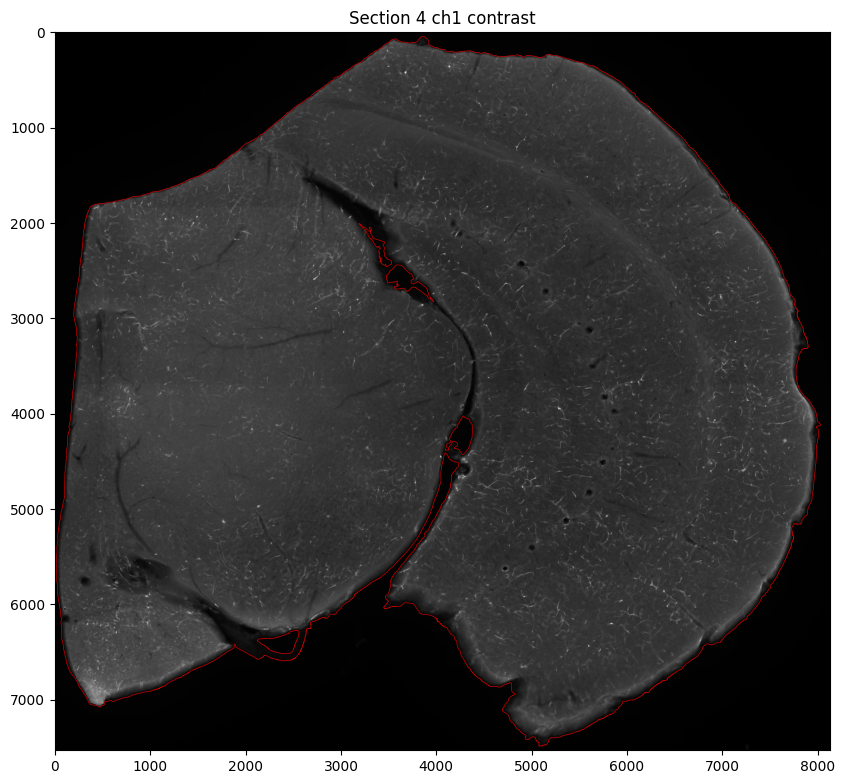

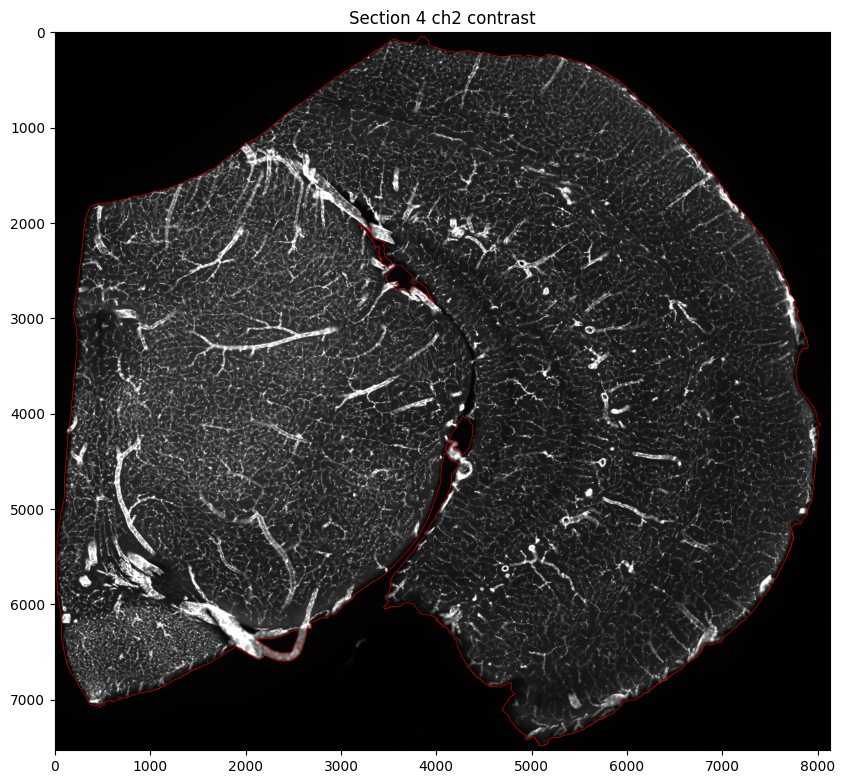

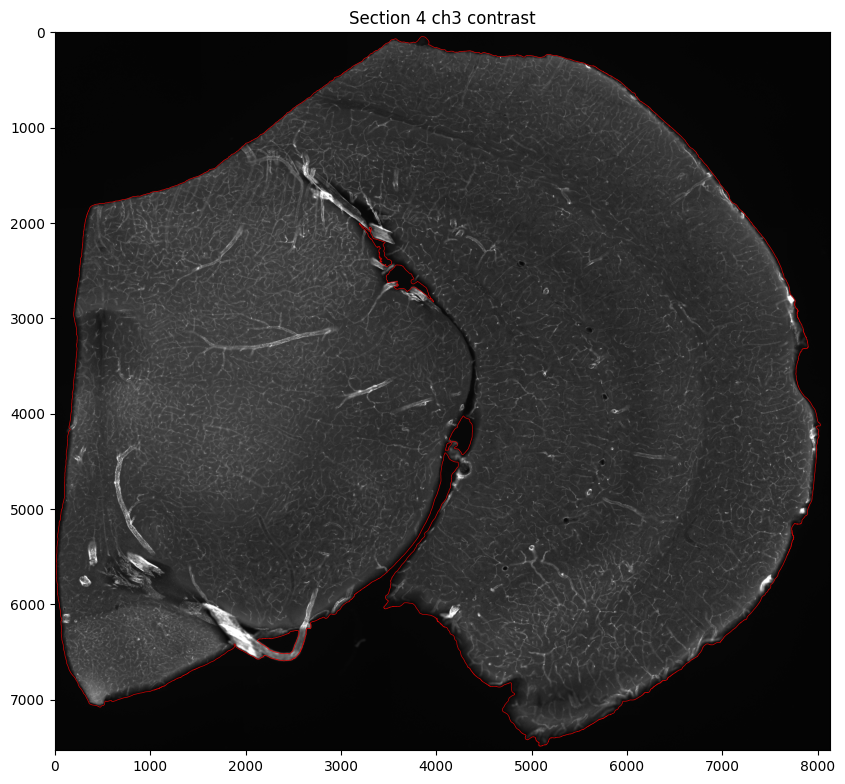

In [38]:
# Ch1 settings
gamma_ch1 = 2  # You can adjust this value to control the contrast enhancement
contrast_alpha_ch1 = 0.00525  # Try 0.0225 You can adjust this value to control the brightness enhancement 0.5 default

# Ch2 settings
gamma_ch2 = 2  # You can adjust this value to control the contrast enhancement
contrast_alpha_ch2 = 0.0125  # Try 0.125 You can adjust this value to control the brightness enhancement 0.5 default

# Ch3 settings
gamma_ch3 = 2  # You can adjust this value to control the contrast enhancement
contrast_alpha_ch3 = 0.0425  # Try 0.125 You can adjust this value to control the brightness enhancement 0.5 default


# No change
contrast_ch1 = curr_ch1
contrast_ch2 = curr_ch2
contrast_ch3 = curr_ch3


cc_ch1 = auto_contrast(contrast_ch1, alpha=contrast_alpha_ch1)
cc_ch2 = auto_contrast(contrast_ch2, alpha=contrast_alpha_ch2)
cc_ch3 = auto_contrast(contrast_ch3, alpha=contrast_alpha_ch3)


bg_alpha = 0.25  # 0.5
bg_mask = auto_contrast(curr_ch1, alpha=bg_alpha)  # 7
bg_mask = get_brain_mask(bg_mask, area_threshold=25000)  # 255 default ch0, 150 for ch1

show(cc_ch1, bg_mask, title=f"Section {IDX} ch1 contrast", axis=True)
show(cc_ch2, bg_mask, title=f"Section {IDX} ch2 contrast", axis=True)
show(cc_ch3, bg_mask, title=f"Section {IDX} ch3 contrast", axis=True)

In [39]:
# Setup FOVs
fovs = [ 
    # xlim,             ylim
    ( (4000, 5000),     (4000, 5000) ),
    ( (2000, 3000),     (2000, 4000) ),
    ( (2000, 4000),     (4000, 6000) ),
    ( (5000, 6000),     (2000, 4000) ),
    ( (5000, 6000),     (1000, 2000) ),
    ( (5000, 6000),     (4000, 5000) ),
]

fov1_xlim, fov1_ylim = fovs[0][0], fovs[0][1][::-1]
fov2_xlim, fov2_ylim = fovs[1][0], fovs[1][1][::-1]
fov3_xlim, fov3_ylim = fovs[2][0], fovs[2][1][::-1]
fov4_xlim, fov4_ylim = fovs[3][0], fovs[3][1][::-1]
fov5_xlim, fov5_ylim = fovs[4][0], fovs[4][1][::-1]
fov6_xlim, fov6_ylim = fovs[5][0], fovs[5][1][::-1]

## Threshold for CH1 and CH2

In [40]:
# Create a threshold mask for the image
curr_ch1_median = ndimage.median_filter(curr_ch1.copy(), size=5)
curr_ch2_median = ndimage.median_filter(curr_ch2.copy(), size=5)  # Repeat for ch2
curr_ch3_median = ndimage.median_filter(curr_ch3.copy(), size=5)  # Repeat for ch2

# Create auto contrast brightened images
auto_ch1 = auto_contrast(curr_ch1, alpha=contrast_alpha_ch1)
auto_ch2 = auto_contrast(curr_ch2, alpha=contrast_alpha_ch2)
auto_ch3 = auto_contrast(curr_ch3, alpha=contrast_alpha_ch3)
auto_ch1_median = ndimage.median_filter(auto_ch1.copy(), size=5) # 5
auto_ch2_median = ndimage.median_filter(auto_ch2.copy(), size=5)
auto_ch3_median = ndimage.median_filter(auto_ch3.copy(), size=5)

## Run thresholding for CH1

In [50]:
# Ch1 settings
gamma_ch1 = 2  # You can adjust this value to control the contrast enhancement
contrast_alpha_ch1 = 0.00525  # Try 0.0225 You can adjust this value to control the brightness enhancement 0.5 default

# Ch2 settings
gamma_ch2 = 2  # You can adjust this value to control the contrast enhancement
contrast_alpha_ch2 = 0.0125  # Try 0.125 You can adjust this value to control the brightness enhancement 0.5 default

# Ch3 settings
gamma_ch3 = 2  # You can adjust this value to control the contrast enhancement
contrast_alpha_ch3 = 0.0425  # Try 0.125 You can adjust this value to control the brightness enhancement 0.5 default


THRESH = 4000   # 4000 for all of channel 1
THRESH2 = 3000  # 3000 for all of channel 2
THRESH3 = None
max_value = 20000
max_value3 = 2000

beta1 = 0.5  # Use beta=0.5 for all of ch1
beta2 = 1.0  # Use beta=1.0 for all of ch2
beta3 = None # Swap between 0.5 and 1.0

# Index by index basis
if IDX == 0:
    THRESH = 7500
    
    THRESH3 = 400
    beta3 = 1.0
elif IDX == 1:
    THRESH = 5000
    
    THRESH3 = 750
    beta3 = 0.5
elif IDX == 2:
    THRESH = 5000  # 5000
    
    THRESH3 = 750
    beta3 = 0.5
elif IDX == 3:
    THRESH = 5500  # 5000
    
    THRESH3 = 750
    beta3 = 0.5
elif IDX == 4:
    THRESH = 7000
    
    THRESH2 = 4000 # Specific to this index
    
    THRESH3 = 1000
    beta3 = 0.5

Threshold for ch1: 7000
Threshold for ch2: 4000
Threshold for ch3: 1000


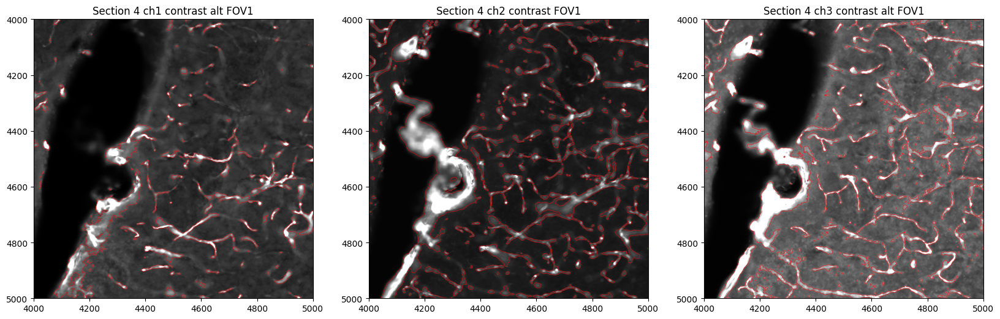

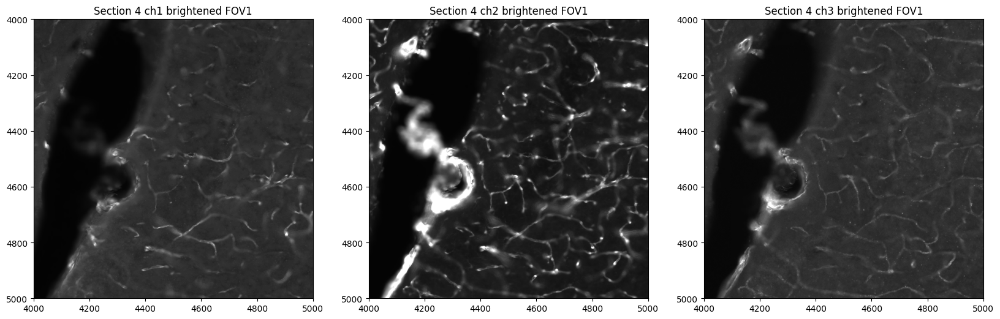

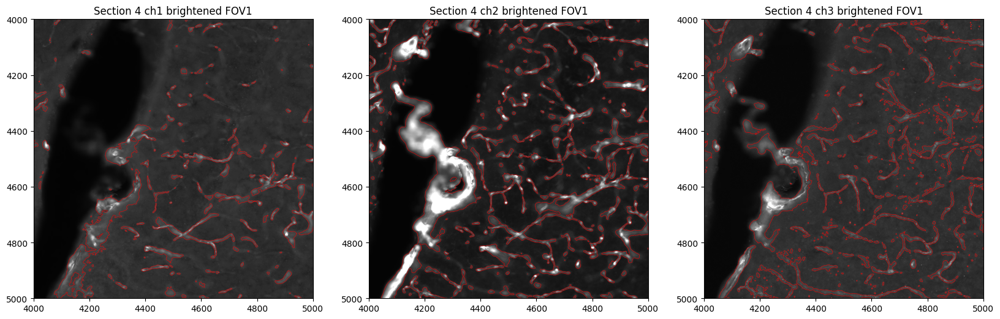

##########################################


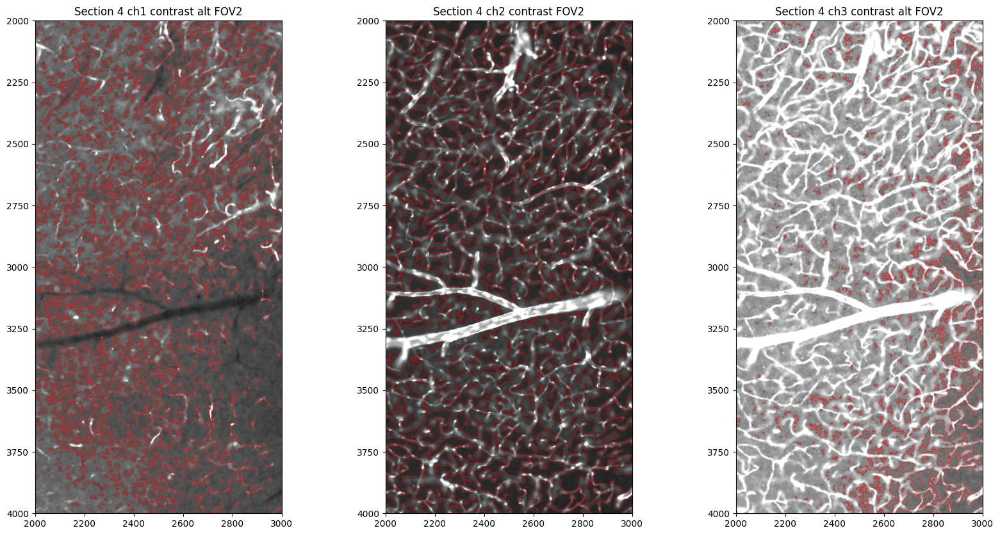

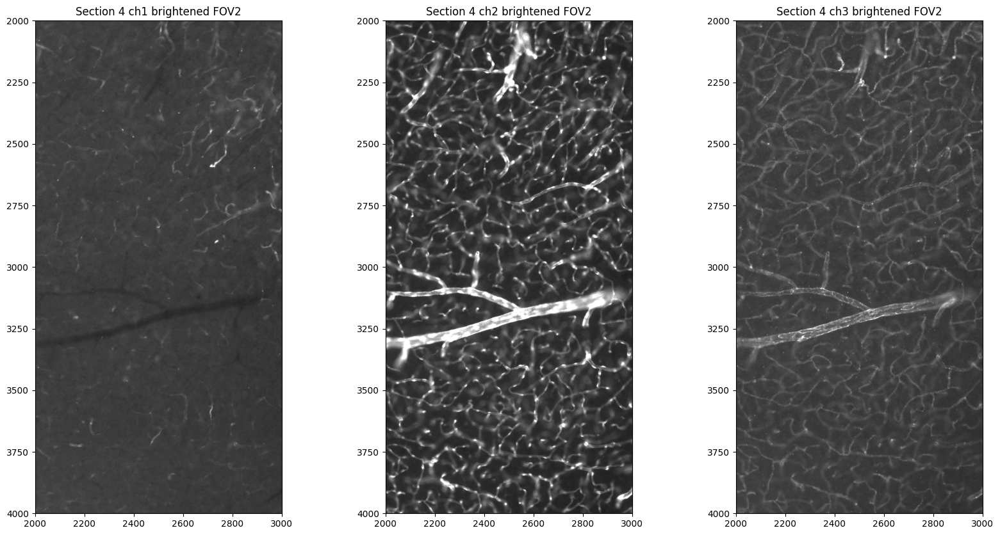

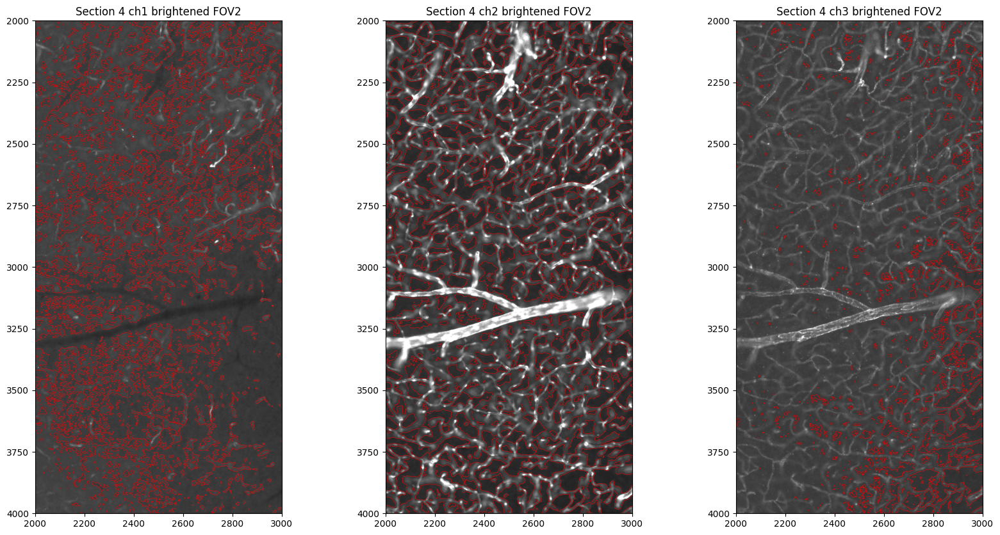

##########################################


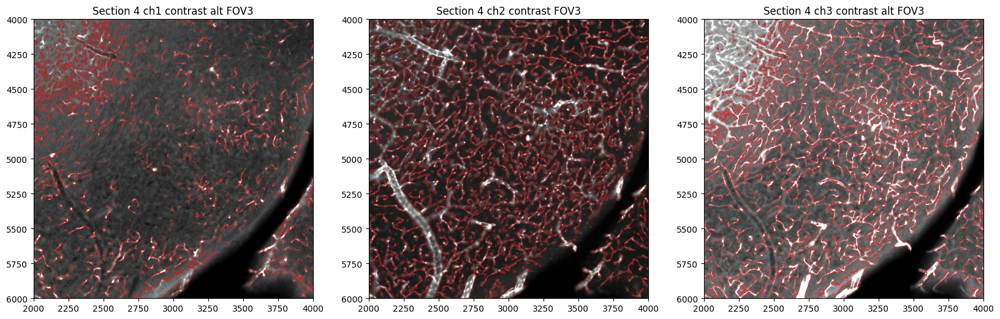

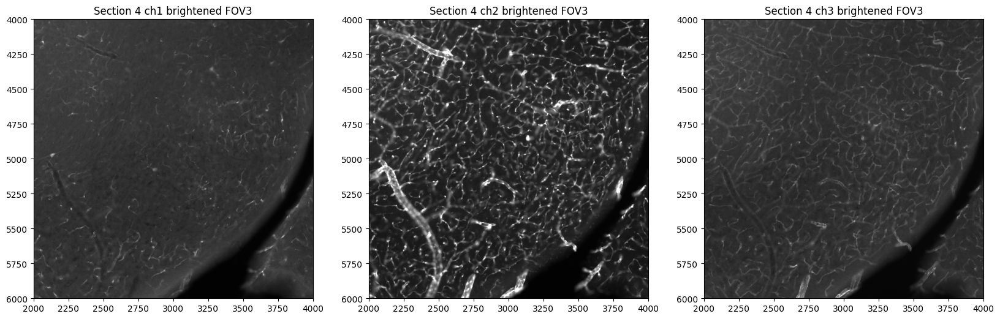

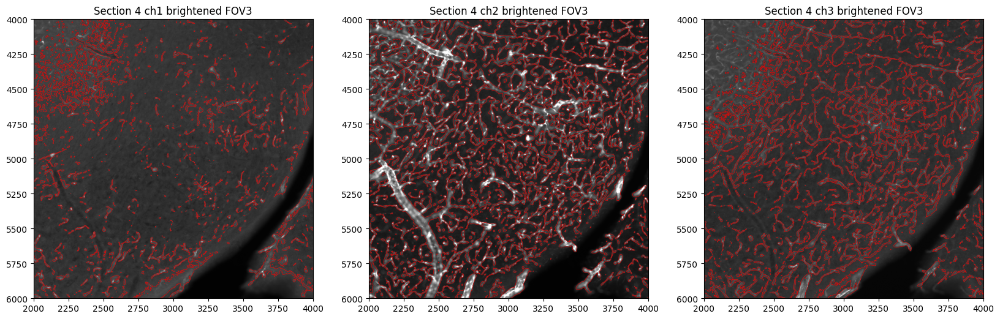

##########################################


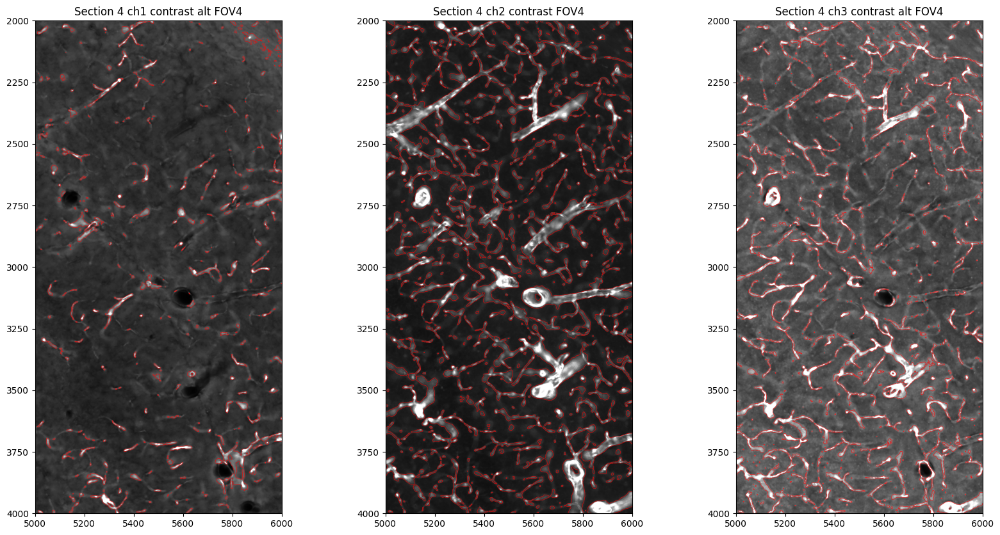

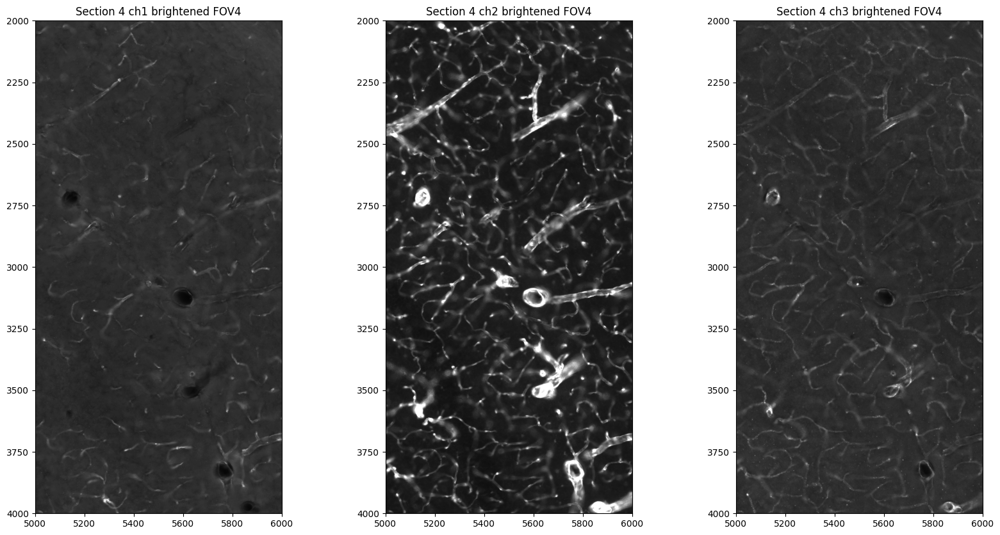

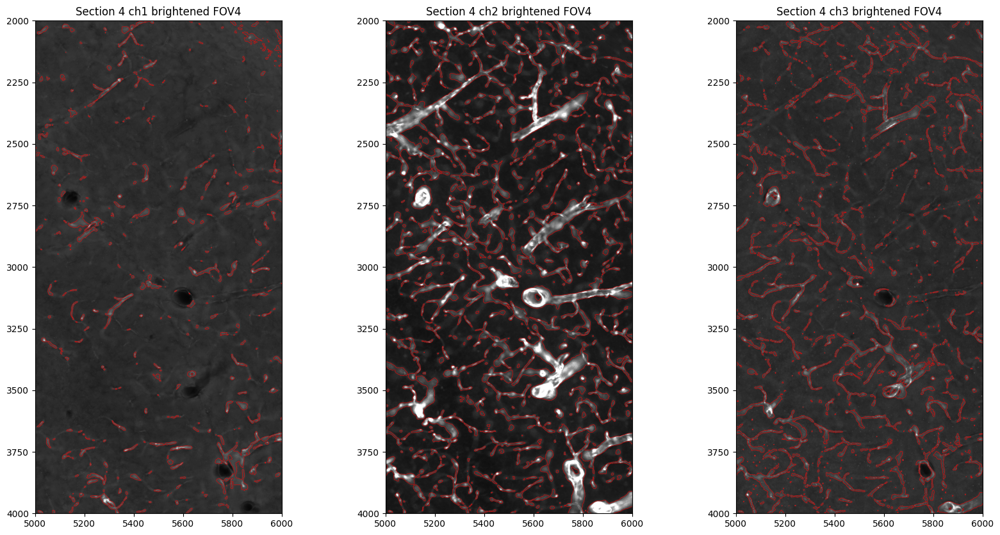

##########################################


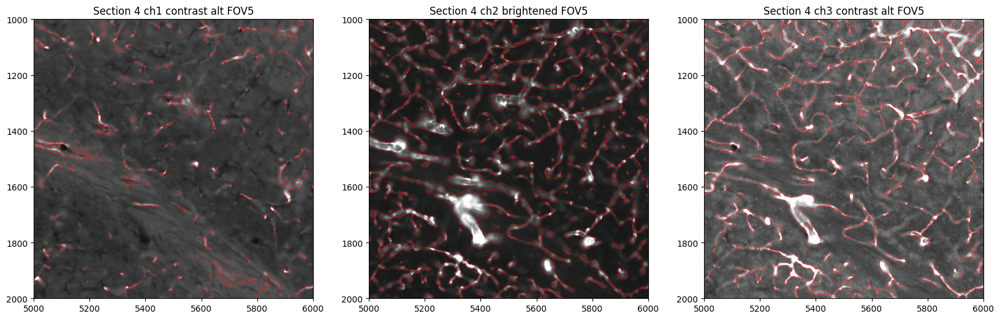

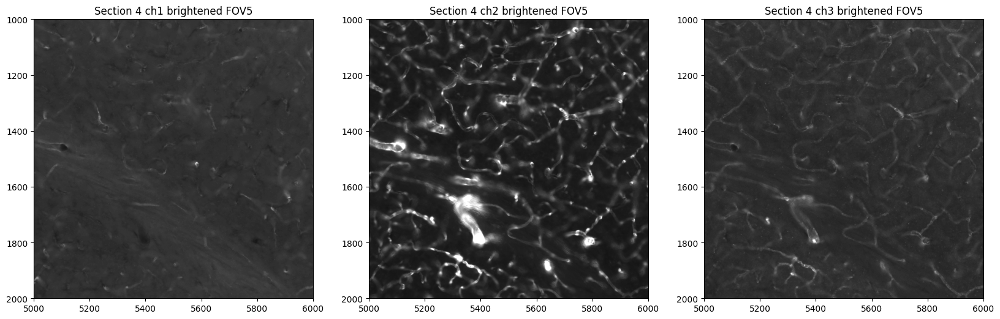

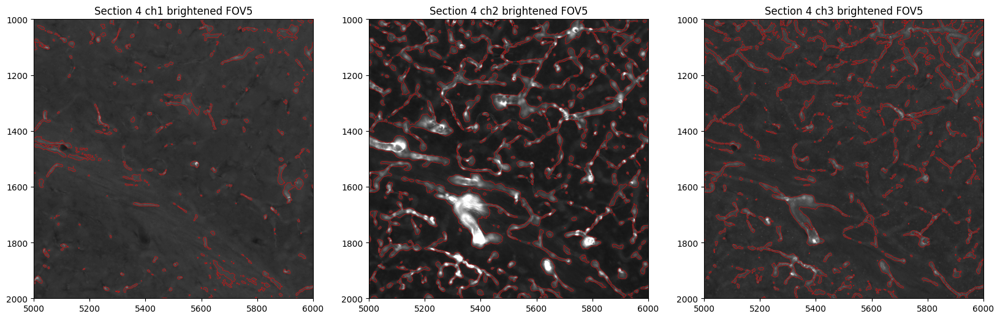

##########################################


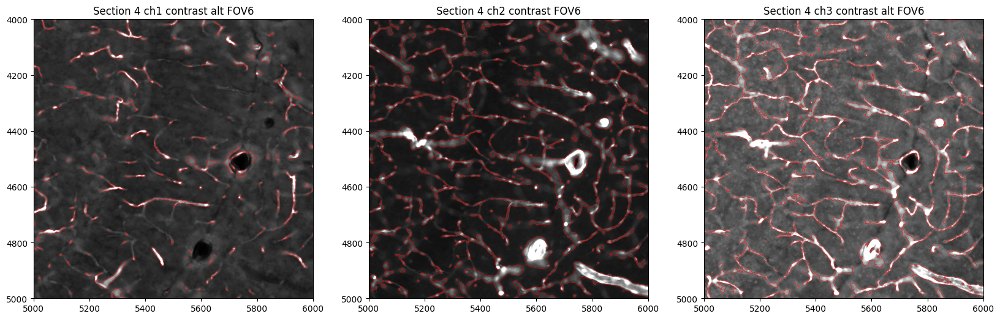

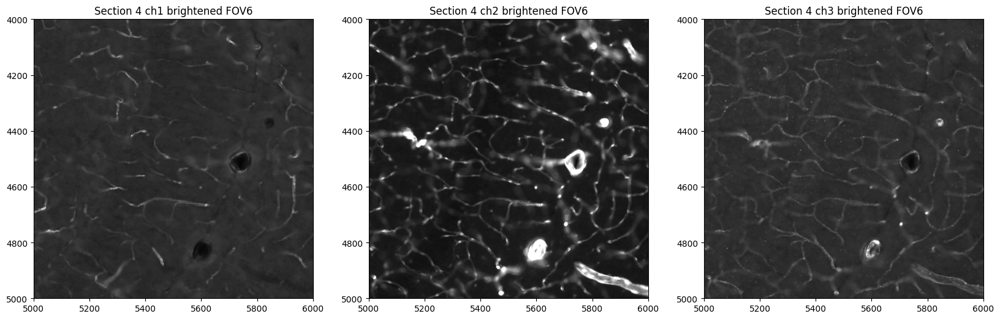

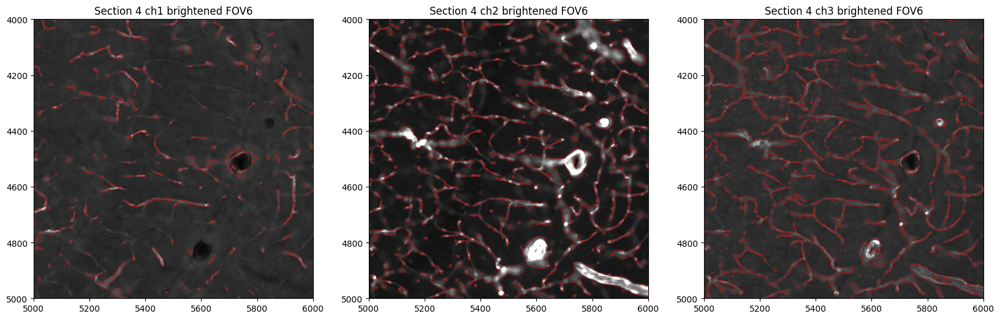

##########################################


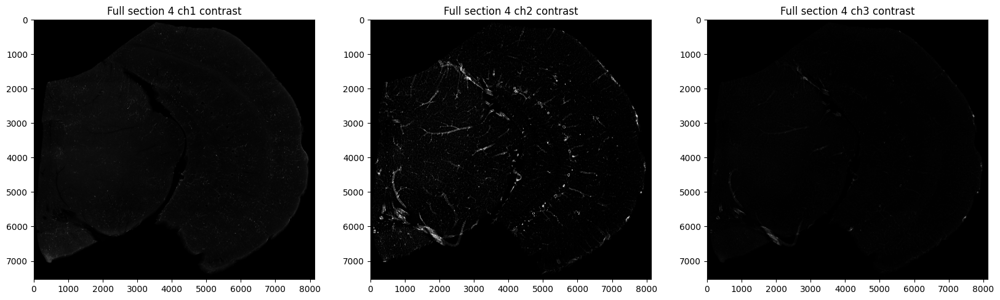

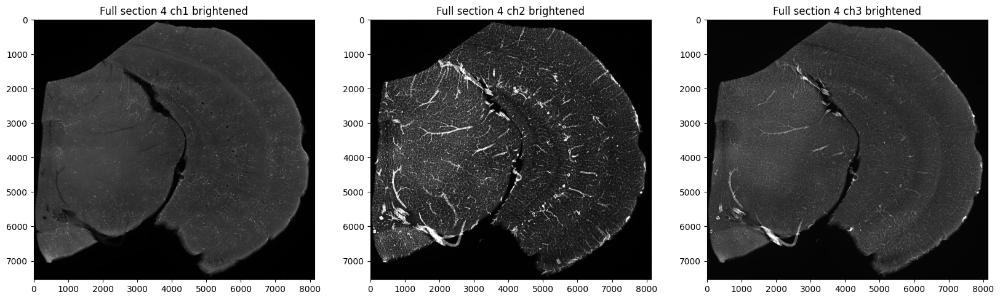

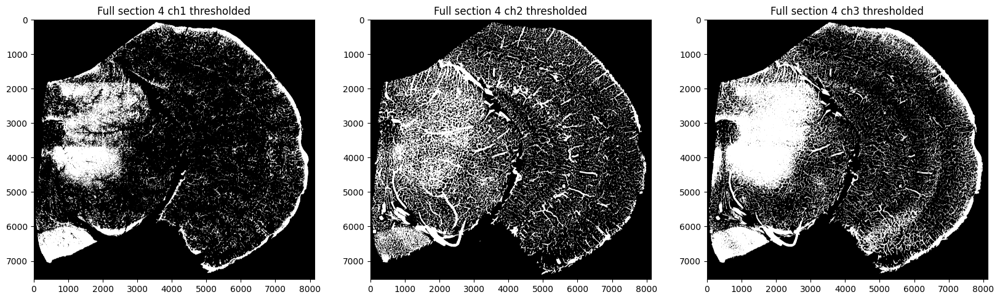

In [51]:
# Create contrast enhanced images
cc_ch1 = gamma_correction(curr_ch1, gamma=gamma_ch1)
cc_ch1 = auto_contrast(cc_ch1, alpha=contrast_alpha_ch1)
cc_ch1_alt = gamma_correction(curr_ch1_median, gamma=gamma_ch1, max_value=max_value)

cc_ch2 = gamma_correction(curr_ch2, gamma=gamma_ch2)
cc_ch2 = auto_contrast(cc_ch2, alpha=contrast_alpha_ch2)

cc_ch3 = gamma_correction(curr_ch3, gamma=gamma_ch3)
cc_ch3 = auto_contrast(cc_ch3, alpha=contrast_alpha_ch3)
cc_ch3_alt = gamma_correction(curr_ch3_median, gamma=gamma_ch3, max_value=max_value3)


print(f"Threshold for ch1: {THRESH}")
print(f"Threshold for ch2: {THRESH2}")
print(f"Threshold for ch3: {THRESH3}")


curr_ch1_thresh = cc_ch1_alt.copy() > THRESH
curr_ch1_thresh[curr_ch1_thresh != 0] = 1
curr_ch1_thresh = curr_ch1_thresh.astype(bool)

curr_ch2_thresh = curr_ch2_median.copy() > THRESH2
curr_ch2_thresh[curr_ch2_thresh != 0] = 1
curr_ch2_thresh = curr_ch2_thresh.astype(bool)

curr_ch3_thresh = cc_ch3_alt.copy() > THRESH3
curr_ch3_thresh[curr_ch3_thresh != 0] = 1
curr_ch3_thresh = curr_ch3_thresh.astype(bool)

##########################################
# FOV 1
##########################################

show3(image=cc_ch1_alt, title=f"Section {IDX} ch1 contrast alt FOV1", 
     xlim=fov1_xlim, ylim=fov1_ylim,
     contour=curr_ch1_thresh, 
     image2=auto_ch2, title2=f"Section {IDX} ch2 contrast FOV1", 
     contour2=curr_ch2_thresh, 
     xlim2=fov1_xlim, ylim2=fov1_ylim,
     image3=cc_ch3_alt, title3=f"Section {IDX} ch3 contrast alt FOV1", 
     contour3=curr_ch3_thresh, 
     xlim3=fov1_xlim, ylim3=fov1_ylim
     )

show3(image=auto_ch1, title=f"Section {IDX} ch1 brightened FOV1", 
     xlim=fov1_xlim, ylim=fov1_ylim,
     image2=auto_ch2, title2=f"Section {IDX} ch2 brightened FOV1", 
     xlim2=fov1_xlim, ylim2=fov1_ylim,
     image3=auto_ch3, title3=f"Section {IDX} ch3 brightened FOV1", 
     xlim3=fov1_xlim, ylim3=fov1_ylim
     )

show3(image=auto_ch1, title=f"Section {IDX} ch1 brightened FOV1", 
     contour=curr_ch1_thresh, 
     xlim=fov1_xlim, ylim=fov1_ylim,
     image2=auto_ch2, title2=f"Section {IDX} ch2 brightened FOV1", 
     contour2=curr_ch2_thresh, 
     xlim2=fov1_xlim, ylim2=fov1_ylim,
     image3=auto_ch3, title3=f"Section {IDX} ch3 brightened FOV1", 
     contour3=curr_ch3_thresh, 
     xlim3=fov1_xlim, ylim3=fov1_ylim
     )
print("##########################################")

##########################################
# FOV 2
##########################################

"""
show(image=cc_ch1, title=f"Section {IDX} ch1 contrast FOV2", 
     contour=curr_ch1_thresh, 
     xlim=fov2_xlim, ylim=fov2_ylim,
     image2=cc_ch2, title2=f"Section {IDX} ch2 contrast FOV2", 
     contour2=curr_ch2_thresh, 
     xlim2=fov2_xlim, ylim2=fov2_ylim)
"""

show3(image=cc_ch1_alt, title=f"Section {IDX} ch1 contrast alt FOV2", 
     contour=curr_ch1_thresh, 
     xlim=fov2_xlim, ylim=fov2_ylim,
     image2=auto_ch2, title2=f"Section {IDX} ch2 contrast FOV2", 
     contour2=curr_ch2_thresh, 
     xlim2=fov2_xlim, ylim2=fov2_ylim,
     image3=cc_ch3_alt, title3=f"Section {IDX} ch3 contrast alt FOV2", 
     contour3=curr_ch3_thresh, 
     xlim3=fov2_xlim, ylim3=fov2_ylim
     )

show3(image=auto_ch1, title=f"Section {IDX} ch1 brightened FOV2", 
     xlim=fov2_xlim, ylim=fov2_ylim,
     image2=auto_ch2, title2=f"Section {IDX} ch2 brightened FOV2", 
     xlim2=fov2_xlim, ylim2=fov2_ylim,
     image3=auto_ch3, title3=f"Section {IDX} ch3 brightened FOV2", 
     xlim3=fov2_xlim, ylim3=fov2_ylim
     )

show3(image=auto_ch1, title=f"Section {IDX} ch1 brightened FOV2", 
     contour=curr_ch1_thresh, 
     xlim=fov2_xlim, ylim=fov2_ylim,
     image2=auto_ch2, title2=f"Section {IDX} ch2 brightened FOV2", 
     contour2=curr_ch2_thresh, 
     xlim2=fov2_xlim, ylim2=fov2_ylim,
     image3=auto_ch3, title3=f"Section {IDX} ch3 brightened FOV2", 
     contour3=curr_ch3_thresh, 
     xlim3=fov2_xlim, ylim3=fov2_ylim
     )
print("##########################################")

##########################################
# FOV 3
##########################################

show3(image=cc_ch1_alt, title=f"Section {IDX} ch1 contrast alt FOV3", 
     contour=curr_ch1_thresh, 
     xlim=fov3_xlim, ylim=fov3_ylim,
     image2=auto_ch2, title2=f"Section {IDX} ch2 contrast FOV3", 
     contour2=curr_ch2_thresh, 
     xlim2=fov3_xlim, ylim2=fov3_ylim,
     image3=cc_ch3_alt, title3=f"Section {IDX} ch3 contrast alt FOV3", 
     contour3=curr_ch3_thresh, 
     xlim3=fov3_xlim, ylim3=fov3_ylim
     )

show3(image=auto_ch1, title=f"Section {IDX} ch1 brightened FOV3",
     xlim=fov3_xlim, ylim=fov3_ylim,
     image2=auto_ch2, title2=f"Section {IDX} ch2 brightened FOV3", 
     xlim2=fov3_xlim, ylim2=fov3_ylim,
     image3=auto_ch3, title3=f"Section {IDX} ch3 brightened FOV3", 
     xlim3=fov3_xlim, ylim3=fov3_ylim
     )

show3(image=auto_ch1, title=f"Section {IDX} ch1 brightened FOV3", 
     contour=curr_ch1_thresh,
     xlim=fov3_xlim, ylim=fov3_ylim,
     image2=auto_ch2, title2=f"Section {IDX} ch2 brightened FOV3", 
     contour2=curr_ch2_thresh, 
     xlim2=fov3_xlim, ylim2=fov3_ylim,
     image3=auto_ch3, title3=f"Section {IDX} ch3 brightened FOV3", 
     contour3=curr_ch3_thresh, 
     xlim3=fov3_xlim, ylim3=fov3_ylim
     )
print("##########################################")

##########################################
# FOV 4
##########################################

show3(image=cc_ch1_alt, title=f"Section {IDX} ch1 contrast alt FOV4", 
     contour=curr_ch1_thresh, 
     xlim=fov4_xlim, ylim=fov4_ylim,
     image2=auto_ch2, title2=f"Section {IDX} ch2 contrast FOV4", 
     contour2=curr_ch2_thresh, 
     xlim2=fov4_xlim, ylim2=fov4_ylim,
     image3=cc_ch3_alt, title3=f"Section {IDX} ch3 contrast alt FOV4", 
     contour3=curr_ch3_thresh, 
     xlim3=fov4_xlim, ylim3=fov4_ylim
     )

show3(image=auto_ch1, title=f"Section {IDX} ch1 brightened FOV4",
     xlim=fov4_xlim, ylim=fov4_ylim,
     image2=auto_ch2, title2=f"Section {IDX} ch2 brightened FOV4", 
     xlim2=fov4_xlim, ylim2=fov4_ylim,
     image3=auto_ch3, title3=f"Section {IDX} ch3 brightened FOV4", 
     xlim3=fov4_xlim, ylim3=fov4_ylim
     )

show3(image=auto_ch1, title=f"Section {IDX} ch1 brightened FOV4", 
     contour=curr_ch1_thresh,
     xlim=fov4_xlim, ylim=fov4_ylim,
     image2=auto_ch2, title2=f"Section {IDX} ch2 brightened FOV4", 
     contour2=curr_ch2_thresh, 
     xlim2=fov4_xlim, ylim2=fov4_ylim,
     image3=auto_ch3, title3=f"Section {IDX} ch3 brightened FOV4", 
     contour3=curr_ch3_thresh, 
     xlim3=fov4_xlim, ylim3=fov4_ylim
     )

print("##########################################")

##########################################
# FOV 5
##########################################

show3(image=cc_ch1_alt, title=f"Section {IDX} ch1 contrast alt FOV5", 
     contour=curr_ch1_thresh, 
     xlim=fov5_xlim, ylim=fov5_ylim,
     image2=auto_ch2, title2=f"Section {IDX} ch2 brightened FOV5", 
     contour2=curr_ch2_thresh, 
     xlim2=fov5_xlim, ylim2=fov5_ylim,
     image3=cc_ch3_alt, title3=f"Section {IDX} ch3 contrast alt FOV5", 
     contour3=curr_ch3_thresh, 
     xlim3=fov5_xlim, ylim3=fov5_ylim
     )

show3(image=auto_ch1, title=f"Section {IDX} ch1 brightened FOV5",
     xlim=fov5_xlim, ylim=fov5_ylim,
     image2=auto_ch2, title2=f"Section {IDX} ch2 brightened FOV5", 
     xlim2=fov5_xlim, ylim2=fov5_ylim,
     image3=auto_ch3, title3=f"Section {IDX} ch3 brightened FOV5", 
     xlim3=fov5_xlim, ylim3=fov5_ylim
     )

show3(image=auto_ch1, title=f"Section {IDX} ch1 brightened FOV5", 
     contour=curr_ch1_thresh,
     xlim=fov5_xlim, ylim=fov5_ylim,
     image2=auto_ch2, title2=f"Section {IDX} ch2 brightened FOV5", 
     contour2=curr_ch2_thresh, 
     xlim2=fov5_xlim, ylim2=fov5_ylim,
     image3=auto_ch3, title3=f"Section {IDX} ch3 brightened FOV5", 
     contour3=curr_ch3_thresh, 
     xlim3=fov5_xlim, ylim3=fov5_ylim
     )

print("##########################################")

##########################################
# FOV 6
##########################################

show3(image=cc_ch1_alt, title=f"Section {IDX} ch1 contrast alt FOV6", 
     contour=curr_ch1_thresh, 
     xlim=fov6_xlim, ylim=fov6_ylim,
     image2=auto_ch2, title2=f"Section {IDX} ch2 contrast FOV6", 
     contour2=curr_ch2_thresh, 
     xlim2=fov6_xlim, ylim2=fov6_ylim,
     image3=cc_ch3_alt, title3=f"Section {IDX} ch3 contrast alt FOV6", 
     contour3=curr_ch3_thresh, 
     xlim3=fov6_xlim, ylim3=fov6_ylim
     )

show3(image=auto_ch1, title=f"Section {IDX} ch1 brightened FOV6",
     xlim=fov6_xlim, ylim=fov6_ylim,
     image2=auto_ch2, title2=f"Section {IDX} ch2 brightened FOV6", 
     xlim2=fov6_xlim, ylim2=fov6_ylim,
     image3=auto_ch3, title3=f"Section {IDX} ch3 brightened FOV6", 
     xlim3=fov6_xlim, ylim3=fov6_ylim
     )

show3(image=auto_ch1, title=f"Section {IDX} ch1 brightened FOV6", 
     contour=curr_ch1_thresh,
     xlim=fov6_xlim, ylim=fov6_ylim,
     image2=auto_ch2, title2=f"Section {IDX} ch2 brightened FOV6", 
     contour2=curr_ch2_thresh, 
     xlim2=fov6_xlim, ylim2=fov6_ylim,
     image3=auto_ch3, title3=f"Section {IDX} ch3 brightened FOV6", 
     contour3=curr_ch3_thresh, 
     xlim3=fov6_xlim, ylim3=fov6_ylim
     )     

print("##########################################")

##########################################################
# FULL SECTION
##########################################################

show3(image=cc_ch1, title=f"Full section {IDX} ch1 contrast", 
      image2=cc_ch2, title2=f"Full section {IDX} ch2 contrast",
      image3=cc_ch3, title3=f"Full section {IDX} ch3 contrast",
      figsize=(20, 10), axis=True)

show3(image=auto_ch1, title=f"Full section {IDX} ch1 brightened", 
      image2=auto_ch2, title2=f"Full section {IDX} ch2 brightened",
      image3=auto_ch3, title3=f"Full section {IDX} ch3 brightened",
      figsize=(20, 10), axis=True)

show3(image=curr_ch1_thresh, title=f"Full section {IDX} ch1 thresholded", 
      image2=curr_ch2_thresh, title2=f"Full section {IDX} ch2 thresholded",
      image3=curr_ch3_thresh, title3=f"Full section {IDX} ch3 thresholded",
      figsize=(20, 10), axis=True)

#thresholded_vessels_ch1 = curr_ch1_thresh
#thresholded_vessels_ch2 = curr_ch2_thresh

## Hessian Filter
https://examples.itk.org/src/nonunit/review/segmentbloodvesselswithmultiscalehessianbasedmeasure/documentation

# CHANNEL 1

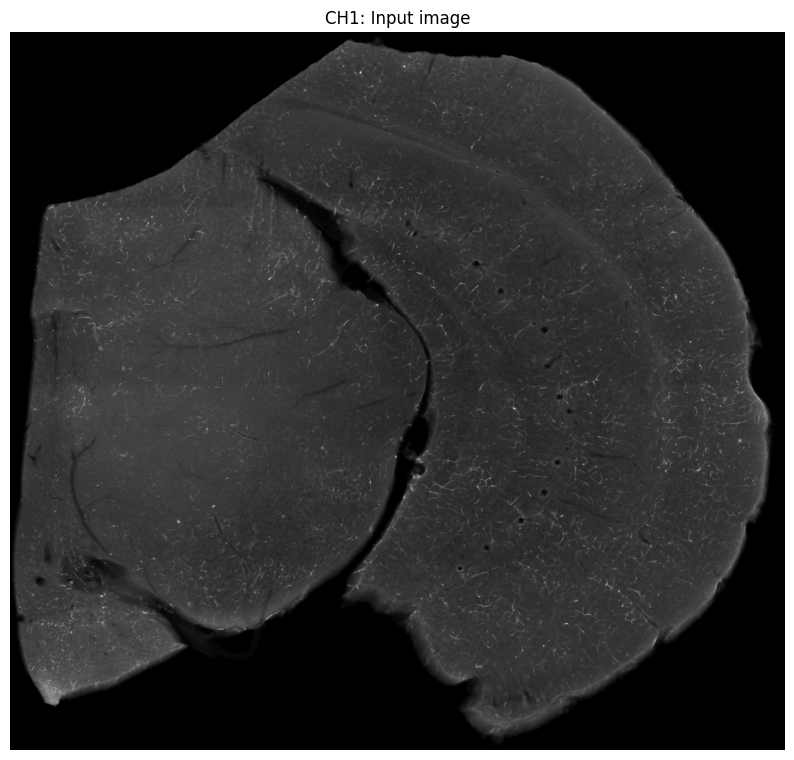

Input image type: float32
Input image min: 0.0
Input image max: 65025.0
Vesselness image statistics:
Shape: (7530, 8128)
Min: 0.0
Max: 255.0
Mean: 136.51506
Median: 198.0
CHANNEL 1


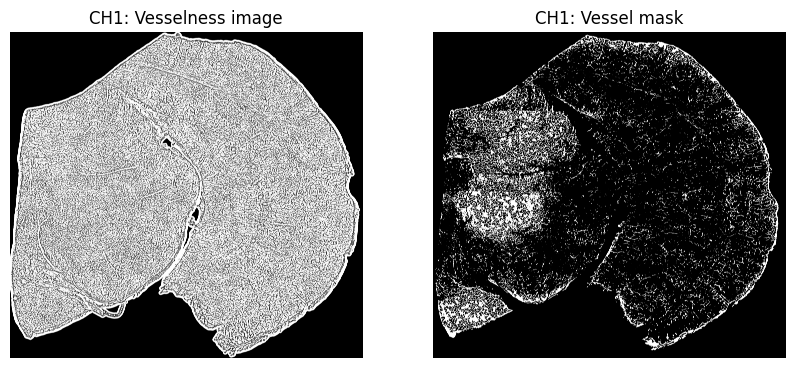

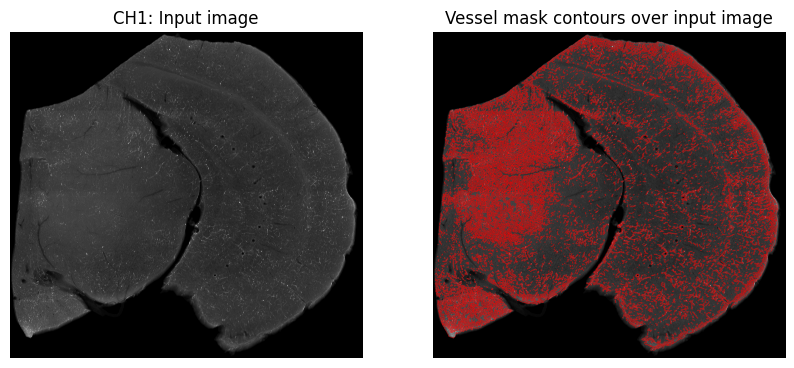

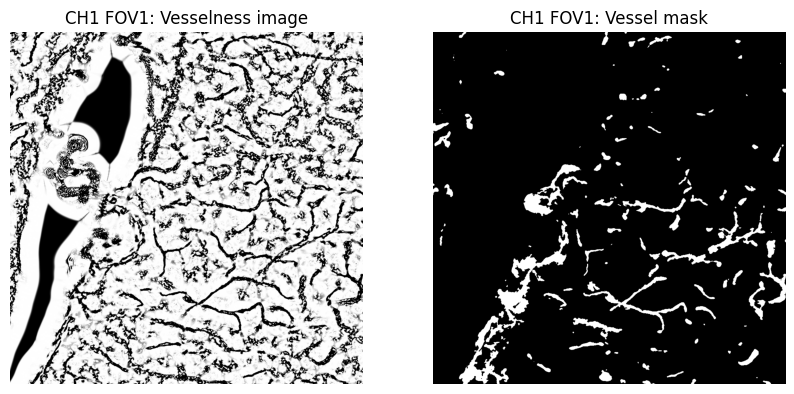

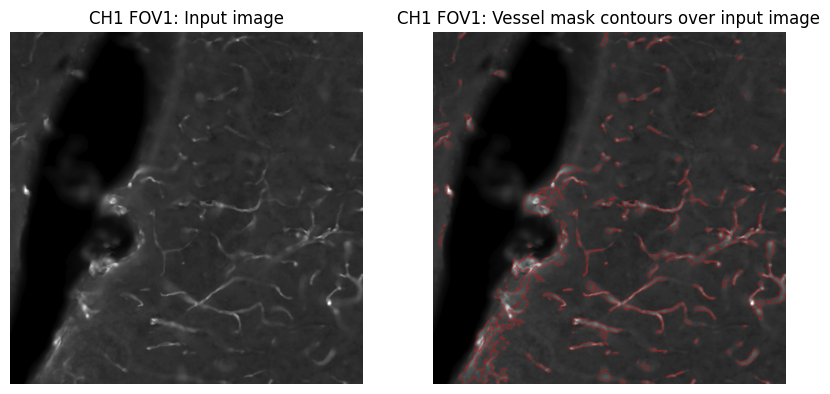

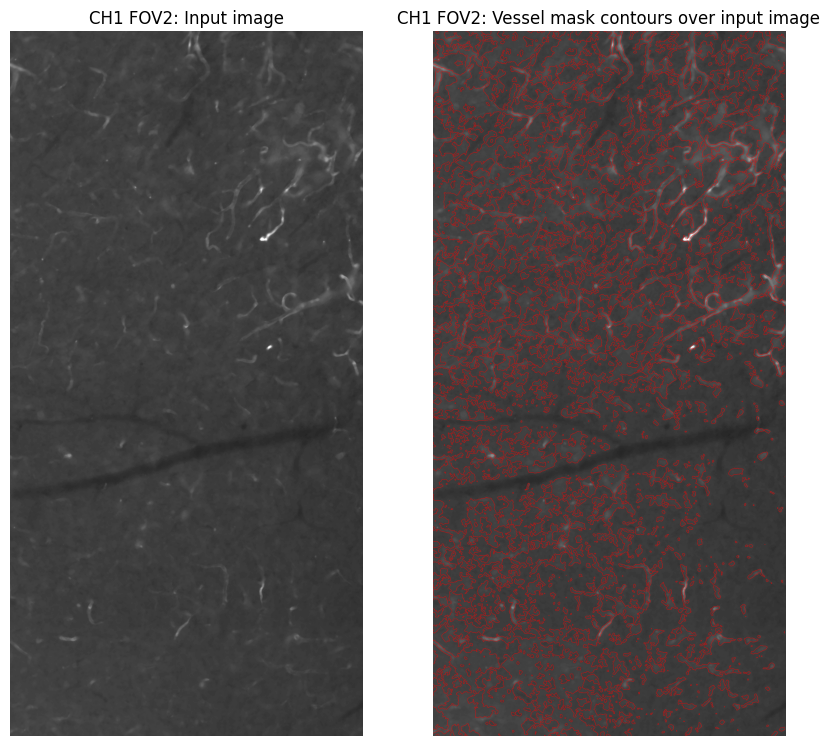

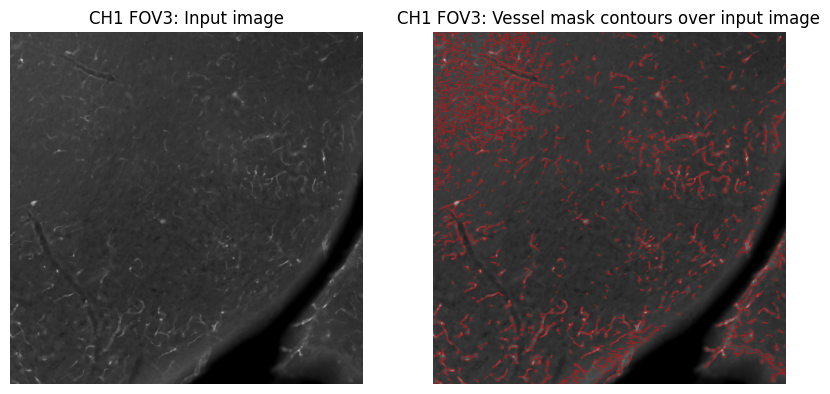

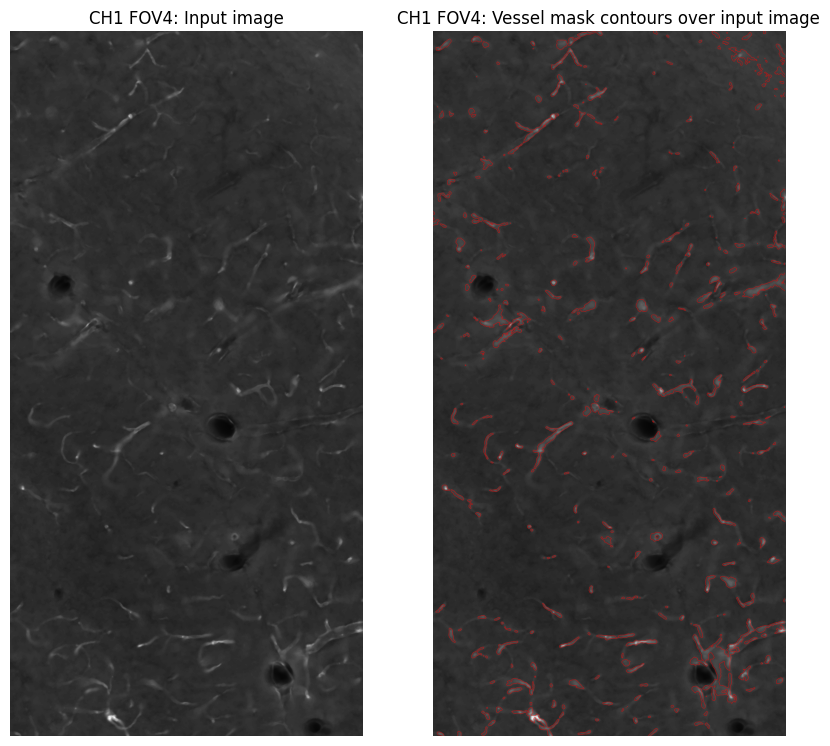

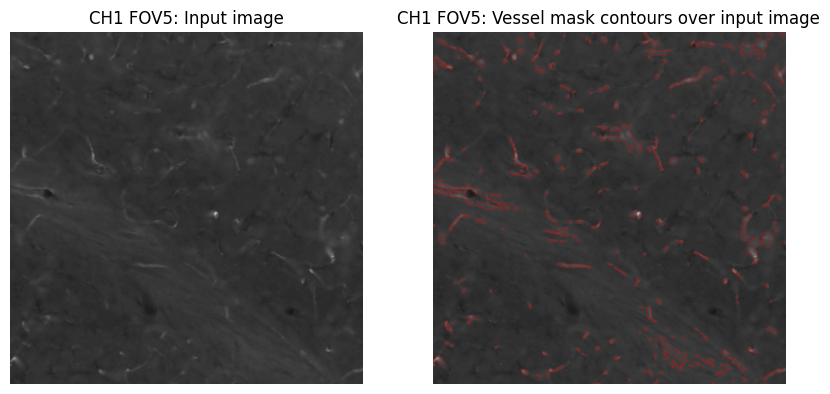

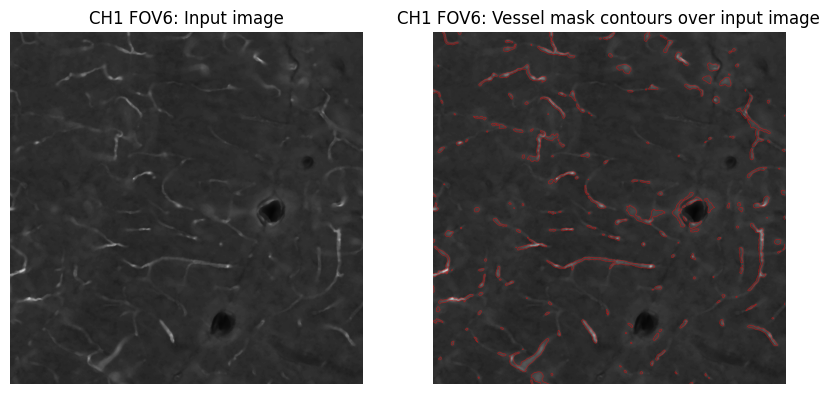

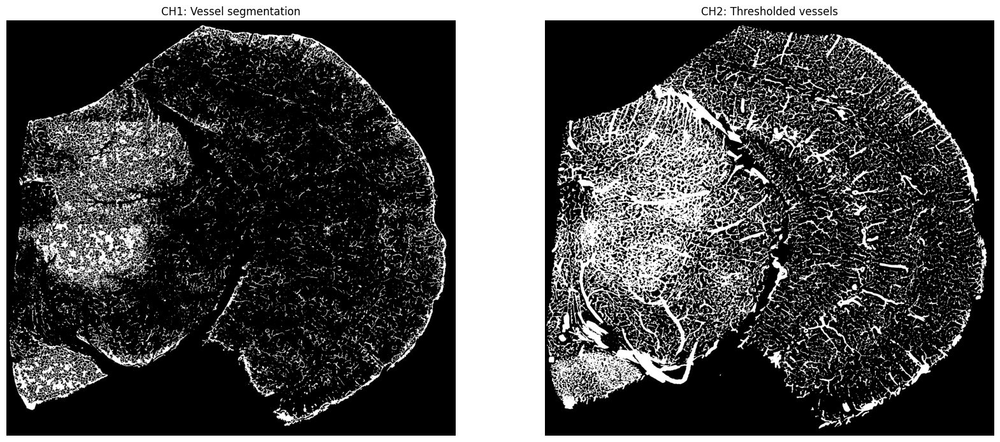

In [52]:
# Parameters for vessel detection
sigma_minimum = 1.0  # Range of scales in which MultiScaleHessianBasedMeasureImageFilter will search for vessels
sigma_maximum = 10.0  # 10
number_of_sigma_steps = 10  # 10 Number of scales to search for vessels

# Parameters for post-processing
thresh = 230  # Threshold for binarization, 230 and 25 and 15
min_size = 100  # Minimum size of objects to keep 100
area_threshold = 2000 # Minimum area of holes to keep
smoothing = 1  # Smoothing factor for closing, 3

#############################################################

# Alternative: load image in memory
input_image = auto_ch1_median * bg_mask
#input_image = cc_ch1_alt * bg_mask
input_image = input_image.astype(np.float32)
input_image *= 255.0

show(input_image, title="CH1: Input image", axis=False)

# Print statistics
print("Input image type:", input_image.dtype)
print("Input image min:", input_image.min())
print("Input image max:", input_image.max())

# Run the vessel detection
segmented_vessels_array = detect_vessels(input_image, sigma_minimum, sigma_maximum, number_of_sigma_steps,
                                         beta=beta1)

# Process the thresholded vessels
thresholded_vessels_ch1 = process_vessels(segmented_vessels_array, thresh=thresh, min_size=min_size, area_threshold=area_threshold, smoothing=smoothing)
thresholded_vessels_ch1 = thresholded_vessels_ch1 * bg_mask * curr_ch1_thresh

# Print statistics
print("Vesselness image statistics:")
print("Shape:", segmented_vessels_array.shape)
print("Min:", segmented_vessels_array.min())
print("Max:", segmented_vessels_array.max())
print("Mean:", segmented_vessels_array.mean())
print("Median:", np.median(segmented_vessels_array))
#print("Std:", segmented_vessels_array.std())

print("CHANNEL 1")

# Plot the raw vesselness image
show(image=segmented_vessels_array, title=f"CH1: Vesselness image",
     image2=thresholded_vessels_ch1, title2=f"CH1: Vessel mask",
     axis=False)

# Show the results
show(image=input_image, title="CH1: Input image",
     image2=input_image, title2="Vessel mask contours over input image",
     contour2=thresholded_vessels_ch1, contour_alpha=0.45,
     axis=False)

# Plot the raw vesselness image FOV1
show(image=segmented_vessels_array, title=f"CH1 FOV1: Vesselness image",
     image2=thresholded_vessels_ch1, title2=f"CH1 FOV1: Vessel mask",
     xlim=fov1_xlim, ylim=fov1_ylim, xlim2=fov1_xlim, ylim2=fov1_ylim,
     axis=False)


# FOV1
show(image=input_image, title="CH1 FOV1: Input image",
     image2=input_image, title2="CH1 FOV1: Vessel mask contours over input image",
     contour2=thresholded_vessels_ch1, contour_alpha=0.45,
     xlim=fov1_xlim, ylim=fov1_ylim, xlim2=fov1_xlim, ylim2=fov1_ylim,
     axis=False)

# FOV2
show(image=input_image, title="CH1 FOV2: Input image",
     image2=input_image, title2="CH1 FOV2: Vessel mask contours over input image",
     contour2=thresholded_vessels_ch1, contour_alpha=0.45,
     xlim=fov2_xlim, ylim=fov2_ylim, xlim2=fov2_xlim, ylim2=fov2_ylim,
     axis=False)

# FOV3
show(image=input_image, title="CH1 FOV3: Input image",
     image2=input_image, title2="CH1 FOV3: Vessel mask contours over input image",
     contour2=thresholded_vessels_ch1, contour_alpha=0.45,
     xlim=fov3_xlim, ylim=fov3_ylim, xlim2=fov3_xlim, ylim2=fov3_ylim,
     axis=False)

# FOV4
show(image=input_image, title="CH1 FOV4: Input image",
     image2=input_image, title2="CH1 FOV4: Vessel mask contours over input image",
     contour2=thresholded_vessels_ch1, contour_alpha=0.45,
     xlim=fov4_xlim, ylim=fov4_ylim, xlim2=fov4_xlim, ylim2=fov4_ylim,
     axis=False)

# FOV5
show(image=input_image, title="CH1 FOV5: Input image",
     image2=input_image, title2="CH1 FOV5: Vessel mask contours over input image",
     contour2=thresholded_vessels_ch1, contour_alpha=0.45,
     xlim=fov5_xlim, ylim=fov5_ylim, xlim2=fov5_xlim, ylim2=fov5_ylim,
     axis=False)

# FOV6
show(image=input_image, title="CH1 FOV6: Input image",
     image2=input_image, title2="CH1 FOV6: Vessel mask contours over input image",
     contour2=thresholded_vessels_ch1, contour_alpha=0.45,
     xlim=fov6_xlim, ylim=fov6_ylim, xlim2=fov6_xlim, ylim2=fov6_ylim,
     axis=False)

# Full section
show(image=thresholded_vessels_ch1, title="CH1: Vessel segmentation",
     image2=curr_ch2_thresh, title2="CH2: Thresholded vessels",
     figsize=(20, 10), axis=False)

# CHANNEL 2

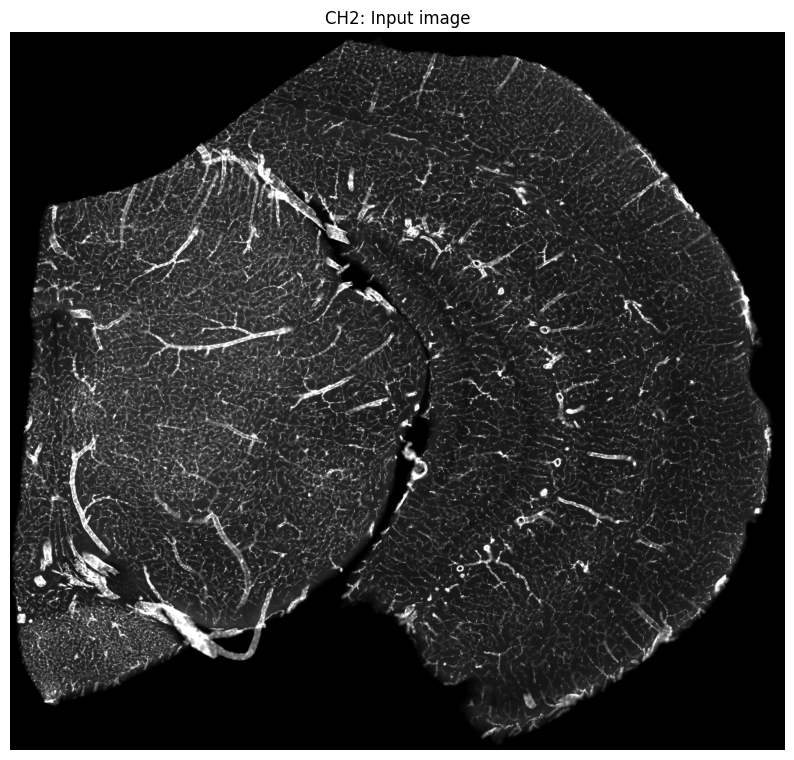

Input image type: float32
Input image min: 0.0
Input image max: 65025.0
Vesselness image statistics:
Shape: (7530, 8128)
Min: 0.0
Max: 255.0
Mean: 150.17982
Median: 246.0
CHANNEL 2


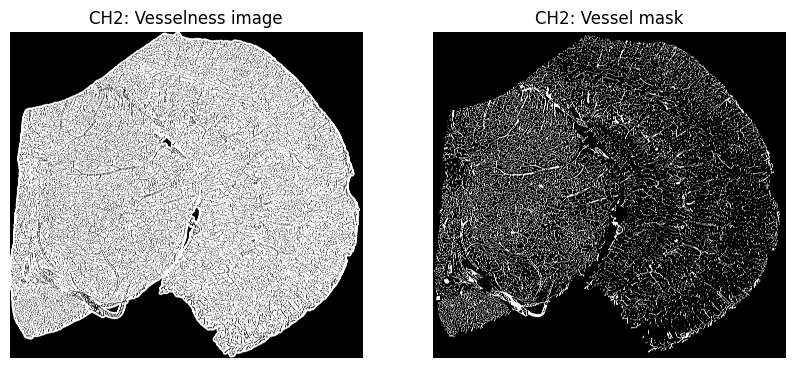

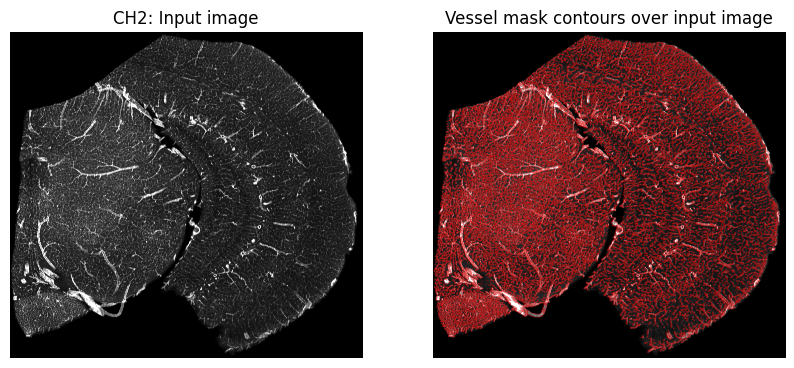

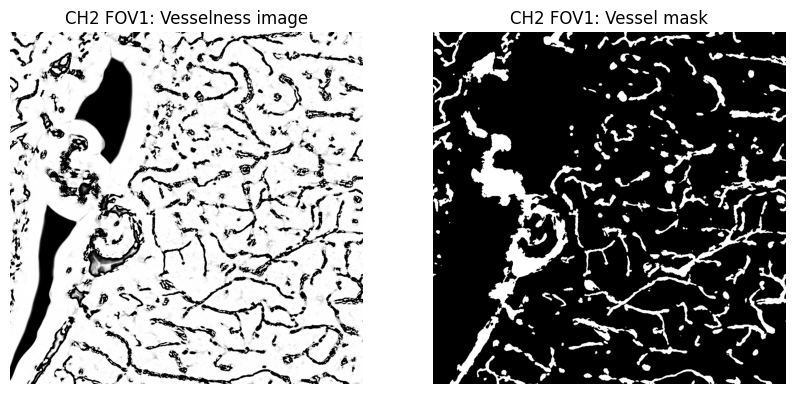

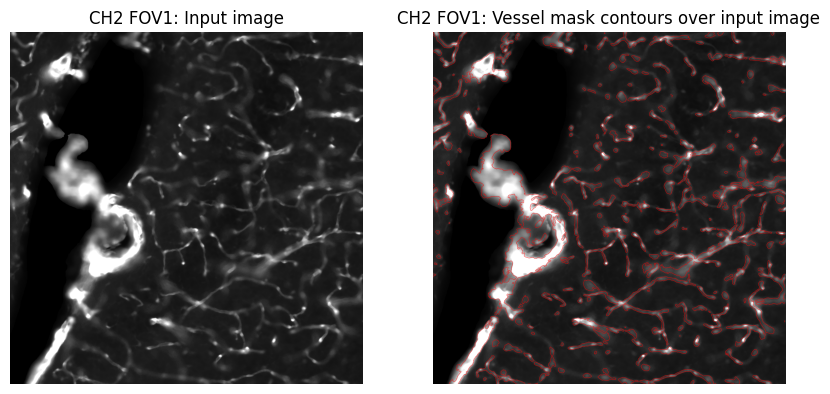

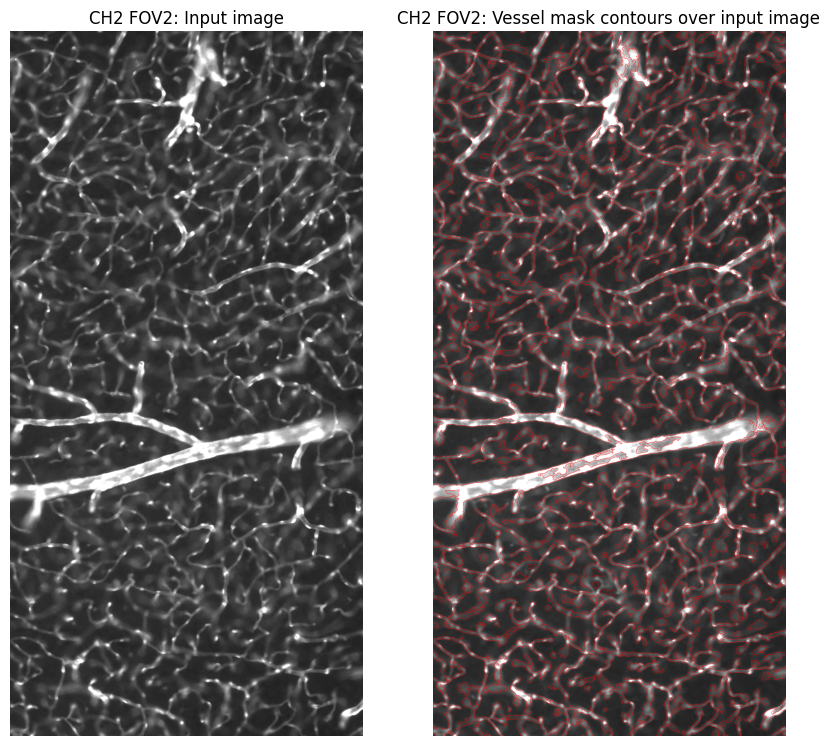

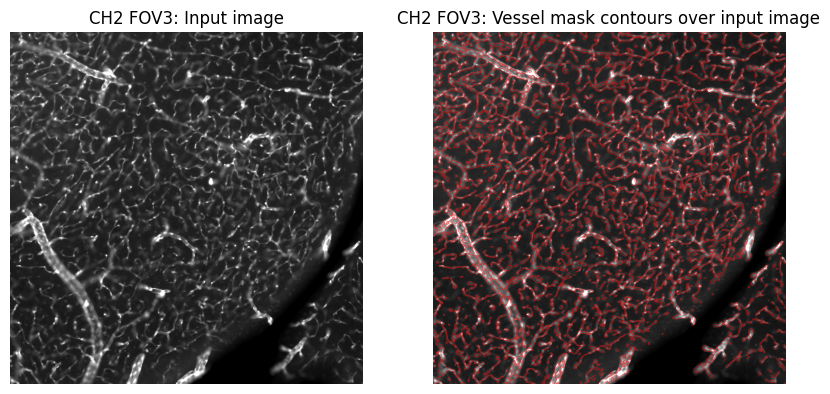

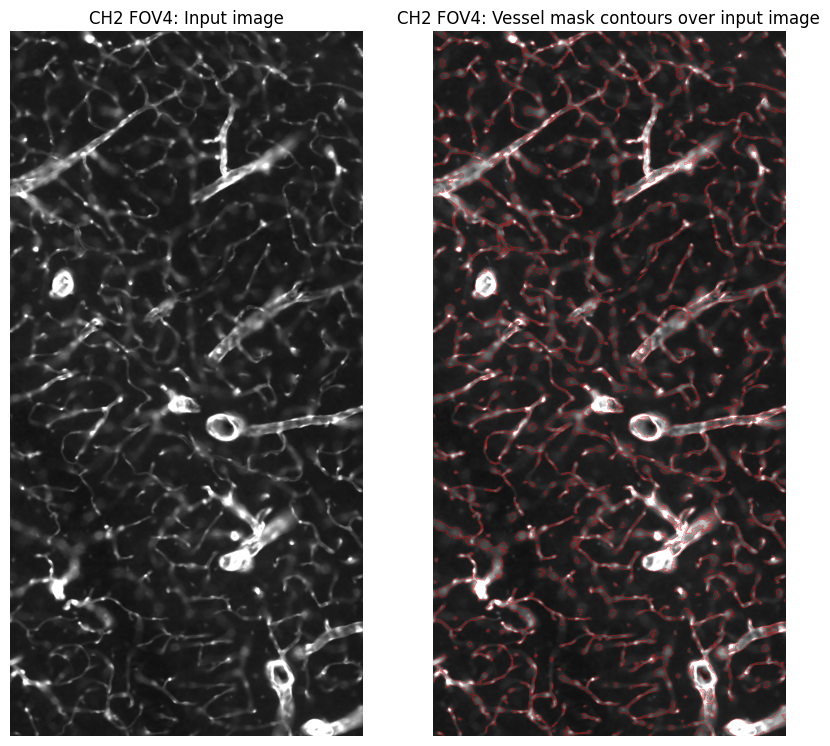

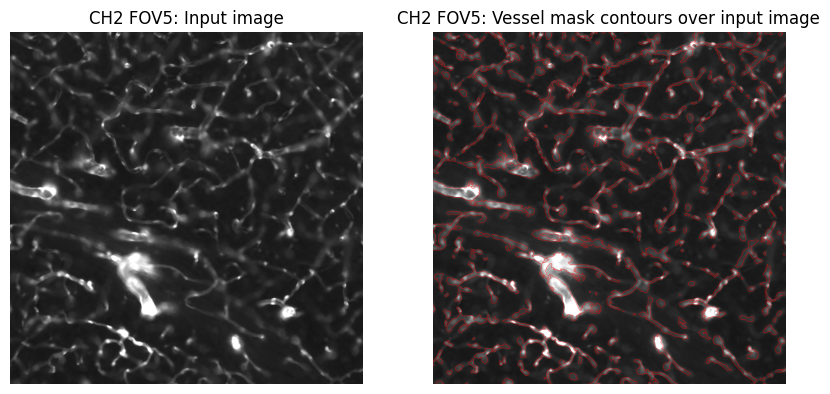

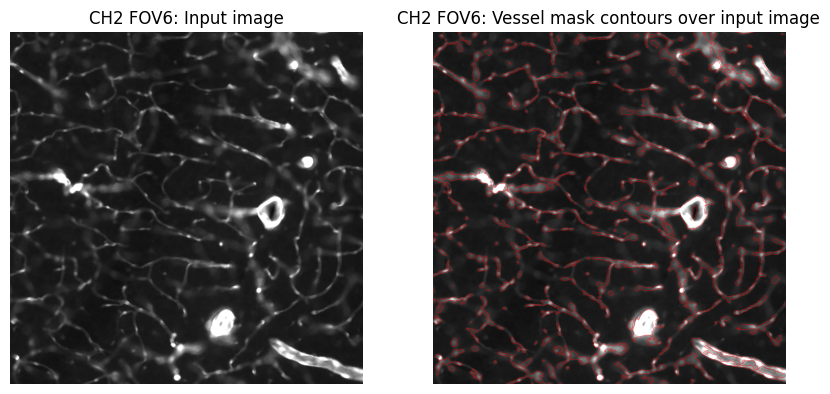

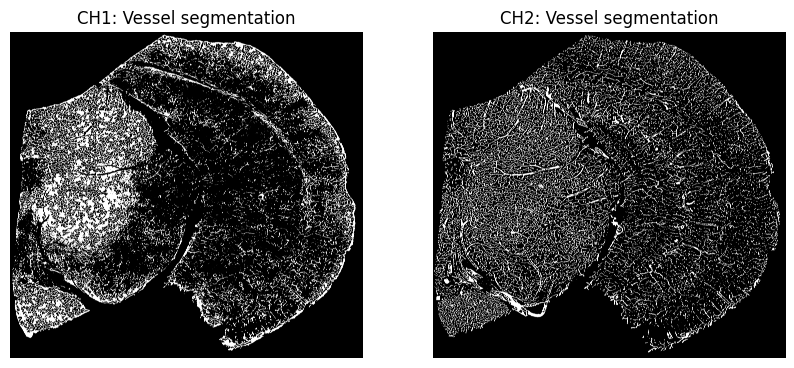

In [44]:
# Parameters for vessel detection
sigma_minimum = 1.0  # Range of scales in which MultiScaleHessianBasedMeasureImageFilter will search for vessels
sigma_maximum = 10.0  # 10
number_of_sigma_steps = 10  # 10 Number of scales to search for vessels

# Parameters for post-processing
thresh = 230  # Threshold for binarization, 230
min_size = 100  # Minimum size of objects to keep
area_threshold = 2000 # Minimum area of holes to keep
smoothing = 1  # Smoothing factor for closing, 3

#############################################################

# Alternative: load image in memory
input_image = auto_ch2_median * bg_mask
input_image = input_image.astype(np.float32)
input_image *= 255.0

show(input_image, title="CH2: Input image", axis=False)

# Print statistics
print("Input image type:", input_image.dtype)
print("Input image min:", input_image.min())
print("Input image max:", input_image.max())

# Run the vessel detection
segmented_vessels_array = detect_vessels(input_image, sigma_minimum, sigma_maximum, number_of_sigma_steps,
                                         beta=beta2)

# Process the thresholded vessels
thresholded_vessels_ch2 = process_vessels(segmented_vessels_array, thresh=thresh, min_size=min_size, area_threshold=area_threshold, smoothing=smoothing)
thresholded_vessels_ch2 = thresholded_vessels_ch2 * bg_mask * curr_ch2_thresh

# Print statistics
print("Vesselness image statistics:")
print("Shape:", segmented_vessels_array.shape)
print("Min:", segmented_vessels_array.min())
print("Max:", segmented_vessels_array.max())
print("Mean:", segmented_vessels_array.mean())
print("Median:", np.median(segmented_vessels_array))
#print("Std:", segmented_vessels_array.std())

print("CHANNEL 2")

# Plot the raw vesselness image
show(image=segmented_vessels_array, title=f"CH2: Vesselness image",
     image2=thresholded_vessels_ch2, title2=f"CH2: Vessel mask",
     axis=False)

# Show the results
show(image=input_image, title="CH2: Input image",
     image2=input_image, title2="Vessel mask contours over input image",
     contour2=thresholded_vessels_ch2, contour_alpha=0.45,
     axis=False)

# Plot the raw vesselness image FOV1
show(image=segmented_vessels_array, title=f"CH2 FOV1: Vesselness image",
     image2=thresholded_vessels_ch2, title2=f"CH2 FOV1: Vessel mask",
     xlim=fov1_xlim, ylim=fov1_ylim, xlim2=fov1_xlim, ylim2=fov1_ylim,
     axis=False)


# FOV1
show(image=input_image, title="CH2 FOV1: Input image",
     image2=input_image, title2="CH2 FOV1: Vessel mask contours over input image",
     contour2=thresholded_vessels_ch2, contour_alpha=0.45,
     xlim=fov1_xlim, ylim=fov1_ylim, xlim2=fov1_xlim, ylim2=fov1_ylim,
     axis=False)

# FOV2
show(image=input_image, title="CH2 FOV2: Input image",
     image2=input_image, title2="CH2 FOV2: Vessel mask contours over input image",
     contour2=thresholded_vessels_ch2, contour_alpha=0.45,
     xlim=fov2_xlim, ylim=fov2_ylim, xlim2=fov2_xlim, ylim2=fov2_ylim,
     axis=False)

# FOV3
show(image=input_image, title="CH2 FOV3: Input image",
     image2=input_image, title2="CH2 FOV3: Vessel mask contours over input image",
     contour2=thresholded_vessels_ch2, contour_alpha=0.45,
     xlim=fov3_xlim, ylim=fov3_ylim, xlim2=fov3_xlim, ylim2=fov3_ylim,
     axis=False)

# FOV4
show(image=input_image, title="CH2 FOV4: Input image",
     image2=input_image, title2="CH2 FOV4: Vessel mask contours over input image",
     contour2=thresholded_vessels_ch2, contour_alpha=0.45,
     xlim=fov4_xlim, ylim=fov4_ylim, xlim2=fov4_xlim, ylim2=fov4_ylim,
     axis=False)

# FOV5
show(image=input_image, title="CH2 FOV5: Input image",
     image2=input_image, title2="CH2 FOV5: Vessel mask contours over input image",
     contour2=thresholded_vessels_ch2, contour_alpha=0.45,
     xlim=fov5_xlim, ylim=fov5_ylim, xlim2=fov5_xlim, ylim2=fov5_ylim,
     axis=False)

# FOV6
show(image=input_image, title="CH2 FOV6: Input image",
     image2=input_image, title2="CH2 FOV6: Vessel mask contours over input image",
     contour2=thresholded_vessels_ch2, contour_alpha=0.45,
     xlim=fov6_xlim, ylim=fov6_ylim, xlim2=fov6_xlim, ylim2=fov6_ylim,
     axis=False)

# Full section
show(image=thresholded_vessels_ch1, title="CH1: Vessel segmentation",
     image2=thresholded_vessels_ch2, title2="CH2: Vessel segmentation",
     figsize=(10, 10), axis=False)

# CHANNEL 3

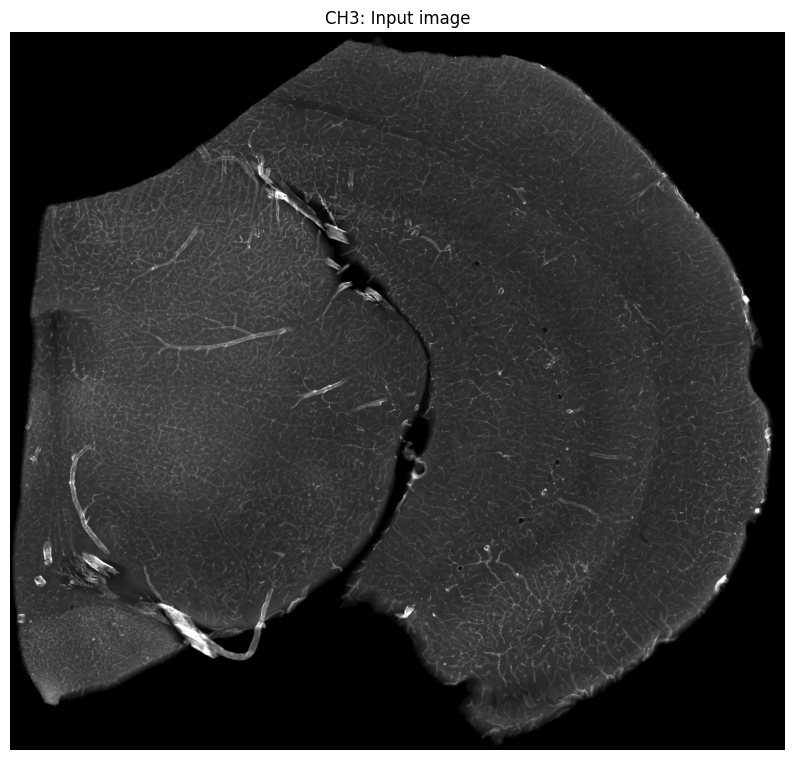

Input image type: float32
Input image min: 0.0
Input image max: 65025.0
Vesselness image statistics:
Shape: (7530, 8128)
Min: 0.0
Max: 255.0
Mean: 140.20781
Median: 217.0
CHANNEL 3


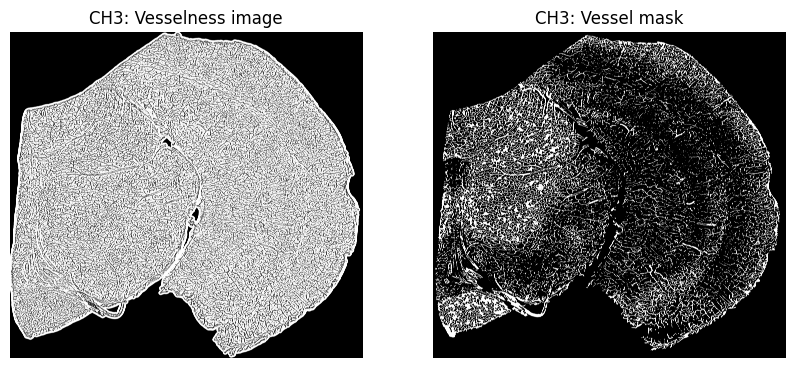

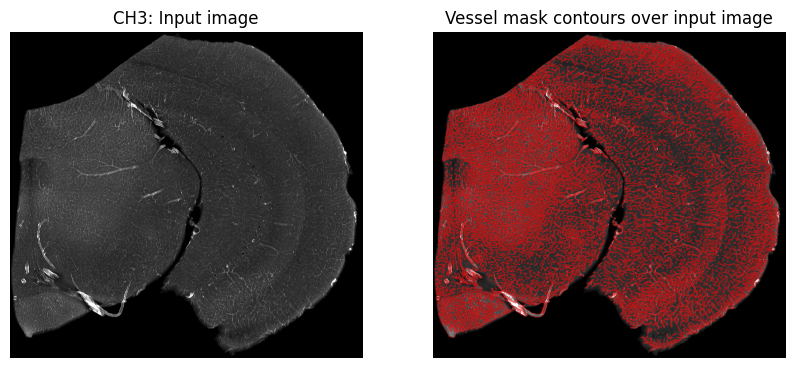

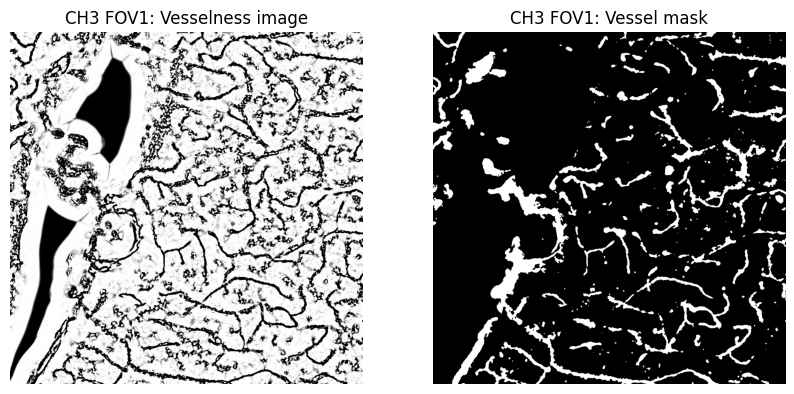

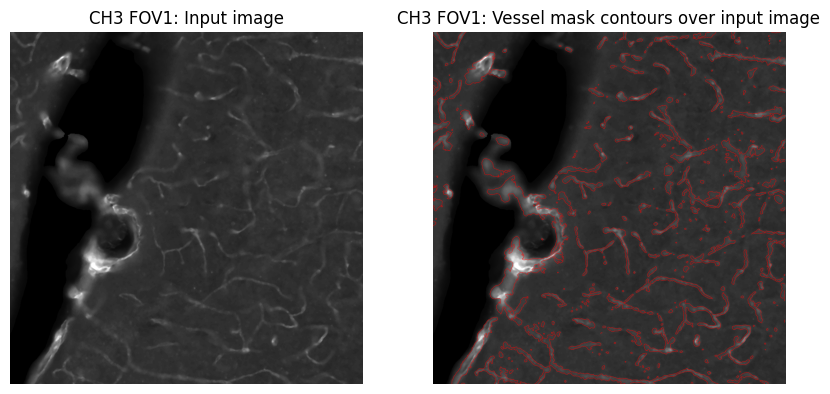

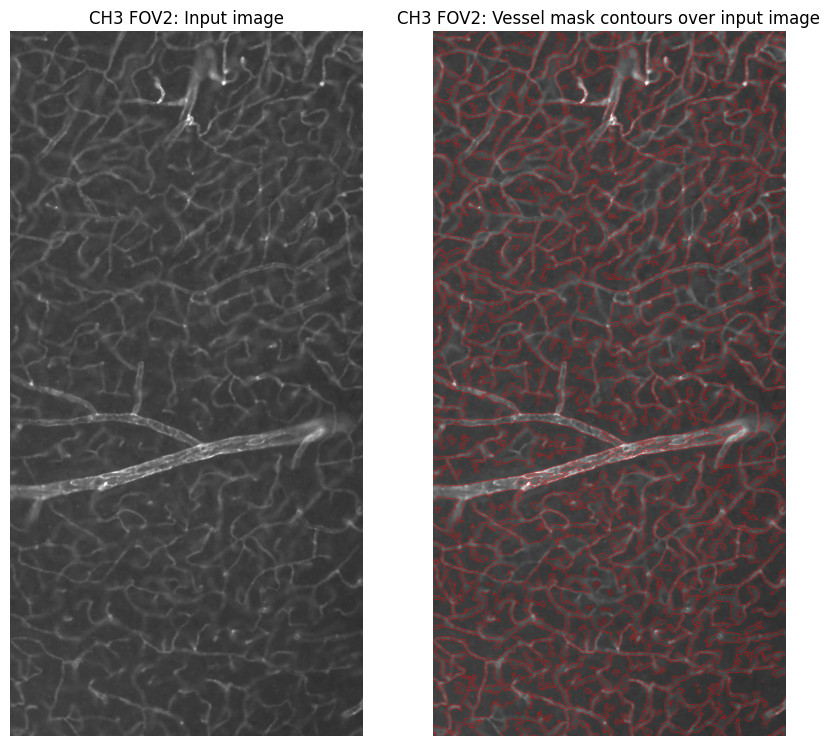

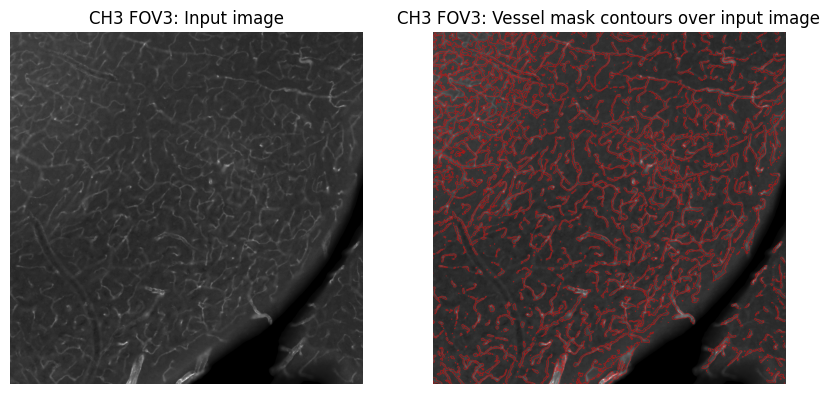

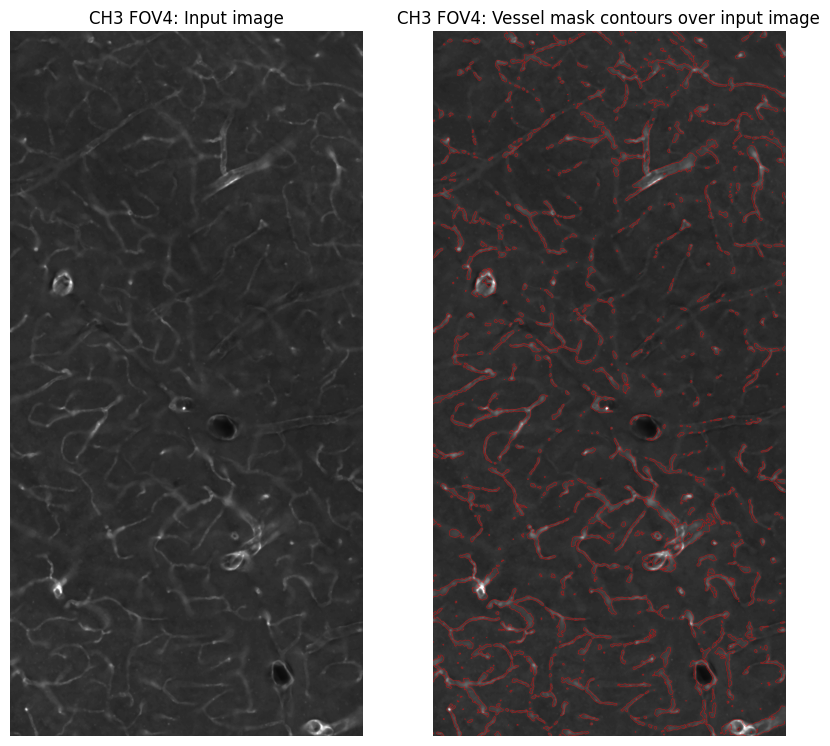

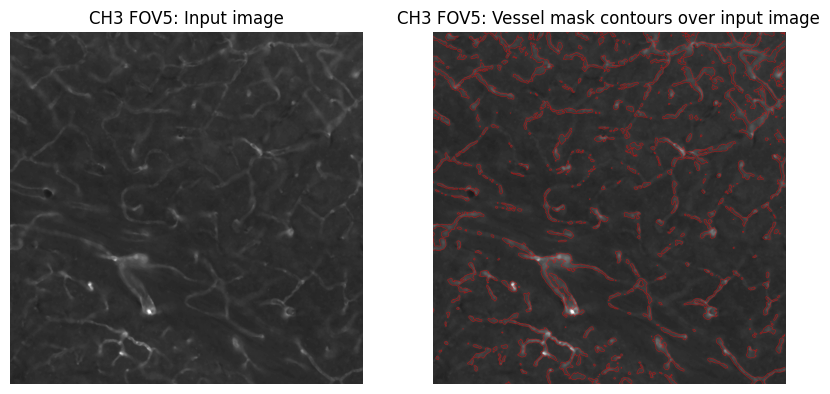

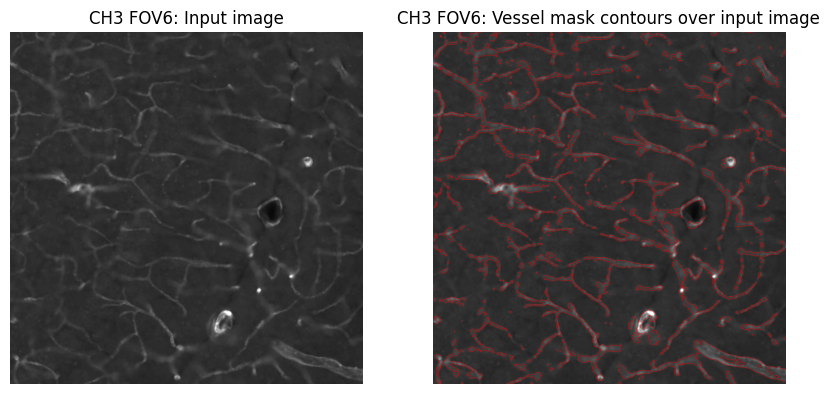

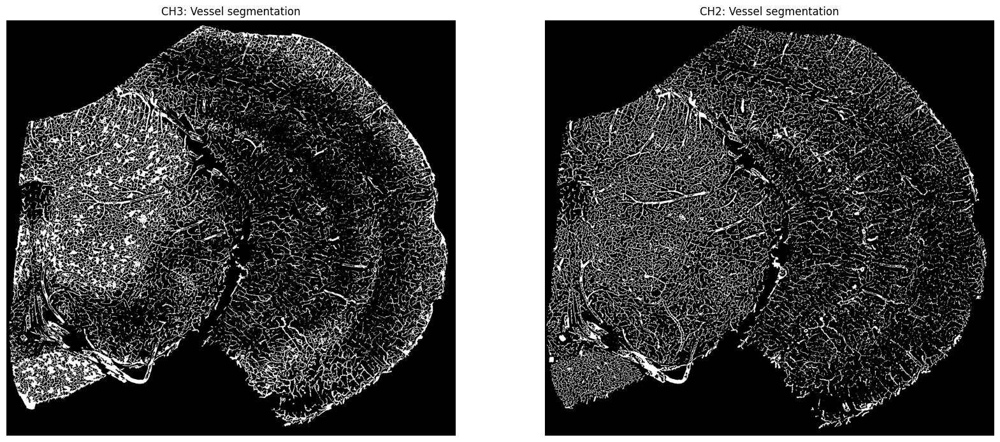

In [45]:
# Parameters for vessel detection
sigma_minimum = 1.0  # Range of scales in which MultiScaleHessianBasedMeasureImageFilter will search for vessels
sigma_maximum = 10.0  # 10
number_of_sigma_steps = 10  # 10 Number of scales to search for vessels

# Parameters for post-processing
thresh = 230  # Threshold for binarization, 230 and 25 and 15
min_size = 100  # Minimum size of objects to keep 100
area_threshold = 2000 # Minimum area of holes to keep
smoothing = 1  # Smoothing factor for closing, 3

#############################################################

# Alternative: load image in memory
input_image = auto_ch3_median * bg_mask
#input_image = cc_ch1_alt * bg_mask
input_image = input_image.astype(np.float32)
input_image *= 255.0

show(input_image, title="CH3: Input image", axis=False)

# Print statistics
print("Input image type:", input_image.dtype)
print("Input image min:", input_image.min())
print("Input image max:", input_image.max())

# Run the vessel detection
segmented_vessels_array = detect_vessels(input_image, sigma_minimum, sigma_maximum, number_of_sigma_steps,
                                         beta=beta3)

# Process the thresholded vessels
thresholded_vessels_ch3 = process_vessels(segmented_vessels_array, thresh=thresh, min_size=min_size, area_threshold=area_threshold, smoothing=smoothing)
thresholded_vessels_ch3 = thresholded_vessels_ch3 * bg_mask * curr_ch3_thresh

# Print statistics
print("Vesselness image statistics:")
print("Shape:", segmented_vessels_array.shape)
print("Min:", segmented_vessels_array.min())
print("Max:", segmented_vessels_array.max())
print("Mean:", segmented_vessels_array.mean())
print("Median:", np.median(segmented_vessels_array))
#print("Std:", segmented_vessels_array.std())

print("CHANNEL 3")

# Plot the raw vesselness image
show(image=segmented_vessels_array, title=f"CH3: Vesselness image",
     image2=thresholded_vessels_ch3, title2=f"CH3: Vessel mask",
     axis=False)

# Show the results
show(image=input_image, title="CH3: Input image",
     image2=input_image, title2="Vessel mask contours over input image",
     contour2=thresholded_vessels_ch3, contour_alpha=0.45,
     axis=False)

# Plot the raw vesselness image FOV1
show(image=segmented_vessels_array, title=f"CH3 FOV1: Vesselness image",
     image2=thresholded_vessels_ch3, title2=f"CH3 FOV1: Vessel mask",
     xlim=fov1_xlim, ylim=fov1_ylim, xlim2=fov1_xlim, ylim2=fov1_ylim,
     axis=False)


# FOV1
show(image=input_image, title="CH3 FOV1: Input image",
     image2=input_image, title2="CH3 FOV1: Vessel mask contours over input image",
     contour2=thresholded_vessels_ch3, contour_alpha=0.45,
     xlim=fov1_xlim, ylim=fov1_ylim, xlim2=fov1_xlim, ylim2=fov1_ylim,
     axis=False)

# FOV2
show(image=input_image, title="CH3 FOV2: Input image",
     image2=input_image, title2="CH3 FOV2: Vessel mask contours over input image",
     contour2=thresholded_vessels_ch3, contour_alpha=0.45,
     xlim=fov2_xlim, ylim=fov2_ylim, xlim2=fov2_xlim, ylim2=fov2_ylim,
     axis=False)

# FOV3
show(image=input_image, title="CH3 FOV3: Input image",
     image2=input_image, title2="CH3 FOV3: Vessel mask contours over input image",
     contour2=thresholded_vessels_ch3, contour_alpha=0.45,
     xlim=fov3_xlim, ylim=fov3_ylim, xlim2=fov3_xlim, ylim2=fov3_ylim,
     axis=False)

# FOV4
show(image=input_image, title="CH3 FOV4: Input image",
     image2=input_image, title2="CH3 FOV4: Vessel mask contours over input image",
     contour2=thresholded_vessels_ch3, contour_alpha=0.45,
     xlim=fov4_xlim, ylim=fov4_ylim, xlim2=fov4_xlim, ylim2=fov4_ylim,
     axis=False)

# FOV5
show(image=input_image, title="CH3 FOV5: Input image",
     image2=input_image, title2="CH3 FOV5: Vessel mask contours over input image",
     contour2=thresholded_vessels_ch3, contour_alpha=0.45,
     xlim=fov5_xlim, ylim=fov5_ylim, xlim2=fov5_xlim, ylim2=fov5_ylim,
     axis=False)

# FOV6
show(image=input_image, title="CH3 FOV6: Input image",
     image2=input_image, title2="CH3 FOV6: Vessel mask contours over input image",
     contour2=thresholded_vessels_ch3, contour_alpha=0.45,
     xlim=fov6_xlim, ylim=fov6_ylim, xlim2=fov6_xlim, ylim2=fov6_ylim,
     axis=False)

# Full section
show(image=thresholded_vessels_ch3, title="CH3: Vessel segmentation",
     image2=thresholded_vessels_ch2, title2="CH2: Vessel segmentation",
     figsize=(20, 10), axis=False)

# Compute statistics 

In [12]:
remove_mask = np.zeros(curr_ch1.shape)
remove_mask[2000:5000, 1000:3000] = 1
remove_mask = remove_mask.astype(bool)
remove_mask = np.invert(remove_mask)

thresholded_vessels_ch1 = thresholded_vessels_ch1 * remove_mask
thresholded_vessels_ch2 = thresholded_vessels_ch2 * remove_mask
thresholded_vessels_ch3 = thresholded_vessels_ch3 * remove_mask

In [ ]:
Metrics for CH1 and CH2
Beta1: 0.5 Beta2: 1.0
Thresh1: 7000 Thresh2: 4000
Dice coefficient: 0.4062833001456581
IoU score: 0.254928181516069
Precision score: 0.4616057499590352
Recall score: 0.36280223741350853
SSIM score: 0.7024288953105259
MSE score: 0.14986046627139735
Hamming distance: 0.14986046627139735
Rand index: 0.8501395337286026

Metrics for CH1 and CH3
Beta1: 0.5 Beta3: 0.5
Thresh1: 7000 Thresh3: 1000
Dice coefficient: 0.46787411967115566
IoU score: 0.3053757694966517
Precision score: 0.5813461110200782
Recall score: 0.3914647574529056
SSIM score: 0.7013383303380685
MSE score: 0.14688779331492927
Hamming distance: 0.14688779331492927
Rand index: 0.8531122066850707

Metrics for CH2 and CH3
Beta2: 1.0 Beta3: 0.5
Thresh2: 4000 Thresh3: 1000
Dice coefficient: 0.6620558001479877
IoU score: 0.49483065154826084
Precision score: 0.7173997235603101
Recall score: 0.614639343679376
SSIM score: 0.7443240877078602
MSE score: 0.10350907720822745
Hamming distance: 0.10350907720822745
Rand index: 0.8964909227917726

In [13]:
thresholded_ch0 = thresholded_vessels_ch1
thresholded_ch1 = thresholded_vessels_ch2
thresholded_ch2 = thresholded_vessels_ch3

thresh_ch0_flat = thresholded_ch0.flatten()
thresh_ch1_flat = thresholded_ch1.flatten()
thresh_ch2_flat = thresholded_ch2.flatten()

# Compute the metrics ch1 and ch2
dice_score = dice_coefficient(thresholded_ch0, thresholded_ch1)  
iou_score = iou(thresholded_ch0, thresholded_ch1)  # Strongly penalizes over-segmentation and under-segmentation
precision_score = precision(thresholded_ch0, thresholded_ch1) 
recall_score = recall(thresholded_ch0, thresholded_ch1)
ssim_score = ssim(thresholded_ch0, thresholded_ch1)
mse_score = mean_squared_error(thresholded_ch0, thresholded_ch1)
hamming_distance = hamming(thresh_ch0_flat, thresh_ch1_flat)
rand_score = rand_index(thresholded_ch0, thresholded_ch1)  # Measures how close points are clustered together


#print("Beta:", BETA)
print("\nMetrics for CH1 and CH2")
print("Beta1:", beta1, "Beta2:", beta2)
print("Thresh1:", THRESH, "Thresh2:", THRESH2)
print("Dice coefficient:", dice_score)
print("IoU score:", iou_score)
print("Precision score:", precision_score)
print("Recall score:", recall_score)
print("SSIM score:", ssim_score)
print("MSE score:", mse_score)
print("Hamming distance:", hamming_distance)
print("Rand index:", rand_score)

# Compute the metrics ch1 and ch3
dice_score = dice_coefficient(thresholded_ch0, thresholded_ch2)  
iou_score = iou(thresholded_ch0, thresholded_ch2)  # Strongly penalizes over-segmentation and under-segmentation
precision_score = precision(thresholded_ch0, thresholded_ch2) 
recall_score = recall(thresholded_ch0, thresholded_ch2)
ssim_score = ssim(thresholded_ch0, thresholded_ch2)
mse_score = mean_squared_error(thresholded_ch0, thresholded_ch2)
hamming_distance = hamming(thresh_ch0_flat, thresh_ch2_flat)
rand_score = rand_index(thresholded_ch0, thresholded_ch2)  # Measures how close points are clustered together

print("\nMetrics for CH1 and CH3")
print("Beta1:", beta1, "Beta3:", beta3)
print("Thresh1:", THRESH,  "Thresh3:", THRESH3)
print("Dice coefficient:", dice_score)
print("IoU score:", iou_score)
print("Precision score:", precision_score)
print("Recall score:", recall_score)
print("SSIM score:", ssim_score)
print("MSE score:", mse_score)
print("Hamming distance:", hamming_distance)
print("Rand index:", rand_score)

# Compute the metrics ch2 and ch3
dice_score = dice_coefficient(thresholded_ch1, thresholded_ch2)  
iou_score = iou(thresholded_ch1, thresholded_ch2)  # Strongly penalizes over-segmentation and under-segmentation
precision_score = precision(thresholded_ch1, thresholded_ch2) 
recall_score = recall(thresholded_ch1, thresholded_ch2)
ssim_score = ssim(thresholded_ch1, thresholded_ch2)
mse_score = mean_squared_error(thresholded_ch1, thresholded_ch2)
hamming_distance = hamming(thresh_ch1_flat, thresh_ch2_flat)
rand_score = rand_index(thresholded_ch1, thresholded_ch2)  # Measures how close points are clustered together

print("\nMetrics for CH2 and CH3")
print("Beta2:", beta2, "Beta3:", beta3)
print("Thresh2:", THRESH2, "Thresh3:", THRESH3)
print("Dice coefficient:", dice_score)
print("IoU score:", iou_score)
print("Precision score:", precision_score)
print("Recall score:", recall_score)
print("SSIM score:", ssim_score)
print("MSE score:", mse_score)
print("Hamming distance:", hamming_distance)
print("Rand index:", rand_score)

"""
# Write the solutions to a CSV file
csv_filename = 'stats_enhanced_M13.csv'

# Write to rows
rows = [["Index", "Dice coefficient", "IoU score", "Precision", "Recall", "SSIM", "MSE", "Hamming distance", "Rand index"]]
rows.append([IDX, dice_score, iou_score, precision_score, recall_score, ssim_score, mse_score, hamming_distance, rand_score])

#with open(csv_filename, mode='w', newline='') as file:
#    writer = csv.writer(file)
#    writer.writerows(rows)
"""


Metrics for CH1 and CH2
Beta1: 0.5 Beta2: 1.0
Thresh1: 7000 Thresh2: 4000
Dice coefficient: 0.3920806489682931
IoU score: 0.24384347928689215
Precision score: 0.4910493295433253
Recall score: 0.32631366585601435
SSIM score: 0.7689173987987646
MSE score: 0.1153877926613755
Hamming distance: 0.1153877926613755
Rand index: 0.8846122073386246

Metrics for CH1 and CH3
Beta1: 0.5 Beta3: 0.5
Thresh1: 7000 Thresh3: 1000
Dice coefficient: 0.4484470590764613
IoU score: 0.2890311037724113
Precision score: 0.602671433860256
Recall score: 0.35707191005350825
SSIM score: 0.7686410409307722
MSE score: 0.1123364808482605
Hamming distance: 0.1123364808482605
Rand index: 0.8876635191517395

Metrics for CH2 and CH3
Beta2: 1.0 Beta3: 0.5
Thresh2: 4000 Thresh3: 1000
Dice coefficient: 0.6489388271077073
IoU score: 0.4803178717056072
Precision score: 0.6883918435374607
Recall score: 0.6137629323312593
SSIM score: 0.7909108661691165
MSE score: 0.08493150103000073
Hamming distance: 0.08493150103000073
Rand in

'\n# Write the solutions to a CSV file\ncsv_filename = \'stats_enhanced_M13.csv\'\n\n# Write to rows\nrows = [["Index", "Dice coefficient", "IoU score", "Precision", "Recall", "SSIM", "MSE", "Hamming distance", "Rand index"]]\nrows.append([IDX, dice_score, iou_score, precision_score, recall_score, ssim_score, mse_score, hamming_distance, rand_score])\n\n#with open(csv_filename, mode=\'w\', newline=\'\') as file:\n#    writer = csv.writer(file)\n#    writer.writerows(rows)\n'

i = 1, beta = 1

NO MASK


THRESH3 = 600


THRESH3 = 750


THRESH3 = 850

___

i = 1, beta = 0.5

No mask



Thresh3: 600
Dice coefficient: 0.6097010498120713
IoU score: 0.4385395311775622
Precision score: 0.7666881226296652
Recall score: 0.5060767632927562
SSIM score: 0.5985936925126102
MSE score: 0.18166582255140137
Hamming distance: 0.18166582255140137
Rand index: 0.8183341774485986

Thresh3: 750
Dice coefficient: 0.643476671679834
IoU score: 0.4743572471228162
Precision score: 0.6373949686014527
Recall score: 0.6496755499051781
SSIM score: 0.682816449155697
MSE score: 0.13071873317170013
Hamming distance: 0.13071873317170013
Rand index: 0.8692812668282999

THRESH3 = 850

___

i = 0:

Metrics for CH1 and CH2
Dice coefficient: 0.27274313571059994
IoU score: 0.15790537085102713
Precision score: 0.5448619981655141
Recall score: 0.18189822684016205
SSIM score: 0.6986534989962928
MSE score: 0.1481364234820322
Hamming distance: 0.1481364234820322
Rand index: 0.8518635765179677

Metrics for CH1 and CH3
Dice coefficient: 0.2306548833016536
IoU score: 0.1303617259995398
Precision score: 0.6135965588976808
Recall score: 0.1420206849953376
SSIM score: 0.5706484510298674
MSE score: 0.2086809474021951
Hamming distance: 0.2086809474021951
Rand index: 0.7913190525978049

**Metrics for CH2 and CH3**
Dice coefficient: 0.5760100427448872
IoU score: 0.40450428727405197
Precision score: 0.7034115511511926
Recall score: 0.48768145009858876
SSIM score: 0.6126306801347183
MSE score: 0.15813732933926358
Hamming distance: 0.15813732933926358
Rand index: 0.8418626706607364

i = 1:

Metrics for CH1 and CH2
Dice coefficient: 0.245836730615445
IoU score: 0.1401447259249114
Precision score: 0.5761866533638593
Recall score: 0.15625165803534322
SSIM score: 0.7022287768475542
MSE score: 0.14720060849664987
Hamming distance: 0.14720060849664987
Rand index: 0.8527993915033502

Metrics for CH1 and CH3
Dice coefficient: 0.20725327427971982
IoU score: 0.11560655574280895
Precision score: 0.6572629327037258
Recall score: 0.12302290868303843
SSIM score: 0.5717238769526934
MSE score: 0.20936303371847162
Hamming distance: 0.20936303371847162
Rand index: 0.7906369662815284

**Metrics for CH2 and CH3**
Dice coefficient: 0.5908514936809713
IoU score: 0.419296824310158
Precision score: 0.7234446321961222
Recall score: 0.4993335062463392
SSIM score: 0.6204581865123154
MSE score: 0.15384178011070423
Hamming distance: 0.15384178011070423
Rand index: 0.8461582198892957

i = 2:

Metrics for CH1 and CH2
Dice coefficient: 0.24437037200748052
IoU score: 0.13919244019987667
Precision score: 0.7171181962666976
Recall score: 0.1472791367868208
SSIM score: 0.7539925212381592
MSE score: 0.12095096261762929
Hamming distance: 0.12095096261762929
Rand index: 0.8790490373823707

Metrics for CH1 and CH3
Dice coefficient: 0.1767423457615442
IoU score: 0.09693766832717152
Precision score: 0.7419631727169791
Recall score: 0.10031970376591207
SSIM score: 0.6164458317040694
MSE score: 0.18851055438826642
Hamming distance: 0.18851055438826642
Rand index: 0.8114894456117335

**Metrics for CH2 and CH3**
Dice coefficient: 0.5826158180026024
IoU score: 0.4110500352710103
Precision score: 0.7337932341113274
Recall score: 0.48308895354918413
SSIM score: 0.65387020288076
MSE score: 0.13961596698283088
Hamming distance: 0.13961596698283088
Rand index: 0.8603840330171691

i = 3:

Metrics for CH1 and CH2
Dice coefficient: 0.3051017946099909
IoU score: 0.18001186952686907
Precision score: 0.6112748684324553
Recall score: 0.2032824433616828
SSIM score: 0.7625827848601079
MSE score: 0.11666098581119899
Hamming distance: 0.11666098581119899
Rand index: 0.883339014188801

Metrics for CH1 and CH3
Dice coefficient: 0.2618784891350203
IoU score: 0.15066753820030454
Precision score: 0.6888105539366507
Recall score: 0.161672292637859
SSIM score: 0.6591317797472983
MSE score: 0.16268237398504107
Hamming distance: 0.16268237398504107
Rand index: 0.837317626014959

**Metrics for CH2 and CH3**
Dice coefficient: 0.6014670997639764
IoU score: 0.4300700395839595
Precision score: 0.726831463573052
Recall score: 0.5129868022886521
SSIM score: 0.6935805581112746
MSE score: 0.12134876599469556
Hamming distance: 0.12134876599469556
Rand index: 0.8786512340053044


i = 4: 

Metrics for CH1 and CH2
Dice coefficient: 0.36436460396084075
IoU score: 0.2227663969874845
Precision score: 0.5618214104087684
Recall score: 0.2696084665088553
SSIM score: 0.7269630573792908
MSE score: 0.1329450733810166
Hamming distance: 0.1329450733810166
Rand index: 0.8670549266189834

Metrics for CH1 and CH3
Dice coefficient: 0.32079883375445895
IoU score: 0.19104252676986894
Precision score: 0.6225576556481468
Recall score: 0.21606860283175724
SSIM score: 0.6301664443386529
MSE score: 0.17879167385575806
Hamming distance: 0.17879167385575806
Rand index: 0.8212083261442419

**Metrics for CH2 and CH3**
Dice coefficient: 0.6327717245165184
IoU score: 0.46281351538956184
Precision score: 0.7538477510026603
Recall score: 0.5452058267223825
SSIM score: 0.6906014957573035
MSE score: 0.12366292703202936
Hamming distance: 0.12366292703202936
Rand index: 0.8763370729679706

Run the whole thing

In [6]:

def run_test(idx, t1=None, t3=None):
    print()
    print()
    IDX = idx
    
    THRESH2 = 3000  # 3000
    THRESH3 = 600  # 1000

    if IDX == 0:
        THRESH = 7500  # 7500
        max_value = 20000  # 20000
        THRESH3 = 600
    elif IDX == 1:
        THRESH = 6000  # 6000
        max_value = 20000  # 20000
        THRESH3 = 850
    elif IDX == 2:
        THRESH = 6000  # 6000
        max_value = 20000  # 20000
    elif IDX == 3:
        THRESH = 6000  # 6000
        max_value = 20000  # 20000
    elif IDX == 4:
        THRESH = 7500  # 7500
        THRESH2 = 4000 # 4000
        max_value = 20000  # 20000
    max_value3 = 2000

    if t3 is not None:
        THRESH3 = t3
    if t1 is not None:
        THRESH = t1
        
    # Load the image channels
    curr_ch1, curr_ch2, curr_ch3 = load_3_channels(filepath, IDX)
    curr_ch1 = curr_ch1.astype(np.float32)
    curr_ch2 = curr_ch2.astype(np.float32)
    curr_ch3 = curr_ch3.astype(np.float32)


    # Ch1 settings
    gamma_ch1 = 2  # You can adjust this value to control the contrast enhancement
    contrast_alpha_ch1 = 0.00525  # Try 0.0225 You can adjust this value to control the brightness enhancement 0.5 default

    # Ch2 settings
    gamma_ch2 = 2  # You can adjust this value to control the contrast enhancement
    contrast_alpha_ch2 = 0.0125  # Try 0.125 You can adjust this value to control the brightness enhancement 0.5 default

    # Ch3 settings
    gamma_ch3 = 2  # You can adjust this value to control the contrast enhancement
    contrast_alpha_ch3 = 0.0425  # Try 0.125 You can adjust this value to control the brightness enhancement 0.5 default


    # No change
    contrast_ch1 = curr_ch1
    contrast_ch2 = curr_ch2
    contrast_ch3 = curr_ch3


    cc_ch1 = auto_contrast(contrast_ch1, alpha=contrast_alpha_ch1)
    cc_ch2 = auto_contrast(contrast_ch2, alpha=contrast_alpha_ch2)
    cc_ch3 = auto_contrast(contrast_ch3, alpha=contrast_alpha_ch3)


    bg_alpha = 0.25  # 0.5
    bg_mask = auto_contrast(curr_ch1, alpha=bg_alpha)  # 7
    bg_mask = get_brain_mask(bg_mask, area_threshold=25000)  # 255 default ch0, 150 for ch1

    #show(cc_ch1, bg_mask, title=f"Section {IDX} ch1 contrast", axis=True)
    #show(cc_ch2, bg_mask, title=f"Section {IDX} ch2 contrast", axis=True)
    #show(cc_ch3, bg_mask, title=f"Section {IDX} ch3 contrast", axis=True)

    # Setup FOVs
    fovs = [ 
    # xlim,             ylim
    ( (4000, 5000),     (4000, 5000) ),
    ( (2000, 3000),     (2000, 4000) ),
    ( (2000, 4000),     (4000, 6000) ),
    ( (5000, 6000),     (2000, 4000) ),
    ( (5000, 6000),     (1000, 2000) ),
    ( (5000, 6000),     (4000, 5000) ),
    ]

    fov1_xlim, fov1_ylim = fovs[0][0], fovs[0][1][::-1]
    fov2_xlim, fov2_ylim = fovs[1][0], fovs[1][1][::-1]
    fov3_xlim, fov3_ylim = fovs[2][0], fovs[2][1][::-1]
    fov4_xlim, fov4_ylim = fovs[3][0], fovs[3][1][::-1]
    fov5_xlim, fov5_ylim = fovs[4][0], fovs[4][1][::-1]
    fov6_xlim, fov6_ylim = fovs[5][0], fovs[5][1][::-1]

    # Create a threshold mask for the image
    curr_ch1_median = ndimage.median_filter(curr_ch1.copy(), size=5)
    curr_ch2_median = ndimage.median_filter(curr_ch2.copy(), size=5)  # Repeat for ch2
    curr_ch3_median = ndimage.median_filter(curr_ch3.copy(), size=5)  # Repeat for ch2

    # Create auto contrast brightened images
    auto_ch1 = auto_contrast(curr_ch1, alpha=contrast_alpha_ch1)
    auto_ch2 = auto_contrast(curr_ch2, alpha=contrast_alpha_ch2)
    auto_ch3 = auto_contrast(curr_ch3, alpha=contrast_alpha_ch3)
    auto_ch1_median = ndimage.median_filter(auto_ch1.copy(), size=5) # 5
    auto_ch2_median = ndimage.median_filter(auto_ch2.copy(), size=5)
    auto_ch3_median = ndimage.median_filter(auto_ch3.copy(), size=5)

    # Ch1 settings
    gamma_ch1 = 2  # You can adjust this value to control the contrast enhancement
    contrast_alpha_ch1 = 0.00525  # Try 0.0225 You can adjust this value to control the brightness enhancement 0.5 default

    # Ch2 settings
    gamma_ch2 = 2  # You can adjust this value to control the contrast enhancement
    contrast_alpha_ch2 = 0.0125  # Try 0.125 You can adjust this value to control the brightness enhancement 0.5 default

    # Ch3 settings
    gamma_ch3 = 2  # You can adjust this value to control the contrast enhancement
    contrast_alpha_ch3 = 0.0425  # Try 0.125 You can adjust this value to control the brightness enhancement 0.5 default




    # Create contrast enhanced images
    cc_ch1 = gamma_correction(curr_ch1, gamma=gamma_ch1)
    cc_ch1 = auto_contrast(cc_ch1, alpha=contrast_alpha_ch1)
    cc_ch1_alt = gamma_correction(curr_ch1_median, gamma=gamma_ch1, max_value=max_value)

    cc_ch2 = gamma_correction(curr_ch2, gamma=gamma_ch2)
    cc_ch2 = auto_contrast(cc_ch2, alpha=contrast_alpha_ch2)

    cc_ch3 = gamma_correction(curr_ch3, gamma=gamma_ch3)
    cc_ch3 = auto_contrast(cc_ch3, alpha=contrast_alpha_ch3)
    cc_ch3_alt = gamma_correction(curr_ch3_median, gamma=gamma_ch3, max_value=max_value3)


    print(f"\nThreshold for ch1: {THRESH}")
    print(f"Threshold for ch2: {THRESH2}")
    print(f"Threshold for ch3: {THRESH3}")


    curr_ch1_thresh = cc_ch1_alt.copy() > THRESH
    curr_ch1_thresh[curr_ch1_thresh != 0] = 1
    curr_ch1_thresh = curr_ch1_thresh.astype(bool)

    curr_ch2_thresh = curr_ch2_median.copy() > THRESH2
    curr_ch2_thresh[curr_ch2_thresh != 0] = 1
    curr_ch2_thresh = curr_ch2_thresh.astype(bool)

    curr_ch3_thresh = cc_ch3_alt.copy() > THRESH3
    curr_ch3_thresh[curr_ch3_thresh != 0] = 1
    curr_ch3_thresh = curr_ch3_thresh.astype(bool)



    # Parameters for vessel detection
    sigma_minimum = 1.0  # Range of scales in which MultiScaleHessianBasedMeasureImageFilter will search for vessels
    sigma_maximum = 10.0  # 10
    number_of_sigma_steps = 10  # 10 Number of scales to search for vessels

    # Parameters for post-processing
    thresh = 230  # Threshold for binarization, 230 and 25 and 15
    min_size = 100  # Minimum size of objects to keep 100
    area_threshold = 2000 # Minimum area of holes to keep
    smoothing = 1  # Smoothing factor for closing, 3

    #############################################################

    # Alternative: load image in memory
    input_image = auto_ch1_median * bg_mask
    #input_image = cc_ch1_alt * bg_mask
    input_image = input_image.astype(np.float32)
    input_image *= 255.0

    #show(input_image, title="CH1: Input image", axis=False)

    # Print statistics
    #print("Input image type:", input_image.dtype)
    #print("Input image min:", input_image.min())
    #print("Input image max:", input_image.max())

    # Run the vessel detection
    segmented_vessels_array = detect_vessels(input_image, sigma_minimum, sigma_maximum, number_of_sigma_steps)

    # Process the thresholded vessels
    thresholded_vessels_ch1 = process_vessels(segmented_vessels_array, thresh=thresh, min_size=min_size, area_threshold=area_threshold, smoothing=smoothing)
    thresholded_vessels_ch1 = thresholded_vessels_ch1 * bg_mask #* curr_ch1_thresh

    # Print statistics
    #print("Vesselness image statistics:")
    #print("Shape:", segmented_vessels_array.shape)
    #print("Min:", segmented_vessels_array.min())
    #print("Max:", segmented_vessels_array.max())
    #print("Mean:", segmented_vessels_array.mean())
    #print("Median:", np.median(segmented_vessels_array))
    #print("Std:", segmented_vessels_array.std())


    # Parameters for vessel detection
    sigma_minimum = 1.0  # Range of scales in which MultiScaleHessianBasedMeasureImageFilter will search for vessels
    sigma_maximum = 10.0  # 10
    number_of_sigma_steps = 10  # 10 Number of scales to search for vessels

    # Parameters for post-processing
    thresh = 230  # Threshold for binarization, 230
    min_size = 100  # Minimum size of objects to keep
    area_threshold = 2000 # Minimum area of holes to keep
    smoothing = 1  # Smoothing factor for closing, 3

    #############################################################

    # Alternative: load image in memory
    input_image = auto_ch2_median * bg_mask
    input_image = input_image.astype(np.float32)
    input_image *= 255.0

    #show(input_image, title="CH2: Input image", axis=False)

    # Print statistics
    #print("Input image type:", input_image.dtype)
    #print("Input image min:", input_image.min())
    #print("Input image max:", input_image.max())

    # Run the vessel detection
    segmented_vessels_array = detect_vessels(input_image, sigma_minimum, sigma_maximum, number_of_sigma_steps)

    # Process the thresholded vessels
    thresholded_vessels_ch2 = process_vessels(segmented_vessels_array, thresh=thresh, min_size=min_size, area_threshold=area_threshold, smoothing=smoothing)
    thresholded_vessels_ch2 = thresholded_vessels_ch2 * bg_mask * curr_ch2_thresh


    #############################################################

    # Parameters for vessel detection
    sigma_minimum = 1.0  # Range of scales in which MultiScaleHessianBasedMeasureImageFilter will search for vessels
    sigma_maximum = 10.0  # 10
    number_of_sigma_steps = 10  # 10 Number of scales to search for vessels

    # Parameters for post-processing
    thresh = 230  # Threshold for binarization, 230 and 25 and 15
    min_size = 100  # Minimum size of objects to keep 100
    area_threshold = 2000 # Minimum area of holes to keep
    smoothing = 1  # Smoothing factor for closing, 3

    #############################################################

    # Alternative: load image in memory
    input_image = auto_ch3_median * bg_mask
    #input_image = cc_ch1_alt * bg_mask
    input_image = input_image.astype(np.float32)
    input_image *= 255.0

    #show(input_image, title="CH3: Input image", axis=False)

    # Print statistics
    #print("Input image type:", input_image.dtype)
    #print("Input image min:", input_image.min())
    #print("Input image max:", input_image.max())

    # Run the vessel detection
    segmented_vessels_array = detect_vessels(input_image, sigma_minimum, sigma_maximum, number_of_sigma_steps)

    # Process the thresholded vessels
    thresholded_vessels_ch3 = process_vessels(segmented_vessels_array, thresh=thresh, min_size=min_size, area_threshold=area_threshold, smoothing=smoothing)
    thresholded_vessels_ch3 = thresholded_vessels_ch3 * bg_mask #* curr_ch3_thresh

    # Print statistics

    thresholded_ch0 = thresholded_vessels_ch1
    thresholded_ch1 = thresholded_vessels_ch2
    thresholded_ch2 = thresholded_vessels_ch3

    thresh_ch0_flat = thresholded_ch0.flatten()
    thresh_ch1_flat = thresholded_ch1.flatten()
    thresh_ch2_flat = thresholded_ch2.flatten()

    # Compute the metrics ch1 and ch2
    dice_score = dice_coefficient(thresholded_ch0, thresholded_ch1)  
    iou_score = iou(thresholded_ch0, thresholded_ch1)  # Strongly penalizes over-segmentation and under-segmentation
    precision_score = precision(thresholded_ch0, thresholded_ch1) 
    recall_score = recall(thresholded_ch0, thresholded_ch1)
    ssim_score = ssim(thresholded_ch0, thresholded_ch1)
    mse_score = mean_squared_error(thresholded_ch0, thresholded_ch1)
    hamming_distance = hamming(thresh_ch0_flat, thresh_ch1_flat)
    rand_score = rand_index(thresholded_ch0, thresholded_ch1)  # Measures how close points are clustered together
    
    print("\nSlice index:", IDX)
    if t3 is not None:
        print("Thresh3:", THRESH3)
    if t1 is not None:
        print("Thresh1:", THRESH)
    print()

    #print("Beta:", BETA)
    print("\nMetrics for CH1 and CH2")
    print("Thresh1:", THRESH, "Thresh2:", THRESH2)
    print("Dice coefficient:", dice_score)
    print("IoU score:", iou_score)
    print("Precision score:", precision_score)
    print("Recall score:", recall_score)
    print("SSIM score:", ssim_score)
    print("MSE score:", mse_score)
    print("Hamming distance:", hamming_distance)
    print("Rand index:", rand_score)

    # Compute the metrics ch1 and ch3
    dice_score = dice_coefficient(thresholded_ch0, thresholded_ch2)  
    iou_score = iou(thresholded_ch0, thresholded_ch2)  # Strongly penalizes over-segmentation and under-segmentation
    precision_score = precision(thresholded_ch0, thresholded_ch2) 
    recall_score = recall(thresholded_ch0, thresholded_ch2)
    ssim_score = ssim(thresholded_ch0, thresholded_ch2)
    mse_score = mean_squared_error(thresholded_ch0, thresholded_ch2)
    hamming_distance = hamming(thresh_ch0_flat, thresh_ch2_flat)
    rand_score = rand_index(thresholded_ch0, thresholded_ch2)  # Measures how close points are clustered together

    print("\nMetrics for CH1 and CH3")
    print("Thresh1:", THRESH,  "Thresh3:", THRESH3)
    print("Dice coefficient:", dice_score)
    print("IoU score:", iou_score)
    print("Precision score:", precision_score)
    print("Recall score:", recall_score)
    print("SSIM score:", ssim_score)
    print("MSE score:", mse_score)
    print("Hamming distance:", hamming_distance)
    print("Rand index:", rand_score)

    # Compute the metrics ch2 and ch3
    dice_score = dice_coefficient(thresholded_ch1, thresholded_ch2)  
    iou_score = iou(thresholded_ch1, thresholded_ch2)  # Strongly penalizes over-segmentation and under-segmentation
    precision_score = precision(thresholded_ch1, thresholded_ch2) 
    recall_score = recall(thresholded_ch1, thresholded_ch2)
    ssim_score = ssim(thresholded_ch1, thresholded_ch2)
    mse_score = mean_squared_error(thresholded_ch1, thresholded_ch2)
    hamming_distance = hamming(thresh_ch1_flat, thresh_ch2_flat)
    rand_score = rand_index(thresholded_ch1, thresholded_ch2)  # Measures how close points are clustered together

    print("\nMetrics for CH2 and CH3")
    print("Thresh2:", THRESH2, "Thresh3:", THRESH3)
    print("Dice coefficient:", dice_score)
    print("IoU score:", iou_score)
    print("Precision score:", precision_score)
    print("Recall score:", recall_score)
    print("SSIM score:", ssim_score)
    print("MSE score:", mse_score)
    print("Hamming distance:", hamming_distance)
    print("Rand index:", rand_score)
    print()
    print()
    print()


# RUN TESTS

In [7]:
# Run without mask for ch1 beta = 0.5
filepath = "/media/data/u01/Fig3/M13/*/*.tif"
#IDX = 1

print("Channel 1")

for i in range(0, 5):
    print()
    print("Doing slice:", i)
    print()
    run_test(i, t1=0)
    
print("Channel 3")
    
# Run for ch 3
for i in range(0, 5):
    print()
    print("Doing slice:", i)
    print()
    run_test(i, t3=0)

Channel 1

Doing slice: 0



Found 5 slices
['/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif']

Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 max: 65535
Channel 1 mean: 7515.98976248216

Threshold for ch1: 0
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 0
Thresh1: 0

Beta: 0.5

Metrics for CH1 and CH2
Thresh1: 0 Thresh2: 3000
Dice coefficient: 0.4229364662157428
IoU score: 0.2681797258991093
Precision score: 0.29821791213104126
Recall score: 0.7269607872857511
SSIM score: 0.411024321472689
MSE score: 0.3676618649318463
Hamming distance: 0.3676618649318463
Rand index: 0.6323381350681536

Metrics for CH1 and CH3
Thresh1: 0 Thresh3: 600
Dice coefficient: 0.644607544341192
IoU score: 0.4755873781427176
Precision score: 0.5808789589670913
Recall score: 0.7240427125630137
SSIM score: 0.45245513395021697
MSE score: 0.28937754469817667
Hamming distance: 0.28937754469817667
Rand index: 0.7106224553018233

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 600
Dice coefficient: 0.5423785051226744
IoU score: 0.3720983170382797
Precision score: 0.8015497787729278
Recall score: 0.40985645547348615
SSIM score: 0.51715

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 0
Threshold for ch2: 3000
Threshold for ch3: 850

Slice index: 1
Thresh1: 0

Beta: 0.5

Metrics for CH1 and CH2
Thresh1: 0 Thresh2: 3000
Dice coefficient: 0.41876660443710373
IoU score: 0.2648354162087684
Precision score: 0.29399503600847854
Recall score: 0.7275309075707176
SSIM score: 0.40489487319410794
MSE score: 0.37376963882463937
Hamming distance: 0.37376963882463937
Rand index: 0.6262303611753606

Metrics for CH1 and CH3
Thresh1: 0 Thresh3: 850
Dice coefficient: 0.6483918753893189
IoU score: 0.4797188353510988
Precision score: 0.5798530933237548
Recall score: 0.7353051271053473
SSIM score: 0.45309449457874956
MSE score: 0.2880214419135388
Hamming distance: 0.2880214419135388


TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 0
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 2
Thresh1: 0

Beta: 0.5

Metrics for CH1 and CH2
Thresh1: 0 Thresh2: 3000
Dice coefficient: 0.41781538404402163
IoU score: 0.2640749883613118
Precision score: 0.2922591751625914
Recall score: 0.7325027396632867
SSIM score: 0.46098377933363804
MSE score: 0.3267289799834179
Hamming distance: 0.3267289799834179
Rand index: 0.6732710200165821

Metrics for CH1 and CH3
Thresh1: 0 Thresh3: 600
Dice coefficient: 0.6359741049953241
IoU score: 0.4662478236845672
Precision score: 0.5695088673240045
Recall score: 0.720002939771551
SSIM score: 0.48731112829536716
MSE score: 0.2615390490143942
Hamming distance: 0.2615390490143942
Rand

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 0
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 3
Thresh1: 0

Beta: 0.5

Metrics for CH1 and CH2
Thresh1: 0 Thresh2: 3000
Dice coefficient: 0.4320394386461377
IoU score: 0.2755422867735215
Precision score: 0.30831333232339964
Recall score: 0.7216291284622496
SSIM score: 0.5132547352215557
MSE score: 0.28488323125083054
Hamming distance: 0.28488323125083054
Rand index: 0.7151167687491695

Metrics for CH1 and CH3
Thresh1: 0 Thresh3: 600
Dice coefficient: 0.6080387617559784
IoU score: 0.436821619058177
Precision score: 0.5382134989343512
Recall score: 0.6986825121150932
SSIM score: 0.5176474567827293
MSE score: 0.24386318178292907
Hamming distance: 0.24386318178292907
Ra

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 0
Threshold for ch2: 4000
Threshold for ch3: 600

Slice index: 4
Thresh1: 0

Beta: 0.5

Metrics for CH1 and CH2
Thresh1: 0 Thresh2: 4000
Dice coefficient: 0.4480236489949217
IoU score: 0.2886794303951708
Precision score: 0.32950211525712364
Recall score: 0.6997077122736034
SSIM score: 0.4972117180600466
MSE score: 0.29520515379427176
Hamming distance: 0.29520515379427176
Rand index: 0.7047948462057283

Metrics for CH1 and CH3
Thresh1: 0 Thresh3: 600
Dice coefficient: 0.6075072805465648
IoU score: 0.436273218566641
Precision score: 0.5452483658283305
Recall score: 0.685816949387828
SSIM score: 0.5026916330554297
MSE score: 0.25616552817600985
Hamming distance: 0.25616552817600985
Ran

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 max: 65535
Channel 1 mean: 7515.98976248216

Threshold for ch1: 7500
Threshold for ch2: 3000
Threshold for ch3: 0

Slice index: 0
Thresh3: 0

Beta: 0.5

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 3000
Dice coefficient: 0.4229364662157428
IoU score: 0.2681797258991093
Precision score: 0.29821791213104126
Recall score: 0.7269607872857511
SSIM score: 0.411024321472689
MSE score: 0.3676618649318463
Hamming distance: 0.3676618649318463
Rand index: 0.6323381350681536

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 0
Dice coefficient: 0.644607544341192
IoU score: 0.4755873781427176
Precision score: 0.5808789589670913
Recall score: 0.7240427125630137
SSIM score: 0.45245513395021697
MSE score: 0.28937754469817667
Hamming distance: 0.28937754469817667
Rand index: 0.7106224553018233

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 0
Dice coefficient: 0.5423785051226744
IoU score: 0.3720983170382797
Precision score: 0.8015497787729278
Recall score: 0.40985645547348615
SSIM score: 0.51

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 0

Slice index: 1
Thresh3: 0

Beta: 0.5

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.41876660443710373
IoU score: 0.2648354162087684
Precision score: 0.29399503600847854
Recall score: 0.7275309075707176
SSIM score: 0.40489487319410794
MSE score: 0.37376963882463937
Hamming distance: 0.37376963882463937
Rand index: 0.6262303611753606

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 0
Dice coefficient: 0.6483918753893189
IoU score: 0.4797188353510988
Precision score: 0.5798530933237548
Recall score: 0.7353051271053473
SSIM score: 0.45309449457874956
MSE score: 0.2880214419135388
Hamming distance: 0.288021441913

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 0

Slice index: 2
Thresh3: 0

Beta: 0.5

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.41781538404402163
IoU score: 0.2640749883613118
Precision score: 0.2922591751625914
Recall score: 0.7325027396632867
SSIM score: 0.46098377933363804
MSE score: 0.3267289799834179
Hamming distance: 0.3267289799834179
Rand index: 0.6732710200165821

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 0
Dice coefficient: 0.6359741049953241
IoU score: 0.4662478236845672
Precision score: 0.5695088673240045
Recall score: 0.720002939771551
SSIM score: 0.48731112829536716
MSE score: 0.2615390490143942
Hamming distance: 0.2615390490143942

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 0

Slice index: 3
Thresh3: 0

Beta: 0.5

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.4320394386461377
IoU score: 0.2755422867735215
Precision score: 0.30831333232339964
Recall score: 0.7216291284622496
SSIM score: 0.5132547352215557
MSE score: 0.28488323125083054
Hamming distance: 0.28488323125083054
Rand index: 0.7151167687491695

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 0
Dice coefficient: 0.6080387617559784
IoU score: 0.436821619058177
Precision score: 0.5382134989343512
Recall score: 0.6986825121150932
SSIM score: 0.5176474567827293
MSE score: 0.24386318178292907
Hamming distance: 0.243863181782929

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 7500
Threshold for ch2: 4000
Threshold for ch3: 0

Slice index: 4
Thresh3: 0

Beta: 0.5

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 4000
Dice coefficient: 0.4480236489949217
IoU score: 0.2886794303951708
Precision score: 0.32950211525712364
Recall score: 0.6997077122736034
SSIM score: 0.4972117180600466
MSE score: 0.29520515379427176
Hamming distance: 0.29520515379427176
Rand index: 0.7047948462057283

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 0
Dice coefficient: 0.6075072805465648
IoU score: 0.436273218566641
Precision score: 0.5452483658283305
Recall score: 0.685816949387828
SSIM score: 0.5026916330554297
MSE score: 0.25616552817600985
Hamming distance: 0.2561655281760098

In [17]:
# Run without mask for ch1
filepath = "/media/data/u01/Fig3/M13/*/*.tif"
#IDX = 1

print("Channel 1")

for i in range(0, 5):
    print()
    print("Doing slice:", i)
    print()
    run_test(i, t1=0)
    
print("Channel 3")
    
# Run for ch 3
for i in range(0, 5):
    print()
    print("Doing slice:", i)
    print()
    run_test(i, t3=0)

Channel 1

Doing slice: 0



Found 5 slices
['/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif']

Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 max: 65535
Channel 1 mean: 7515.98976248216

Threshold for ch1: 0
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 0
Thresh1: 0

Beta: 1

Metrics for CH1 and CH2
Thresh1: 0 Thresh2: 3000
Dice coefficient: 0.4009046248368274
IoU score: 0.2507071379628741
Precision score: 0.31505934946168185
Recall score: 0.5510514605206333
SSIM score: 0.4950679588196977
MSE score: 0.2515048985439901
Hamming distance: 0.2515048985439901
Rand index: 0.74849510145601

Metrics for CH1 and CH3
Thresh1: 0 Thresh3: 600
Dice coefficient: 0.5212753746238084
IoU score: 0.3525168687112345
Precision score: 0.47557444175519975
Recall score: 0.5766934695034962
SSIM score: 0.4823690374033056
MSE score: 0.2333115512701363
Hamming distance: 0.2333115512701363
Rand index: 0.7666884487298637

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 600
Dice coefficient: 0.5760100427448872
IoU score: 0.40450428727405197
Precision score: 0.7034115511511926
Recall score: 0.48768145009858876
SSIM score: 0.61263068

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 0
Threshold for ch2: 3000
Threshold for ch3: 850

Slice index: 1
Thresh1: 0

Beta: 1

Metrics for CH1 and CH2
Thresh1: 0 Thresh2: 3000
Dice coefficient: 0.3976773002241898
IoU score: 0.24818802122682967
Precision score: 0.31289600187106537
Recall score: 0.5454783727487427
SSIM score: 0.491227709214166
MSE score: 0.2537127723158235
Hamming distance: 0.2537127723158235
Rand index: 0.7462872276841765

Metrics for CH1 and CH3
Thresh1: 0 Thresh3: 850
Dice coefficient: 0.5367852640529792
IoU score: 0.3668533748777218
Precision score: 0.4914454202836667
Recall score: 0.5913413182498226
SSIM score: 0.48940090475637893
MSE score: 0.22703925979691345
Hamming distance: 0.22703925979691345
Rand

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 0
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 2
Thresh1: 0

Beta: 1

Metrics for CH1 and CH2
Thresh1: 0 Thresh2: 3000
Dice coefficient: 0.4120666756774329
IoU score: 0.2594987266566912
Precision score: 0.3208642599863917
Recall score: 0.5757049864419673
SSIM score: 0.5486612694001759
MSE score: 0.21815654394549858
Hamming distance: 0.21815654394549858
Rand index: 0.7818434560545015

Metrics for CH1 and CH3
Thresh1: 0 Thresh3: 600
Dice coefficient: 0.5415950440278577
IoU score: 0.37136122022215823
Precision score: 0.5000492596631754
Recall score: 0.5906698975990623
SSIM score: 0.5370093365962207
MSE score: 0.20168505977184478
Hamming distance: 0.20168505977184478
Ran

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 0
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 3
Thresh1: 0

Beta: 1

Metrics for CH1 and CH2
Thresh1: 0 Thresh2: 3000
Dice coefficient: 0.42185417245684337
IoU score: 0.26731000715794573
Precision score: 0.3372095800687057
Recall score: 0.5632343170396941
SSIM score: 0.5925866110372826
MSE score: 0.19449726405060802
Hamming distance: 0.19449726405060802
Rand index: 0.8055027359493919

Metrics for CH1 and CH3
Thresh1: 0 Thresh3: 600
Dice coefficient: 0.5234698460301183
IoU score: 0.3545270271810487
Precision score: 0.48375896125054174
Recall score: 0.5702833597975716
SSIM score: 0.576581893927469
MSE score: 0.18533877411090907
Hamming distance: 0.18533877411090907
Ra

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 0
Threshold for ch2: 4000
Threshold for ch3: 600

Slice index: 4
Thresh1: 0

Beta: 1

Metrics for CH1 and CH2
Thresh1: 0 Thresh2: 4000
Dice coefficient: 0.43204616196172074
IoU score: 0.27554775624151573
Precision score: 0.3545423471469071
Recall score: 0.5529146398815813
SSIM score: 0.5749804421438262
MSE score: 0.20545078544091352
Hamming distance: 0.20545078544091352
Rand index: 0.7945492145590864

Metrics for CH1 and CH3
Thresh1: 0 Thresh3: 600
Dice coefficient: 0.5286129413334103
IoU score: 0.3592616492172043
Precision score: 0.49864353056706034
Recall score: 0.5624151456923067
SSIM score: 0.56024493182452
MSE score: 0.19601389389946774
Hamming distance: 0.19601389389946774
Ran

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 mean: 7515.98976248216

Threshold for ch1: 7500
Threshold for ch2: 3000
Threshold for ch3: 0

Slice index: 0
Thresh3: 0

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 3000
Dice coefficient: 0.4009046248368274
IoU score: 0.2507071379628741
Precision score: 0.31505934946168185
Recall score: 0.5510514605206333
SSIM score: 0.4950679588196977
MSE score: 0.2515048985439901
Hamming distance: 0.2515048985439901
Rand index: 0.74849510145601

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 0
Dice coefficient: 0.5212753746238084
IoU score: 0.3525168687112345
Precision score: 0.47557444175519975
Recall score: 0.5766934695034962
SSIM score: 0.4823690374033056
MSE score: 0.2333115512701363
Hamming distance: 0.2333115512701363
Rand index: 0.7666884487298637

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 0
Dice coefficient: 0.5760100427448872
IoU score: 0.40450428727405197
Precision score: 0.7034115511511926
Recall score: 0.48768145009858876
SSIM score: 0.6126306801347183
MSE score

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 0

Slice index: 1
Thresh3: 0

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.3976773002241898
IoU score: 0.24818802122682967
Precision score: 0.31289600187106537
Recall score: 0.5454783727487427
SSIM score: 0.491227709214166
MSE score: 0.2537127723158235
Hamming distance: 0.2537127723158235
Rand index: 0.7462872276841765

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 0
Dice coefficient: 0.5367852640529792
IoU score: 0.3668533748777218
Precision score: 0.4914454202836667
Recall score: 0.5913413182498226
SSIM score: 0.48940090475637893
MSE score: 0.22703925979691345
Hamming distance: 0.22703925979691345

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 0

Slice index: 2
Thresh3: 0

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.4120666756774329
IoU score: 0.2594987266566912
Precision score: 0.3208642599863917
Recall score: 0.5757049864419673
SSIM score: 0.5486612694001759
MSE score: 0.21815654394549858
Hamming distance: 0.21815654394549858
Rand index: 0.7818434560545015

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 0
Dice coefficient: 0.5415950440278577
IoU score: 0.37136122022215823
Precision score: 0.5000492596631754
Recall score: 0.5906698975990623
SSIM score: 0.5370093365962207
MSE score: 0.20168505977184478
Hamming distance: 0.2016850597718447

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 0

Slice index: 3
Thresh3: 0

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.42185417245684337
IoU score: 0.26731000715794573
Precision score: 0.3372095800687057
Recall score: 0.5632343170396941
SSIM score: 0.5925866110372826
MSE score: 0.19449726405060802
Hamming distance: 0.19449726405060802
Rand index: 0.8055027359493919

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 0
Dice coefficient: 0.5234698460301183
IoU score: 0.3545270271810487
Precision score: 0.48375896125054174
Recall score: 0.5702833597975716
SSIM score: 0.576581893927469
MSE score: 0.18533877411090907
Hamming distance: 0.185338774110909

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 7500
Threshold for ch2: 4000
Threshold for ch3: 0

Slice index: 4
Thresh3: 0

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 4000
Dice coefficient: 0.43204616196172074
IoU score: 0.27554775624151573
Precision score: 0.3545423471469071
Recall score: 0.5529146398815813
SSIM score: 0.5749804421438262
MSE score: 0.20545078544091352
Hamming distance: 0.20545078544091352
Rand index: 0.7945492145590864

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 0
Dice coefficient: 0.5286129413334103
IoU score: 0.3592616492172043
Precision score: 0.49864353056706034
Recall score: 0.5624151456923067
SSIM score: 0.56024493182452
MSE score: 0.19601389389946774
Hamming distance: 0.1960138938994677

In [9]:
filepath = "/media/data/u01/Fig3/M13/*/*.tif"
#IDX = 1
THRESH1LIST = [4000, 5000, 6000, 6500, 7000, 7500, 8000, 8500, 9000]

for i in range(0, 5):
    print()
    print("Doing slice:", i)
    print()
    for t in THRESH1LIST:
        run_test(i, t1=t)


Doing slice: 0



Found 5 slices
['/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif']

Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 max: 65535
Channel 1 mean: 7515.98976248216

Threshold for ch1: 4000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 0
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 4000 Thresh2: 3000
Dice coefficient: 0.4072227150914515
IoU score: 0.2556683341417898
Precision score: 0.3428134046537294
Recall score: 0.5014344555742153
SSIM score: 0.5410431645132676
MSE score: 0.22293236358204993
Hamming distance: 0.22293236358204993
Rand index: 0.7770676364179501

Metrics for CH1 and CH3
Thresh1: 4000 Thresh3: 600
Dice coefficient: 0.4781238229481381
IoU score: 0.3141673614172389
Precision score: 0.41836385397918974
Recall score: 0.5578013334744941
SSIM score: 0.5463111881305464
MSE score: 0.20400321475593025
Hamming distance: 0.20400321475593025
Rand index: 0.7959967852440697

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 600
Dice coefficient: 0.5711467243883976
IoU score: 0.3997238443841797
Precision score: 0.5988649105439249
Recall score: 0.5458808796630796
SSIM sco

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 mean: 7515.98976248216

Threshold for ch1: 5000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 0
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 5000 Thresh2: 3000
Dice coefficient: 0.40158043566892165
IoU score: 0.2512359361898694
Precision score: 0.4034395395667014
Recall score: 0.3997383871813115
SSIM score: 0.6194552940035831
MSE score: 0.18193174400336343
Hamming distance: 0.18193174400336343
Rand index: 0.8180682559966366

Metrics for CH1 and CH3
Thresh1: 5000 Thresh3: 600
Dice coefficient: 0.46471448053885506
IoU score: 0.3026892878543925
Precision score: 0.48962762599791493
Recall score: 0.4422138351229183
SSIM score: 0.6137694634478331
MSE score: 0.17067188675539918
Hamming distance: 0.17067188675539918
Rand index: 0.8293281132446008

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 600
Dice coefficient: 0.5711467243883976
IoU score: 0.3997238443841797
Precision score: 0.5988649105439249
Recall score: 0.5458808796630796
SSIM score: 0.6629535033890

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 mean: 7515.98976248216

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 0
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.363114600912658
IoU score: 0.22183263478012286
Precision score: 0.4621769267862854
Recall score: 0.2990225461345885
SSIM score: 0.6670169958692881
MSE score: 0.16018465311891486
Hamming distance: 0.16018465311891486
Rand index: 0.8398153468810852

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 600
Dice coefficient: 0.39436343812178126
IoU score: 0.2456118946746382
Precision score: 0.5315322046140268
Recall score: 0.3134687651750466
SSIM score: 0.6422871072843193
MSE score: 0.1613021248229775
Hamming distance: 0.1613021248229775
Rand index: 0.8386978751770224

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 600
Dice coefficient: 0.5711467243883976
IoU score: 0.3997238443841797
Precision score: 0.5988649105439249
Recall score: 0.5458808796630796
SSIM score: 0.6629535033890553


TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 max: 65535
Channel 1 mean: 7515.98976248216

Threshold for ch1: 6500
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 0
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6500 Thresh2: 3000
Dice coefficient: 0.3350265392152281
IoU score: 0.20122034801522665
Precision score: 0.4903999567085965
Recall score: 0.2544189755894071
SSIM score: 0.6813978368640567
MSE score: 0.15423182269538857
Hamming distance: 0.15423182269538857
Rand index: 0.8457681773046114

Metrics for CH1 and CH3
Thresh1: 6500 Thresh3: 600
Dice coefficient: 0.3522011045280325
IoU score: 0.2137403450723603
Precision score: 0.5484859355307212
Recall score: 0.25937826911650863
SSIM score: 0.6498219322641082
MSE score: 0.1598502984488405
Hamming distance: 0.1598502984488405
Rand index: 0.8401497015511595

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 600
Dice coefficient: 0.5711467243883976
IoU score: 0.3997238443841797
Precision score: 0.5988649105439249
Recall score: 0.5458808796630796
SSIM scor

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 mean: 7515.98976248216

Threshold for ch1: 7000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 0
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7000 Thresh2: 3000
Dice coefficient: 0.3040356964203534
IoU score: 0.17927010360927392
Precision score: 0.5188648808865249
Recall score: 0.21501256839601682
SSIM score: 0.6916721864702664
MSE score: 0.15032306602938572
Hamming distance: 0.15032306602938572
Rand index: 0.8496769339706143

Metrics for CH1 and CH3
Thresh1: 7000 Thresh3: 600
Dice coefficient: 0.30982247224857973
IoU score: 0.18330765091922718
Precision score: 0.5650249891752275
Recall score: 0.21342546760039185
SSIM score: 0.6550520141939001
MSE score: 0.15930320562820854
Hamming distance: 0.15930320562820854
Rand index: 0.8406967943717915

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 600
Dice coefficient: 0.5711467243883976
IoU score: 0.3997238443841797
Precision score: 0.5988649105439249
Recall score: 0.5458808796630796
SSIM score: 0.66295350338

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 mean: 7515.98976248216

Threshold for ch1: 7500
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 0
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 3000
Dice coefficient: 0.27274313571059994
IoU score: 0.15790537085102713
Precision score: 0.5448619981655141
Recall score: 0.18189822684016205
SSIM score: 0.6986534989962928
MSE score: 0.1481364234820322
Hamming distance: 0.1481364234820322
Rand index: 0.8518635765179677

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 600
Dice coefficient: 0.27029597561860325
IoU score: 0.15626718317619145
Precision score: 0.5792662395241865
Recall score: 0.1762743737175054
SSIM score: 0.65853185211641
MSE score: 0.159450805037396
Hamming distance: 0.159450805037396
Rand index: 0.840549194962604

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 600
Dice coefficient: 0.5711467243883976
IoU score: 0.3997238443841797
Precision score: 0.5988649105439249
Recall score: 0.5458808796630796
SSIM score: 0.6629535033890553
MSE

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 mean: 7515.98976248216

Threshold for ch1: 8000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 0
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 8000 Thresh2: 3000
Dice coefficient: 0.24207117692485372
IoU score: 0.13770249042358745
Precision score: 0.5639525611140822
Recall score: 0.15411089281742063
SSIM score: 0.7026933380521763
MSE score: 0.14737304860373518
Hamming distance: 0.14737304860373518
Rand index: 0.8526269513962649

Metrics for CH1 and CH3
Thresh1: 8000 Thresh3: 600
Dice coefficient: 0.2344543509676091
IoU score: 0.13279427303174068
Precision score: 0.5878451628832019
Recall score: 0.1464275270212569
SSIM score: 0.6603949151664412
MSE score: 0.16020124897658877
Hamming distance: 0.16020124897658877
Rand index: 0.8397987510234112

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 600
Dice coefficient: 0.5711467243883976
IoU score: 0.3997238443841797
Precision score: 0.5988649105439249
Recall score: 0.5458808796630796
SSIM score: 0.662953503389

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 max: 65535
Channel 1 mean: 7515.98976248216

Threshold for ch1: 8500
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 0
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 8500 Thresh2: 3000
Dice coefficient: 0.21364800835133135
IoU score: 0.11960017362208122
Precision score: 0.5762734967899846
Recall score: 0.13113198202558055
SSIM score: 0.7049361861356834
MSE score: 0.14740973236413524
Hamming distance: 0.14740973236413524
Rand index: 0.8525902676358648

Metrics for CH1 and CH3
Thresh1: 8500 Thresh3: 600
Dice coefficient: 0.20334275431325824
IoU score: 0.11317837879285313
Precision score: 0.5918447452011452
Recall score: 0.122759974797427
SSIM score: 0.6613439590125051
MSE score: 0.16114987511617102
Hamming distance: 0.16114987511617102
Rand index: 0.838850124883829

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 600
Dice coefficient: 0.5711467243883976
IoU score: 0.3997238443841797
Precision score: 0.5988649105439249
Recall score: 0.5458808796630796
SSIM s

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 max: 65535
Channel 1 mean: 7515.98976248216

Threshold for ch1: 9000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 0
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 9000 Thresh2: 3000
Dice coefficient: 0.18890971608750157
IoU score: 0.10430717770701078
Precision score: 0.5850842948847991
Recall score: 0.11263909147562196
SSIM score: 0.7062035732485765
MSE score: 0.14770780088289961
Hamming distance: 0.14770780088289961
Rand index: 0.8522921991171004

Metrics for CH1 and CH3
Thresh1: 9000 Thresh3: 600
Dice coefficient: 0.177424093711647
IoU score: 0.0973479859464226
Precision score: 0.5942373357747714
Recall score: 0.10427967013769578
SSIM score: 0.6619085165430011
MSE score: 0.16199194201960523
Hamming distance: 0.16199194201960523
Rand index: 0.8380080579803948

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 600
Dice coefficient: 0.5711467243883976
IoU score: 0.3997238443841797
Precision score: 0.5988649105439249
Recall score: 0.5458808796630796
SSIM s

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 4000
Threshold for ch2: 3000
Threshold for ch3: 850

Slice index: 1
Thresh3: 850

Beta: 1

Metrics for CH1 and CH2
Thresh1: 4000 Thresh2: 3000
Dice coefficient: 0.38558557066996635
IoU score: 0.23883927426861554
Precision score: 0.407021812336653
Recall score: 0.3662942878971508
SSIM score: 0.6245913221271786
MSE score: 0.1792409119232769
Hamming distance: 0.1792409119232769
Rand index: 0.8207590880767232

Metrics for CH1 and CH3
Thresh1: 4000 Thresh3: 850
Dice coefficient: 0.40331465745858947
IoU score: 0.25259495200014925
Precision score: 0.35641848767976186
Recall score: 0.4644214389622137
SSIM score: 0.6712455490764568
MSE score: 0.14572713111999872
Hamming distance: 0.145727131

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 5000
Threshold for ch2: 3000
Threshold for ch3: 850

Slice index: 1
Thresh3: 850

Beta: 1

Metrics for CH1 and CH2
Thresh1: 5000 Thresh2: 3000
Dice coefficient: 0.3247306988291672
IoU score: 0.1938379092855193
Precision score: 0.4944760735052087
Recall score: 0.24174401676326615
SSIM score: 0.6805004545726963
MSE score: 0.15437456928111704
Hamming distance: 0.15437456928111704
Rand index: 0.845625430718883

Metrics for CH1 and CH3
Thresh1: 5000 Thresh3: 850
Dice coefficient: 0.37937557133578814
IoU score: 0.23409222064391919
Precision score: 0.4576597381818271
Recall score: 0.32396100230133296
SSIM score: 0.738751042581848
MSE score: 0.11240329153597349
Hamming distance: 0.112403291

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 850

Slice index: 1
Thresh3: 850

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.245836730615445
IoU score: 0.1401447259249114
Precision score: 0.5761866533638593
Recall score: 0.15625165803534322
SSIM score: 0.7022287768475542
MSE score: 0.14720060849664987
Hamming distance: 0.14720060849664987
Rand index: 0.8527993915033502

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 850
Dice coefficient: 0.300848340834928
IoU score: 0.17705796843511817
Precision score: 0.5335281034653006
Recall score: 0.20948759705933265
SSIM score: 0.7629644212359116
MSE score: 0.10325447397394141
Hamming distance: 0.1032544739

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 6500
Threshold for ch2: 3000
Threshold for ch3: 850

Slice index: 1
Thresh3: 850

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6500 Thresh2: 3000
Dice coefficient: 0.2090287655390422
IoU score: 0.11671251973064502
Precision score: 0.6056312214343806
Recall score: 0.1263122058775953
SSIM score: 0.7063549477457741
MSE score: 0.14677980929271864
Hamming distance: 0.14677980929271864
Rand index: 0.8532201907072814

Metrics for CH1 and CH3
Thresh1: 6500 Thresh3: 850
Dice coefficient: 0.2588168769232251
IoU score: 0.1486442600396219
Precision score: 0.5579431035865244
Recall score: 0.16848705988466958
SSIM score: 0.7676326870763144
MSE score: 0.10233548984200412
Hamming distance: 0.102335489

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 7000
Threshold for ch2: 3000
Threshold for ch3: 850

Slice index: 1
Thresh3: 850

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7000 Thresh2: 3000
Dice coefficient: 0.17798546403104828
IoU score: 0.09768608346277281
Precision score: 0.6266736352602817
Recall score: 0.10372211203217273
SSIM score: 0.7082652136715213
MSE score: 0.14710677658669621
Hamming distance: 0.14710677658669621
Rand index: 0.8528932234133038

Metrics for CH1 and CH3
Thresh1: 7000 Thresh3: 850
Dice coefficient: 0.22216080711083125
IoU score: 0.12496113709238092
Precision score: 0.5745998371321791
Recall score: 0.13770033609809412
SSIM score: 0.7700232578518384
MSE score: 0.10225490964502161
Hamming distance: 0.10225

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 7500
Threshold for ch2: 3000
Threshold for ch3: 850

Slice index: 1
Thresh3: 850

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 3000
Dice coefficient: 0.1522525736261853
IoU score: 0.08239901809793312
Precision score: 0.6404481530621431
Recall score: 0.08639562403099811
SSIM score: 0.7091411587990664
MSE score: 0.14772702400580667
Hamming distance: 0.14772702400580667
Rand index: 0.8522729759941934

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 850
Dice coefficient: 0.19170982894053826
IoU score: 0.10601718242389004
Precision score: 0.5866125230784216
Recall score: 0.11457732338851565
SSIM score: 0.7714479353653937
MSE score: 0.10245859168314546
Hamming distance: 0.102458

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 8000
Threshold for ch2: 3000
Threshold for ch3: 850

Slice index: 1
Thresh3: 850

Beta: 1

Metrics for CH1 and CH2
Thresh1: 8000 Thresh2: 3000
Dice coefficient: 0.13138962304116766
IoU score: 0.07031408187671771
Precision score: 0.650312215699458
Recall score: 0.07307708962225413
SSIM score: 0.7094129868758857
MSE score: 0.14835819988486448
Hamming distance: 0.14835819988486448
Rand index: 0.8516418001151356

Metrics for CH1 and CH3
Thresh1: 8000 Thresh3: 850
Dice coefficient: 0.16685963342101545
IoU score: 0.09102392618870192
Precision score: 0.5961995522944687
Recall score: 0.0970042027035149
SSIM score: 0.7722859346910648
MSE score: 0.1027269121228321
Hamming distance: 0.10272691

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 8500
Threshold for ch2: 3000
Threshold for ch3: 850

Slice index: 1
Thresh3: 850

Beta: 1

Metrics for CH1 and CH2
Thresh1: 8500 Thresh2: 3000
Dice coefficient: 0.11429546366410051
IoU score: 0.060611544100215894
Precision score: 0.6578779669317193
Recall score: 0.06258422072961022
SSIM score: 0.7094409180467712
MSE score: 0.1489330521626551
Hamming distance: 0.1489330521626551
Rand index: 0.8510669478373449

Metrics for CH1 and CH3
Thresh1: 8500 Thresh3: 850
Dice coefficient: 0.14621807562683276
IoU score: 0.07887555364759238
Precision score: 0.6038859049095964
Recall score: 0.08317905356079637
SSIM score: 0.772810666764584
MSE score: 0.10301172460207567
Hamming distance: 0.1030117

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 9000
Threshold for ch2: 3000
Threshold for ch3: 850

Slice index: 1
Thresh3: 850

Beta: 1

Metrics for CH1 and CH2
Thresh1: 9000 Thresh2: 3000
Dice coefficient: 0.10008061959894948
IoU score: 0.05267624544038478
Precision score: 0.6658238888317236
Recall score: 0.05410672645963104
SSIM score: 0.7094378637264922
MSE score: 0.14940710277142075
Hamming distance: 0.14940710277142075
Rand index: 0.8505928972285792

Metrics for CH1 and CH3
Thresh1: 9000 Thresh3: 850
Dice coefficient: 0.12837679690801512
IoU score: 0.06859115483070113
Precision score: 0.6097264891933342
Recall score: 0.07174085091522196
SSIM score: 0.7731511420823055
MSE score: 0.10330838261482861
Hamming distance: 0.10330

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 4000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 2
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 4000 Thresh2: 3000
Dice coefficient: 0.4383685035611923
IoU score: 0.280711873806888
Precision score: 0.4902277436011668
Recall score: 0.39643158543147433
SSIM score: 0.7015610043279049
MSE score: 0.13489257108586497
Hamming distance: 0.13489257108586497
Rand index: 0.8651074289141351

Metrics for CH1 and CH3
Thresh1: 4000 Thresh3: 600
Dice coefficient: 0.4558510083023601
IoU score: 0.2952118032348658
Precision score: 0.566327170760546
Recall score: 0.38144140128929355
SSIM score: 0.6646547700946168
MSE score: 0.14519121575334593
Hamming distance: 0.14519121575

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 5000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 2
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 5000 Thresh2: 3000
Dice coefficient: 0.34618352568930477
IoU score: 0.2093240278269648
Precision score: 0.6391020487425964
Recall score: 0.23738381662826946
SSIM score: 0.7477147684182893
MSE score: 0.11907161433788653
Hamming distance: 0.11907161433788653
Rand index: 0.8809283856621135

Metrics for CH1 and CH3
Thresh1: 5000 Thresh3: 600
Dice coefficient: 0.3158224638663085
IoU score: 0.18752326111137385
Precision score: 0.6683481244133734
Recall score: 0.20676341628347092
SSIM score: 0.6888979054012333
MSE score: 0.14282923045250462
Hamming distance: 0.1428292

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 2
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.24437037200748052
IoU score: 0.13919244019987667
Precision score: 0.7171181962666976
Recall score: 0.1472791367868208
SSIM score: 0.7539925212381592
MSE score: 0.12095096261762929
Hamming distance: 0.12095096261762929
Rand index: 0.8790490373823707

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 600
Dice coefficient: 0.20971990340591024
IoU score: 0.11714362674583206
Precision score: 0.7178721244196861
Recall score: 0.12279696822648684
SSIM score: 0.6905812687217615
MSE score: 0.14755252417974313
Hamming distance: 0.147552

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 6500
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 2
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6500 Thresh2: 3000
Dice coefficient: 0.20677189452750658
IoU score: 0.11530707883536363
Precision score: 0.7391089911069426
Recall score: 0.12019932880645554
SSIM score: 0.7539002623500357
MSE score: 0.12246621630250822
Hamming distance: 0.12246621630250822
Rand index: 0.8775337836974918

Metrics for CH1 and CH3
Thresh1: 6500 Thresh3: 600
Dice coefficient: 0.1743319307729057
IoU score: 0.09548939027383549
Precision score: 0.7306878488357652
Recall score: 0.09897272086309199
SSIM score: 0.6900559375312542
MSE score: 0.14947262540950904
Hamming distance: 0.149472

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 7000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 2
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7000 Thresh2: 3000
Dice coefficient: 0.17644531600240185
IoU score: 0.09675899360231868
Precision score: 0.7530812031568335
Recall score: 0.09992926452902245
SSIM score: 0.7533146334191808
MSE score: 0.12387471539345307
Hamming distance: 0.12387471539345307
Rand index: 0.8761252846065469

Metrics for CH1 and CH3
Thresh1: 7000 Thresh3: 600
Dice coefficient: 0.14669819918560467
IoU score: 0.07915505133656116
Precision score: 0.7370216207871501
Recall score: 0.08145564346686963
SSIM score: 0.689290486877921
MSE score: 0.15108336947587442
Hamming distance: 0.151083

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 7500
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 2
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 3000
Dice coefficient: 0.1522700251512476
IoU score: 0.08240924118996977
Precision score: 0.7603567505244171
Recall score: 0.08460674011422505
SSIM score: 0.752606569744701
MSE score: 0.12509955162815123
Hamming distance: 0.12509955162815123
Rand index: 0.8749004483718488

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 600
Dice coefficient: 0.12578611096144027
IoU score: 0.06711406403351672
Precision score: 0.7415105803894385
Recall score: 0.06872187109852046
SSIM score: 0.6886254625179562
MSE score: 0.1522991892321281
Hamming distance: 0.15229918

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 8000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 2
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 8000 Thresh2: 3000
Dice coefficient: 0.13270433131545986
IoU score: 0.07106765872217041
Precision score: 0.7645246229447147
Recall score: 0.07265807165777304
SSIM score: 0.7518743546571277
MSE score: 0.12611699608741028
Hamming distance: 0.12611699608741028
Rand index: 0.8738830039125897

Metrics for CH1 and CH3
Thresh1: 8000 Thresh3: 600
Dice coefficient: 0.10940787085731167
IoU score: 0.057869632043228696
Precision score: 0.7457963294285274
Recall score: 0.05903406635957605
SSIM score: 0.6880687921447483
MSE score: 0.15323239475113243
Hamming distance: 0.1532

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 8500
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 2
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 8500 Thresh2: 3000
Dice coefficient: 0.11665169165764774
IoU score: 0.061938458829381336
Precision score: 0.7673956913262978
Recall score: 0.06312354567919756
SSIM score: 0.7512289433129757
MSE score: 0.12695213143931092
Hamming distance: 0.12695213143931092
Rand index: 0.873047868560689

Metrics for CH1 and CH3
Thresh1: 8500 Thresh3: 600
Dice coefficient: 0.09605794707745748
IoU score: 0.05045213793666093
Precision score: 0.749066407263901
Recall score: 0.051319500104373215
SSIM score: 0.6875902211616883
MSE score: 0.15399524502088605
Hamming distance: 0.15399

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 9000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 2
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 9000 Thresh2: 3000
Dice coefficient: 0.10311243929450348
IoU score: 0.05435875137277698
Precision score: 0.7696920090611573
Recall score: 0.0552575304905464
SSIM score: 0.7506881722805845
MSE score: 0.12765154707955498
Hamming distance: 0.12765154707955498
Rand index: 0.872348452920445

Metrics for CH1 and CH3
Thresh1: 9000 Thresh3: 600
Dice coefficient: 0.0848046211908836
IoU score: 0.04427987981237497
Precision score: 0.7515308453106098
Recall score: 0.04493775495540468
SSIM score: 0.6871800337533149
MSE score: 0.15464051070559948
Hamming distance: 0.15464051

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 4000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 3
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 4000 Thresh2: 3000
Dice coefficient: 0.4318991287269672
IoU score: 0.275428154297458
Precision score: 0.42403888377929144
Recall score: 0.44005628199656405
SSIM score: 0.6858493566809541
MSE score: 0.1458480726833348
Hamming distance: 0.1458480726833348
Rand index: 0.8541519273166652

Metrics for CH1 and CH3
Thresh1: 4000 Thresh3: 600
Dice coefficient: 0.474667472463842
IoU score: 0.3111895038589151
Precision score: 0.5225836702219956
Recall score: 0.4348002231330642
SSIM score: 0.6515805923454886
MSE score: 0.1512350797271016
Hamming distance: 0.15123507972710

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 5000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 3
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 5000 Thresh2: 3000
Dice coefficient: 0.3894732138756878
IoU score: 0.2418297026980496
Precision score: 0.5307396894758082
Recall score: 0.3075996967500617
SSIM score: 0.7428194612885171
MSE score: 0.12149611009596693
Hamming distance: 0.12149611009596693
Rand index: 0.878503889904033

Metrics for CH1 and CH3
Thresh1: 5000 Thresh3: 600
Dice coefficient: 0.38790805239124954
IoU score: 0.2406240245580543
Precision score: 0.6113642490918323
Recall score: 0.2840767932339566
SSIM score: 0.6854912442941224
MSE score: 0.1408774846950344
Hamming distance: 0.140877484695

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 3
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.3051017946099909
IoU score: 0.18001186952686907
Precision score: 0.6112748684324553
Recall score: 0.2032824433616828
SSIM score: 0.7625827848601079
MSE score: 0.11666098581119899
Hamming distance: 0.11666098581119899
Rand index: 0.883339014188801

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 600
Dice coefficient: 0.28435409014196367
IoU score: 0.16574171191623857
Precision score: 0.6754318427945436
Recall score: 0.18008446237207296
SSIM score: 0.6949920562319888
MSE score: 0.14244031273356345
Hamming distance: 0.14244031

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 6500
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 3
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6500 Thresh2: 3000
Dice coefficient: 0.26663039463562055
IoU score: 0.1538220087686209
Precision score: 0.6341078483393544
Recall score: 0.1688048192194745
SSIM score: 0.7652761445663576
MSE score: 0.1169896479993756
Hamming distance: 0.1169896479993756
Rand index: 0.8830103520006244

Metrics for CH1 and CH3
Thresh1: 6500 Thresh3: 600
Dice coefficient: 0.24364508032951107
IoU score: 0.13872200749448835
Precision score: 0.6926101760821528
Recall score: 0.14782298298854016
SSIM score: 0.6955740023267384
MSE score: 0.14422080398430503
Hamming distance: 0.144220803

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 7000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 3
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7000 Thresh2: 3000
Dice coefficient: 0.2331641214925094
IoU score: 0.1319670515687464
Precision score: 0.6491353528062357
Recall score: 0.14210321908004384
SSIM score: 0.7663521349689099
MSE score: 0.11775895932655682
Hamming distance: 0.11775895932655682
Rand index: 0.8822410406734432

Metrics for CH1 and CH3
Thresh1: 7000 Thresh3: 600
Dice coefficient: 0.21019344917245023
IoU score: 0.11743919982596077
Precision score: 0.7039068646525671
Recall score: 0.12354217295075873
SSIM score: 0.6954677768016468
MSE score: 0.145893099637759
Hamming distance: 0.145893099

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 7500
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 3
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 3000
Dice coefficient: 0.20451601503642927
IoU score: 0.1139057862666365
Precision score: 0.6600317709327511
Recall score: 0.12100521433838168
SSIM score: 0.7666493500718612
MSE score: 0.11859258781738075
Hamming distance: 0.11859258781738075
Rand index: 0.8814074121826192

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 600
Dice coefficient: 0.18244491815380703
IoU score: 0.10037930623180204
Precision score: 0.711850151556225
Recall score: 0.10463071839384432
SSIM score: 0.6950862194036143
MSE score: 0.14735416626530187
Hamming distance: 0.1473541

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 8000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 3
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 8000 Thresh2: 3000
Dice coefficient: 0.1800572786677934
IoU score: 0.09893568438021534
Precision score: 0.6686754502909533
Recall score: 0.104035725775637
SSIM score: 0.7666703176771617
MSE score: 0.11937260632214995
Hamming distance: 0.11937260632214995
Rand index: 0.88062739367785

Metrics for CH1 and CH3
Thresh1: 8000 Thresh3: 600
Dice coefficient: 0.15937429645454315
IoU score: 0.08658702100462501
Precision score: 0.718523736198932
Recall score: 0.08962715747557852
SSIM score: 0.6946305736398823
MSE score: 0.14857371008766795
Hamming distance: 0.14857371008

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 8500
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 3
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 8500 Thresh2: 3000
Dice coefficient: 0.15964779672768556
IoU score: 0.08674850196816523
Precision score: 0.6773842501715288
Recall score: 0.09048701336256307
SSIM score: 0.7666444616746632
MSE score: 0.12001458003905464
Hamming distance: 0.12001458003905464
Rand index: 0.8799854199609454

Metrics for CH1 and CH3
Thresh1: 8500 Thresh3: 600
Dice coefficient: 0.14030732326016251
IoU score: 0.07544651060632793
Precision score: 0.7251936349060168
Recall score: 0.07766699889329395
SSIM score: 0.6942006290545134
MSE score: 0.14956065992769013
Hamming distance: 0.14956

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 9000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 3
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 9000 Thresh2: 3000
Dice coefficient: 0.14195669613117226
IoU score: 0.07640117742982054
Precision score: 0.685431607209987
Recall score: 0.07917738651016136
SSIM score: 0.7665437126348595
MSE score: 0.12058792655197266
Hamming distance: 0.12058792655197266
Rand index: 0.8794120734480273

Metrics for CH1 and CH3
Thresh1: 9000 Thresh3: 600
Dice coefficient: 0.12413934678864134
IoU score: 0.0661772752555593
Precision score: 0.7322798897847204
Recall score: 0.06781808525235994
SSIM score: 0.6938179430431302
MSE score: 0.15037964169115609
Hamming distance: 0.1503796

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 4000
Threshold for ch2: 4000
Threshold for ch3: 600

Slice index: 4
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 4000 Thresh2: 4000
Dice coefficient: 0.4283057124378637
IoU score: 0.2725121010029317
Precision score: 0.3667385765791145
Recall score: 0.514714702494385
SSIM score: 0.5961706895337703
MSE score: 0.1941973902291098
Hamming distance: 0.1941973902291098
Rand index: 0.8058026097708902

Metrics for CH1 and CH3
Thresh1: 4000 Thresh3: 600
Dice coefficient: 0.5137835261304451
IoU score: 0.3456989847466459
Precision score: 0.5010003138336385
Recall score: 0.527236155848767
SSIM score: 0.578438410150752
MSE score: 0.18808939112317136
Hamming distance: 0.1880893911231713

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 5000
Threshold for ch2: 4000
Threshold for ch3: 600

Slice index: 4
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 5000 Thresh2: 4000
Dice coefficient: 0.4349009495115538
IoU score: 0.2778743935572813
Precision score: 0.4068268960381092
Recall score: 0.4671368330221961
SSIM score: 0.6388450363868625
MSE score: 0.17157150597086718
Hamming distance: 0.17157150597086718
Rand index: 0.8284284940291328

Metrics for CH1 and CH3
Thresh1: 5000 Thresh3: 600
Dice coefficient: 0.4894487633535901
IoU score: 0.3240199679954056
Precision score: 0.5289646318683592
Recall score: 0.45542650055941875
SSIM score: 0.6007549957641858
MSE score: 0.1790853319007435
Hamming distance: 0.17908533190

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 6000
Threshold for ch2: 4000
Threshold for ch3: 600

Slice index: 4
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 4000
Dice coefficient: 0.42665000104338774
IoU score: 0.2711729757055495
Precision score: 0.46919141601859726
Recall score: 0.39118169874917746
SSIM score: 0.6864245627652952
MSE score: 0.1485913138783449
Hamming distance: 0.1485913138783449
Rand index: 0.8514086861216551

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 600
Dice coefficient: 0.43469999764240086
IoU score: 0.2777103411407853
Precision score: 0.5650253993279075
Recall score: 0.3532268020656235
SSIM score: 0.622846479136693
MSE score: 0.17316201074965232
Hamming distance: 0.1731620107

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 6500
Threshold for ch2: 4000
Threshold for ch3: 600

Slice index: 4
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6500 Thresh2: 4000
Dice coefficient: 0.41206798050589305
IoU score: 0.25949976160640187
Precision score: 0.5022565846346806
Recall score: 0.349338403706456
SSIM score: 0.7046073703393128
MSE score: 0.14088715675356317
Hamming distance: 0.14088715675356317
Rand index: 0.8591128432464368

Metrics for CH1 and CH3
Thresh1: 6500 Thresh3: 600
Dice coefficient: 0.3994674482924743
IoU score: 0.24958408241450827
Precision score: 0.5827114352403509
Recall score: 0.30390051872902074
SSIM score: 0.630761593157952
MSE score: 0.17222501071828172
Hamming distance: 0.172225010

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 7000
Threshold for ch2: 4000
Threshold for ch3: 600

Slice index: 4
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7000 Thresh2: 4000
Dice coefficient: 0.390521833402844
IoU score: 0.24263878908559908
Precision score: 0.5315974248123669
Recall score: 0.30862008132265617
SSIM score: 0.7174439304846499
MSE score: 0.13614567321266116
Hamming distance: 0.13614567321266116
Rand index: 0.8638543267873389

Metrics for CH1 and CH3
Thresh1: 7000 Thresh3: 600
Dice coefficient: 0.3639548393085552
IoU score: 0.22246014233172898
Precision score: 0.6000185193666775
Recall score: 0.2611939878022701
SSIM score: 0.6364111722687545
MSE score: 0.17207320651776098
Hamming distance: 0.172073206

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 7500
Threshold for ch2: 4000
Threshold for ch3: 600

Slice index: 4
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 4000
Dice coefficient: 0.36436460396084075
IoU score: 0.2227663969874845
Precision score: 0.5618214104087684
Recall score: 0.2696084665088553
SSIM score: 0.7269630573792908
MSE score: 0.1329450733810166
Hamming distance: 0.1329450733810166
Rand index: 0.8670549266189834

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 600
Dice coefficient: 0.32900781548514313
IoU score: 0.19689368899152854
Precision score: 0.6216802726873479
Recall score: 0.22369667827401699
SSIM score: 0.6413580422462433
MSE score: 0.17198097374282398
Hamming distance: 0.171980973

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 8000
Threshold for ch2: 4000
Threshold for ch3: 600

Slice index: 4
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 8000 Thresh2: 4000
Dice coefficient: 0.3341177158974775
IoU score: 0.2005650213619266
Precision score: 0.5943938234351287
Recall score: 0.23236748998958148
SSIM score: 0.7346211770195358
MSE score: 0.13090015267015925
Hamming distance: 0.13090015267015925
Rand index: 0.8690998473298407

Metrics for CH1 and CH3
Thresh1: 8000 Thresh3: 600
Dice coefficient: 0.2935912705209277
IoU score: 0.1720521381829513
Precision score: 0.6475847213531286
Recall score: 0.18982564356127526
SSIM score: 0.6457780294638984
MSE score: 0.17217790583074527
Hamming distance: 0.172177905

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 8500
Threshold for ch2: 4000
Threshold for ch3: 600

Slice index: 4
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 8500 Thresh2: 4000
Dice coefficient: 0.30117756008959445
IoU score: 0.17728607358487583
Precision score: 0.625986312428741
Recall score: 0.1982898704599359
SSIM score: 0.7399738458329949
MSE score: 0.13005036938858738
Hamming distance: 0.13005036938858738
Rand index: 0.8699496306114126

Metrics for CH1 and CH3
Thresh1: 8500 Thresh3: 600
Dice coefficient: 0.2592000537962614
IoU score: 0.14889709432810683
Precision score: 0.6752475543831323
Recall score: 0.16038210896750812
SSIM score: 0.6490642824895997
MSE score: 0.17279508932772847
Hamming distance: 0.17279508

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 9000
Threshold for ch2: 4000
Threshold for ch3: 600

Slice index: 4
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 9000 Thresh2: 4000
Dice coefficient: 0.26896211467763065
IoU score: 0.15537621502000928
Precision score: 0.6490498967331948
Recall score: 0.16962728734421365
SSIM score: 0.7427625538659873
MSE score: 0.13032007468812415
Hamming distance: 0.13032007468812415
Rand index: 0.8696799253118759

Metrics for CH1 and CH3
Thresh1: 9000 Thresh3: 600
Dice coefficient: 0.22803156979951048
IoU score: 0.12868828017083228
Precision score: 0.6958377881749886
Recall score: 0.13635869928444505
SSIM score: 0.6505611044676715
MSE score: 0.1740191465110686
Hamming distance: 0.1740191465110686
Rand index: 0.8259808534889315

Metrics for CH2 and CH3
Thresh2: 4000 Thresh3: 600
Dice coefficient: 0.6416116976514843
IoU score: 0.47233305568238676
Precision score: 0.7486494778952294
Recall score: 0.561

In [12]:
filepath = "/media/data/u01/Fig3/M13/*/*.tif"
#IDX = 1
THRESH3LIST = [200, 300, 400, 500, 600, 750, 850, 1000]

for i in range(0, 5):
    print()
    print("Doing slice:", i)
    print()
    for t in THRESH3LIST:
        run_test(i, t3=t)


Doing slice: 0



Found 5 slices
['/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif']

Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 mean: 7515.98976248216

Threshold for ch1: 7500
Threshold for ch2: 3000
Threshold for ch3: 200

Slice index: 0
Thresh3: 200

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 3000
Dice coefficient: 0.27274313571059994
IoU score: 0.15790537085102713
Precision score: 0.5448619981655141
Recall score: 0.18189822684016205
SSIM score: 0.6986534989962928
MSE score: 0.1481364234820322
Hamming distance: 0.1481364234820322
Rand index: 0.8518635765179677

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 200
Dice coefficient: 0.23245195976217403
IoU score: 0.13151097139679288
Precision score: 0.6135952025309802
Recall score: 0.14338583976817074
SSIM score: 0.574046069845332
MSE score: 0.2065835075898389
Hamming distance: 0.2065835075898389
Rand index: 0.7934164924101611

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 200
Dice coefficient: 0.5785699229995541
IoU score: 0.4070336855545323
Precision score: 0.7025641112720484
Recall score: 0.49177712447494953
SSIM score: 0.61566771815555

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 mean: 7515.98976248216

Threshold for ch1: 7500
Threshold for ch2: 3000
Threshold for ch3: 300

Slice index: 0
Thresh3: 300

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 3000
Dice coefficient: 0.27274313571059994
IoU score: 0.15790537085102713
Precision score: 0.5448619981655141
Recall score: 0.18189822684016205
SSIM score: 0.6986534989962928
MSE score: 0.1481364234820322
Hamming distance: 0.1481364234820322
Rand index: 0.8518635765179677

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 300
Dice coefficient: 0.23424457774914179
IoU score: 0.1326596961262866
Precision score: 0.613440237635446
Recall score: 0.14476108490333905
SSIM score: 0.5776845780891026
MSE score: 0.20447213417197735
Hamming distance: 0.20447213417197735
Rand index: 0.7955278658280227

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 300
Dice coefficient: 0.5806703742052378
IoU score: 0.40911594012566876
Precision score: 0.7010705069753042
Recall score: 0.4955635100431474
SSIM score: 0.6187131532563

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 mean: 7515.98976248216

Threshold for ch1: 7500
Threshold for ch2: 3000
Threshold for ch3: 400

Slice index: 0
Thresh3: 400

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 3000
Dice coefficient: 0.27274313571059994
IoU score: 0.15790537085102713
Precision score: 0.5448619981655141
Recall score: 0.18189822684016205
SSIM score: 0.6986534989962928
MSE score: 0.1481364234820322
Hamming distance: 0.1481364234820322
Rand index: 0.8518635765179677

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 400
Dice coefficient: 0.24265873413177827
IoU score: 0.13808287487740278
Precision score: 0.6102181885383623
Recall score: 0.15144012981205293
SSIM score: 0.5963269093633407
MSE score: 0.19418790590701895
Hamming distance: 0.19418790590701895
Rand index: 0.805812094092981

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 400
Dice coefficient: 0.5896677225141795
IoU score: 0.4181055286952461
Precision score: 0.6914436986233913
Recall score: 0.5140089738085232
SSIM score: 0.6342625761322

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 mean: 7515.98976248216

Threshold for ch1: 7500
Threshold for ch2: 3000
Threshold for ch3: 500

Slice index: 0
Thresh3: 500

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 3000
Dice coefficient: 0.27274313571059994
IoU score: 0.15790537085102713
Precision score: 0.5448619981655141
Recall score: 0.18189822684016205
SSIM score: 0.6986534989962928
MSE score: 0.1481364234820322
Hamming distance: 0.1481364234820322
Rand index: 0.8518635765179677

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 500
Dice coefficient: 0.25634895359186194
IoU score: 0.14701849554125643
Precision score: 0.5980214000756174
Recall score: 0.16314053848094304
SSIM score: 0.6274454079173046
MSE score: 0.17688691444282173
Hamming distance: 0.17688691444282173
Rand index: 0.8231130855571782

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 500
Dice coefficient: 0.5888077375829033
IoU score: 0.41724133079810877
Precision score: 0.6546839845069968
Recall score: 0.5349767846384268
SSIM score: 0.65278079826

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 mean: 7515.98976248216

Threshold for ch1: 7500
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 0
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 3000
Dice coefficient: 0.27274313571059994
IoU score: 0.15790537085102713
Precision score: 0.5448619981655141
Recall score: 0.18189822684016205
SSIM score: 0.6986534989962928
MSE score: 0.1481364234820322
Hamming distance: 0.1481364234820322
Rand index: 0.8518635765179677

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 600
Dice coefficient: 0.27029597561860325
IoU score: 0.15626718317619145
Precision score: 0.5792662395241865
Recall score: 0.1762743737175054
SSIM score: 0.65853185211641
MSE score: 0.159450805037396
Hamming distance: 0.159450805037396
Rand index: 0.840549194962604

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 600
Dice coefficient: 0.5711467243883976
IoU score: 0.3997238443841797
Precision score: 0.5988649105439249
Recall score: 0.5458808796630796
SSIM score: 0.6629535033890553
MSE

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 mean: 7515.98976248216

Threshold for ch1: 7500
Threshold for ch2: 3000
Threshold for ch3: 750

Slice index: 0
Thresh3: 750

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 3000
Dice coefficient: 0.27274313571059994
IoU score: 0.15790537085102713
Precision score: 0.5448619981655141
Recall score: 0.18189822684016205
SSIM score: 0.6986534989962928
MSE score: 0.1481364234820322
Hamming distance: 0.1481364234820322
Rand index: 0.8518635765179677

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 750
Dice coefficient: 0.3010710726689428
IoU score: 0.1772122822947704
Precision score: 0.5465008282314165
Recall score: 0.20776516772702475
SSIM score: 0.7130383198019915
MSE score: 0.12935885015600107
Hamming distance: 0.12935885015600107
Rand index: 0.870641149843999

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 750
Dice coefficient: 0.5445796352229818
IoU score: 0.37417343360206157
Precision score: 0.511396345684379
Recall score: 0.5823681135595545
SSIM score: 0.683520931222070

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 mean: 7515.98976248216

Threshold for ch1: 7500
Threshold for ch2: 3000
Threshold for ch3: 850

Slice index: 0
Thresh3: 850

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 3000
Dice coefficient: 0.27274313571059994
IoU score: 0.15790537085102713
Precision score: 0.5448619981655141
Recall score: 0.18189822684016205
SSIM score: 0.6986534989962928
MSE score: 0.1481364234820322
Hamming distance: 0.1481364234820322
Rand index: 0.8518635765179677

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 850
Dice coefficient: 0.3270024264159263
IoU score: 0.19545899622280194
Precision score: 0.5165312278000919
Recall score: 0.23922465205313112
SSIM score: 0.7533862958284687
MSE score: 0.10839280182333157
Hamming distance: 0.10839280182333157
Rand index: 0.8916071981766684

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 850
Dice coefficient: 0.5219461159463917
IoU score: 0.35313064129633653
Precision score: 0.4490901568035464
Recall score: 0.623018493562769
SSIM score: 0.7003367853151

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Channel 1 mean: 7515.98976248216

Threshold for ch1: 7500
Threshold for ch2: 3000
Threshold for ch3: 1000

Slice index: 0
Thresh3: 1000

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 3000
Dice coefficient: 0.27274313571059994
IoU score: 0.15790537085102713
Precision score: 0.5448619981655141
Recall score: 0.18189822684016205
SSIM score: 0.6986534989962928
MSE score: 0.1481364234820322
Hamming distance: 0.1481364234820322
Rand index: 0.8518635765179677

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 1000
Dice coefficient: 0.3571894517450759
IoU score: 0.21742583289625236
Precision score: 0.462607852345921
Recall score: 0.2908996622870743
SSIM score: 0.8008700527474765
MSE score: 0.0848865154507435
Hamming distance: 0.0848865154507435
Rand index: 0.9151134845492565

Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 1000
Dice coefficient: 0.46272625610911183
IoU score: 0.301004461923572
Precision score: 0.3541935312240163
Recall score: 0.667158302880603
SSIM score: 0.71281933066651

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 200

Slice index: 1
Thresh3: 200

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.245836730615445
IoU score: 0.1401447259249114
Precision score: 0.5761866533638593
Recall score: 0.15625165803534322
SSIM score: 0.7022287768475542
MSE score: 0.14720060849664987
Hamming distance: 0.14720060849664987
Rand index: 0.8527993915033502

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 200
Dice coefficient: 0.20938761818486823
IoU score: 0.11693631760359738
Precision score: 0.6572596290264027
Recall score: 0.124529986551968
SSIM score: 0.5760497399392276
MSE score: 0.20666997078081356
Hamming distance: 0.2066699707

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 300

Slice index: 1
Thresh3: 300

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.245836730615445
IoU score: 0.1401447259249114
Precision score: 0.5761866533638593
Recall score: 0.15625165803534322
SSIM score: 0.7022287768475542
MSE score: 0.14720060849664987
Hamming distance: 0.14720060849664987
Rand index: 0.8527993915033502

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 300
Dice coefficient: 0.21074011480184876
IoU score: 0.1177806066883964
Precision score: 0.6572045677376821
Recall score: 0.12548994622393142
SSIM score: 0.5788628151468337
MSE score: 0.20497514241541034
Hamming distance: 0.204975142

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 400

Slice index: 1
Thresh3: 400

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.245836730615445
IoU score: 0.1401447259249114
Precision score: 0.5761866533638593
Recall score: 0.15625165803534322
SSIM score: 0.7022287768475542
MSE score: 0.14720060849664987
Hamming distance: 0.14720060849664987
Rand index: 0.8527993915033502

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 400
Dice coefficient: 0.21228564889457707
IoU score: 0.11874696243463696
Precision score: 0.6567816970403089
Recall score: 0.1266032382364452
SSIM score: 0.5821328495128395
MSE score: 0.20295369830089502
Hamming distance: 0.202953698

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 500

Slice index: 1
Thresh3: 500

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.245836730615445
IoU score: 0.1401447259249114
Precision score: 0.5761866533638593
Recall score: 0.15625165803534322
SSIM score: 0.7022287768475542
MSE score: 0.14720060849664987
Hamming distance: 0.14720060849664987
Rand index: 0.8527993915033502

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 500
Dice coefficient: 0.21742101535148045
IoU score: 0.12196991955133504
Precision score: 0.6552590688695588
Recall score: 0.13033342523187344
SSIM score: 0.5926363099543204
MSE score: 0.1964117693308102
Hamming distance: 0.196411769

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 1
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.245836730615445
IoU score: 0.1401447259249114
Precision score: 0.5761866533638593
Recall score: 0.15625165803534322
SSIM score: 0.7022287768475542
MSE score: 0.14720060849664987
Hamming distance: 0.14720060849664987
Rand index: 0.8527993915033502

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 600
Dice coefficient: 0.23248060462804232
IoU score: 0.13152930894946077
Precision score: 0.6478151497098087
Recall score: 0.14165875081332482
SSIM score: 0.6229992008116969
MSE score: 0.1781072255859122
Hamming distance: 0.178107225

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 750

Slice index: 1
Thresh3: 750

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.245836730615445
IoU score: 0.1401447259249114
Precision score: 0.5761866533638593
Recall score: 0.15625165803534322
SSIM score: 0.7022287768475542
MSE score: 0.14720060849664987
Hamming distance: 0.14720060849664987
Rand index: 0.8527993915033502

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 750
Dice coefficient: 0.27562471217174933
IoU score: 0.15984032833066314
Precision score: 0.6000964673778383
Recall score: 0.1788958478737744
SSIM score: 0.7088536194042743
MSE score: 0.13133919457464172
Hamming distance: 0.131339194

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 850

Slice index: 1
Thresh3: 850

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.245836730615445
IoU score: 0.1401447259249114
Precision score: 0.5761866533638593
Recall score: 0.15625165803534322
SSIM score: 0.7022287768475542
MSE score: 0.14720060849664987
Hamming distance: 0.14720060849664987
Rand index: 0.8527993915033502

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 850
Dice coefficient: 0.300848340834928
IoU score: 0.17705796843511817
Precision score: 0.5335281034653006
Recall score: 0.20948759705933265
SSIM score: 0.7629644212359116
MSE score: 0.10325447397394141
Hamming distance: 0.1032544739

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 1000

Slice index: 1
Thresh3: 1000

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.245836730615445
IoU score: 0.1401447259249114
Precision score: 0.5761866533638593
Recall score: 0.15625165803534322
SSIM score: 0.7022287768475542
MSE score: 0.14720060849664987
Hamming distance: 0.14720060849664987
Rand index: 0.8527993915033502

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 1000
Dice coefficient: 0.31628303411790637
IoU score: 0.1878481006765925
Precision score: 0.41477044765194804
Recall score: 0.2555924917402538
SSIM score: 0.819782729771956
MSE score: 0.0746682669804118
Hamming distance: 0.07466826

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 200

Slice index: 2
Thresh3: 200

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.24437037200748052
IoU score: 0.13919244019987667
Precision score: 0.7171181962666976
Recall score: 0.1472791367868208
SSIM score: 0.7539925212381592
MSE score: 0.12095096261762929
Hamming distance: 0.12095096261762929
Rand index: 0.8790490373823707

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 200
Dice coefficient: 0.18088039014798593
IoU score: 0.0994329285267287
Precision score: 0.7419631727169791
Recall score: 0.1029945165111472
SSIM score: 0.6250356875107894
MSE score: 0.1832720953529632
Hamming distance: 0.183272095

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 300

Slice index: 2
Thresh3: 300

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.24437037200748052
IoU score: 0.13919244019987667
Precision score: 0.7171181962666976
Recall score: 0.1472791367868208
SSIM score: 0.7539925212381592
MSE score: 0.12095096261762929
Hamming distance: 0.12095096261762929
Rand index: 0.8790490373823707

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 300
Dice coefficient: 0.1824627518654659
IoU score: 0.10039010317545911
Precision score: 0.7418948040770187
Recall score: 0.1040231874816279
SSIM score: 0.6285599413061709
MSE score: 0.18131503422430445
Hamming distance: 0.18131503

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 400

Slice index: 2
Thresh3: 400

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.24437037200748052
IoU score: 0.13919244019987667
Precision score: 0.7171181962666976
Recall score: 0.1472791367868208
SSIM score: 0.7539925212381592
MSE score: 0.12095096261762929
Hamming distance: 0.12095096261762929
Rand index: 0.8790490373823707

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 400
Dice coefficient: 0.18533748855163595
IoU score: 0.10213330984818204
Precision score: 0.7412752718121717
Recall score: 0.10590866062121065
SSIM score: 0.6344335299828838
MSE score: 0.17772647580339887
Hamming distance: 0.177726

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 500

Slice index: 2
Thresh3: 500

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.24437037200748052
IoU score: 0.13919244019987667
Precision score: 0.7171181962666976
Recall score: 0.1472791367868208
SSIM score: 0.7539925212381592
MSE score: 0.12095096261762929
Hamming distance: 0.12095096261762929
Rand index: 0.8790490373823707

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 500
Dice coefficient: 0.1964539339814959
IoU score: 0.10892648526310518
Precision score: 0.7353506140534081
Recall score: 0.11337086737599385
SSIM score: 0.6588180021527371
MSE score: 0.16405998486866338
Hamming distance: 0.1640599

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 2
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.24437037200748052
IoU score: 0.13919244019987667
Precision score: 0.7171181962666976
Recall score: 0.1472791367868208
SSIM score: 0.7539925212381592
MSE score: 0.12095096261762929
Hamming distance: 0.12095096261762929
Rand index: 0.8790490373823707

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 600
Dice coefficient: 0.20971990340591024
IoU score: 0.11714362674583206
Precision score: 0.7178721244196861
Recall score: 0.12279696822648684
SSIM score: 0.6905812687217615
MSE score: 0.14755252417974313
Hamming distance: 0.147552

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 750

Slice index: 2
Thresh3: 750

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.24437037200748052
IoU score: 0.13919244019987667
Precision score: 0.7171181962666976
Recall score: 0.1472791367868208
SSIM score: 0.7539925212381592
MSE score: 0.12095096261762929
Hamming distance: 0.12095096261762929
Rand index: 0.8790490373823707

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 750
Dice coefficient: 0.22990885737422154
IoU score: 0.12988532162991984
Precision score: 0.6619020904882363
Recall score: 0.13911491349705393
SSIM score: 0.7413596460072421
MSE score: 0.12093119277537423
Hamming distance: 0.120931

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 850

Slice index: 2
Thresh3: 850

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.24437037200748052
IoU score: 0.13919244019987667
Precision score: 0.7171181962666976
Recall score: 0.1472791367868208
SSIM score: 0.7539925212381592
MSE score: 0.12095096261762929
Hamming distance: 0.12095096261762929
Rand index: 0.8790490373823707

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 850
Dice coefficient: 0.2405803787806136
IoU score: 0.13673848800997032
Precision score: 0.6085183579163861
Recall score: 0.1499274176297974
SSIM score: 0.7721658253055506
MSE score: 0.1047739826832529
Hamming distance: 0.104773982

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 1000

Slice index: 2
Thresh3: 1000

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.24437037200748052
IoU score: 0.13919244019987667
Precision score: 0.7171181962666976
Recall score: 0.1472791367868208
SSIM score: 0.7539925212381592
MSE score: 0.12095096261762929
Hamming distance: 0.12095096261762929
Rand index: 0.8790490373823707

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 1000
Dice coefficient: 0.2518246745263412
IoU score: 0.1440500108066167
Precision score: 0.5237084648805281
Recall score: 0.1657667138505777
SSIM score: 0.8102268495785694
MSE score: 0.08486973615178743
Hamming distance: 0.084869

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 200

Slice index: 3
Thresh3: 200

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.3051017946099909
IoU score: 0.18001186952686907
Precision score: 0.6112748684324553
Recall score: 0.2032824433616828
SSIM score: 0.7625827848601079
MSE score: 0.11666098581119899
Hamming distance: 0.11666098581119899
Rand index: 0.883339014188801

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 200
Dice coefficient: 0.2643081217085929
IoU score: 0.1522782499672548
Precision score: 0.6888105539366507
Recall score: 0.1635283392779154
SSIM score: 0.6624937063859678
MSE score: 0.1606563586309237
Hamming distance: 0.160656358630

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 300

Slice index: 3
Thresh3: 300

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.3051017946099909
IoU score: 0.18001186952686907
Precision score: 0.6112748684324553
Recall score: 0.2032824433616828
SSIM score: 0.7625827848601079
MSE score: 0.11666098581119899
Hamming distance: 0.11666098581119899
Rand index: 0.883339014188801

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 300
Dice coefficient: 0.2654429602138455
IoU score: 0.15303213104284583
Precision score: 0.6887999424622275
Recall score: 0.16439864884164215
SSIM score: 0.6640142243109811
MSE score: 0.15972028949639464
Hamming distance: 0.159720289

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 400

Slice index: 3
Thresh3: 400

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.3051017946099909
IoU score: 0.18001186952686907
Precision score: 0.6112748684324553
Recall score: 0.2032824433616828
SSIM score: 0.7625827848601079
MSE score: 0.11666098581119899
Hamming distance: 0.11666098581119899
Rand index: 0.883339014188801

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 400
Dice coefficient: 0.26666349293711034
IoU score: 0.15384404116022873
Precision score: 0.68851225360009
Recall score: 0.16535260164628066
SSIM score: 0.6657531582041197
MSE score: 0.15865877225351632
Hamming distance: 0.1586587722

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 500

Slice index: 3
Thresh3: 500

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.3051017946099909
IoU score: 0.18001186952686907
Precision score: 0.6112748684324553
Recall score: 0.2032824433616828
SSIM score: 0.7625827848601079
MSE score: 0.11666098581119899
Hamming distance: 0.11666098581119899
Rand index: 0.883339014188801

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 500
Dice coefficient: 0.27078604313406923
IoU score: 0.15659487483252124
Precision score: 0.6863660828980173
Recall score: 0.16866374127294684
SSIM score: 0.6716761656622127
MSE score: 0.15488065757630995
Hamming distance: 0.15488065

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 600

Slice index: 3
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.3051017946099909
IoU score: 0.18001186952686907
Precision score: 0.6112748684324553
Recall score: 0.2032824433616828
SSIM score: 0.7625827848601079
MSE score: 0.11666098581119899
Hamming distance: 0.11666098581119899
Rand index: 0.883339014188801

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 600
Dice coefficient: 0.28435409014196367
IoU score: 0.16574171191623857
Precision score: 0.6754318427945436
Recall score: 0.18008446237207296
SSIM score: 0.6949920562319888
MSE score: 0.14244031273356345
Hamming distance: 0.14244031

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 750

Slice index: 3
Thresh3: 750

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.3051017946099909
IoU score: 0.18001186952686907
Precision score: 0.6112748684324553
Recall score: 0.2032824433616828
SSIM score: 0.7625827848601079
MSE score: 0.11666098581119899
Hamming distance: 0.11666098581119899
Rand index: 0.883339014188801

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 750
Dice coefficient: 0.3084760921666887
IoU score: 0.18236578906048015
Precision score: 0.6364258313942829
Recall score: 0.2035743743444746
SSIM score: 0.7404534642479833
MSE score: 0.11954905863285026
Hamming distance: 0.1195490586

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 850

Slice index: 3
Thresh3: 850

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.3051017946099909
IoU score: 0.18001186952686907
Precision score: 0.6112748684324553
Recall score: 0.2032824433616828
SSIM score: 0.7625827848601079
MSE score: 0.11666098581119899
Hamming distance: 0.11666098581119899
Rand index: 0.883339014188801

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 850
Dice coefficient: 0.3207214512844598
IoU score: 0.19098764259793335
Precision score: 0.5964179199505741
Recall score: 0.21933363714135443
SSIM score: 0.7679796531940889
MSE score: 0.10584814431151243
Hamming distance: 0.105848144

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581

Threshold for ch1: 6000
Threshold for ch2: 3000
Threshold for ch3: 1000

Slice index: 3
Thresh3: 1000

Beta: 1

Metrics for CH1 and CH2
Thresh1: 6000 Thresh2: 3000
Dice coefficient: 0.3051017946099909
IoU score: 0.18001186952686907
Precision score: 0.6112748684324553
Recall score: 0.2032824433616828
SSIM score: 0.7625827848601079
MSE score: 0.11666098581119899
Hamming distance: 0.11666098581119899
Rand index: 0.883339014188801

Metrics for CH1 and CH3
Thresh1: 6000 Thresh3: 1000
Dice coefficient: 0.3288476081734334
IoU score: 0.19677894713958644
Precision score: 0.5229529139403529
Recall score: 0.23982964034191973
SSIM score: 0.800523960556212
MSE score: 0.08943380642509693
Hamming distance: 0.0894338

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 7500
Threshold for ch2: 4000
Threshold for ch3: 200

Slice index: 4
Thresh3: 200

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 4000
Dice coefficient: 0.36436460396084075
IoU score: 0.2227663969874845
Precision score: 0.5618214104087684
Recall score: 0.2696084665088553
SSIM score: 0.7269630573792908
MSE score: 0.1329450733810166
Hamming distance: 0.1329450733810166
Rand index: 0.8670549266189834

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 200
Dice coefficient: 0.32269201710544004
IoU score: 0.19238686061015742
Precision score: 0.6225574147412383
Recall score: 0.21778983046733613
SSIM score: 0.6327020387009092
MSE score: 0.1772472282784871
Hamming distance: 0.1772472282

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 7500
Threshold for ch2: 4000
Threshold for ch3: 300

Slice index: 4
Thresh3: 300

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 4000
Dice coefficient: 0.36436460396084075
IoU score: 0.2227663969874845
Precision score: 0.5618214104087684
Recall score: 0.2696084665088553
SSIM score: 0.7269630573792908
MSE score: 0.1329450733810166
Hamming distance: 0.1329450733810166
Rand index: 0.8670549266189834

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 300
Dice coefficient: 0.3236895578286145
IoU score: 0.1930964275384026
Precision score: 0.6225545238583361
Recall score: 0.2186999523706518
SSIM score: 0.6340492102920708
MSE score: 0.17643992599157177
Hamming distance: 0.176439925991

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 7500
Threshold for ch2: 4000
Threshold for ch3: 400

Slice index: 4
Thresh3: 400

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 4000
Dice coefficient: 0.36436460396084075
IoU score: 0.2227663969874845
Precision score: 0.5618214104087684
Recall score: 0.2696084665088553
SSIM score: 0.7269630573792908
MSE score: 0.1329450733810166
Hamming distance: 0.1329450733810166
Rand index: 0.8670549266189834

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 400
Dice coefficient: 0.32477084434572373
IoU score: 0.1938665186488361
Precision score: 0.6224738200439848
Recall score: 0.21969837650135787
SSIM score: 0.6355322918497038
MSE score: 0.17554857669061288
Hamming distance: 0.1755485766

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 7500
Threshold for ch2: 4000
Threshold for ch3: 500

Slice index: 4
Thresh3: 500

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 4000
Dice coefficient: 0.36436460396084075
IoU score: 0.2227663969874845
Precision score: 0.5618214104087684
Recall score: 0.2696084665088553
SSIM score: 0.7269630573792908
MSE score: 0.1329450733810166
Hamming distance: 0.1329450733810166
Rand index: 0.8670549266189834

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 500
Dice coefficient: 0.32619957441697667
IoU score: 0.19488558458416796
Precision score: 0.6222321904147478
Recall score: 0.2210385003153996
SSIM score: 0.6375039536931189
MSE score: 0.1743421654588993
Hamming distance: 0.17434216545

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 7500
Threshold for ch2: 4000
Threshold for ch3: 600

Slice index: 4
Thresh3: 600

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 4000
Dice coefficient: 0.36436460396084075
IoU score: 0.2227663969874845
Precision score: 0.5618214104087684
Recall score: 0.2696084665088553
SSIM score: 0.7269630573792908
MSE score: 0.1329450733810166
Hamming distance: 0.1329450733810166
Rand index: 0.8670549266189834

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 600
Dice coefficient: 0.32900781548514313
IoU score: 0.19689368899152854
Precision score: 0.6216802726873479
Recall score: 0.22369667827401699
SSIM score: 0.6413580422462433
MSE score: 0.17198097374282398
Hamming distance: 0.171980973

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 7500
Threshold for ch2: 4000
Threshold for ch3: 750

Slice index: 4
Thresh3: 750

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 4000
Dice coefficient: 0.36436460396084075
IoU score: 0.2227663969874845
Precision score: 0.5618214104087684
Recall score: 0.2696084665088553
SSIM score: 0.7269630573792908
MSE score: 0.1329450733810166
Hamming distance: 0.1329450733810166
Rand index: 0.8670549266189834

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 750
Dice coefficient: 0.34706654684183796
IoU score: 0.2099700663561007
Precision score: 0.6157628762935797
Recall score: 0.2416286627584135
SSIM score: 0.6671571387102289
MSE score: 0.15713456868065795
Hamming distance: 0.15713456868

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 7500
Threshold for ch2: 4000
Threshold for ch3: 850

Slice index: 4
Thresh3: 850

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 4000
Dice coefficient: 0.36436460396084075
IoU score: 0.2227663969874845
Precision score: 0.5618214104087684
Recall score: 0.2696084665088553
SSIM score: 0.7269630573792908
MSE score: 0.1329450733810166
Hamming distance: 0.1329450733810166
Rand index: 0.8670549266189834

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 850
Dice coefficient: 0.36459874122046887
IoU score: 0.2229414581058608
Precision score: 0.6018300252398168
Recall score: 0.2615142269220579
SSIM score: 0.6948207872382441
MSE score: 0.1422685243278853
Hamming distance: 0.142268524327

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974

Threshold for ch1: 7500
Threshold for ch2: 4000
Threshold for ch3: 1000

Slice index: 4
Thresh3: 1000

Beta: 1

Metrics for CH1 and CH2
Thresh1: 7500 Thresh2: 4000
Dice coefficient: 0.36436460396084075
IoU score: 0.2227663969874845
Precision score: 0.5618214104087684
Recall score: 0.2696084665088553
SSIM score: 0.7269630573792908
MSE score: 0.1329450733810166
Hamming distance: 0.1329450733810166
Rand index: 0.8670549266189834

Metrics for CH1 and CH3
Thresh1: 7500 Thresh3: 1000
Dice coefficient: 0.3852601294495175
IoU score: 0.23858959357842455
Precision score: 0.5619635454847902
Recall score: 0.2930984591944548
SSIM score: 0.7334512158651557
MSE score: 0.12163191067749997
Hamming distance: 0.12163191

# PERFORMANCE SCORES

i = 0, beta = 1

NO MASK
Dice coefficient: 0.5445796352229818
IoU score: 0.37417343360206157
Precision score: 0.511396345684379
Recall score: 0.5823681135595545
SSIM score: 0.6835209312220708
MSE score: 0.13061951299455657
Hamming distance: 0.13061951299455657
Rand index: 0.8693804870054435

**THRESH3 = 600**
Dice coefficient: 0.5711467243883976
IoU score: 0.3997238443841797
Precision score: 0.5988649105439249
Recall score: 0.5458808796630796
SSIM score: 0.6629535033890553
MSE score: 0.13733755075566473
Hamming distance: 0.13733755075566473
Rand index: 0.8626624492443353

THRESH3 = 750
Dice coefficient: 0.5760100427448872
IoU score: 0.40450428727405197
Precision score: 0.7034115511511926
Recall score: 0.48768145009858876
SSIM score: 0.6126306801347183
MSE score: 0.15813732933926358
Hamming distance: 0.15813732933926358
Rand index: 0.8418626706607364

Thresh3: 850
Dice coefficient: 0.5219461159463917
IoU score: 0.35313064129633653
Precision score: 0.4490901568035464
Recall score: 0.623018493562769
SSIM score: 0.700336785315167
MSE score: 0.12562732342007435
Hamming distance: 0.12562732342007435
Rand index: 0.8743726765799257
___

i = 0, beta = 0.5

Beta: 0.5

No mask
Dice coefficient: 0.5423785051226744
IoU score: 0.3720983170382797
Precision score: 0.8015497787729278
Recall score: 0.40985645547348615
SSIM score: 0.5171561369656594
MSE score: 0.25068222804921225
Hamming distance: 0.25068222804921225
Rand index: 0.7493177719507877

Thresh3: 400
Dice coefficient: 0.5630751502413727
IoU score: 0.39186123779260784
Precision score: 0.7810221824037847
Recall score: 0.44022796327094843
SSIM score: 0.5542277578147581
MSE score: 0.2246429816117897
Hamming distance: 0.2246429816117897
Rand index: 0.7753570183882103

Thresh3: 600
Dice coefficient: 0.5599706683297277
IoU score: 0.38886059888809676
Precision score: 0.6716910031214773
Recall score: 0.4801146495159098
SSIM score: 0.6029962403342632
MSE score: 0.19564780547442026
Hamming distance: 0.19564780547442026
Rand index: 0.8043521945255797

Thresh3: 750
Dice coefficient: 0.55501964626597
IoU score: 0.38410186327566476
Precision score: 0.5701507851264145
Recall score: 0.5406708700715531
SSIM score: 0.6406339620766565
MSE score: 0.16943819218556383
Hamming distance: 0.16943819218556383
Rand index: 0.8305618078144362

THRESH3 = 850
Metrics for CH2 and CH3
Thresh2: 3000 Thresh3: 850
Dice coefficient: 0.5417389381923288
IoU score: 0.3714965395296129
Precision score: 0.49621752308694667
Recall score: 0.5964559030106953
SSIM score: 0.6667277728177384
MSE score: 0.1555908678527173
Hamming distance: 0.1555908678527173
Rand index: 0.8444091321472827
___

## Threshold method (batch)

In [7]:
from tqdm import tqdm

data_path = "/media/data/u01/Fig3/M13/*/*.tif"
output_ch1_path = "/media/data/u01/lightsheet/quant-fig3/M13 run 2/segmentation/ch1/"
output_ch2_path = "/media/data/u01/lightsheet/quant-fig3/M13 run 2/segmentation/ch2/"
output_ch3_path = "/media/data/u01/lightsheet/quant-fig3/M13 run 2/segmentation/ch3/"
output_csv_ch1_ch2_path = "/media/data/u01/lightsheet/quant-fig3/M13 run 2/stats_enhanced2_ch1_ch2.csv"
output_csv_ch1_ch3_path = "/media/data/u01/lightsheet/quant-fig3/M13 run 2/stats_enhanced2_ch1_ch3.csv"
output_csv_ch2_ch3_path = "/media/data/u01/lightsheet/quant-fig3/M13 run 2/stats_enhanced2_ch2_ch3.csv"


################################################################################

# Parameters for vessel detection
sigma_minimum = 1.0  # Range of scales in which MultiScaleHessianBasedMeasureImageFilter will search for vessels
sigma_maximum = 10.0  # 10
number_of_sigma_steps = 10  # 10 Number of scales to search for vessels

# Parameters for post-processing
thresh1 = 230  # Threshold for binarization, 230 (ch1)
thresh2 = 230  # Threshold for binarization, 230 (ch2)
min_size1 = 100  # Minimum size of objects to keep (ch1)
min_size2 = 100  # Minimum size of objects to keep (ch2)
area_threshold = 2000 # Minimum area of holes to keep
smoothing = 1  # Smoothing factor for closing, 3

# Read all tif files in the folder
data_files = sorted(glob.glob(data_path))
num_slices = len(data_files) // 3
rows_ch1_ch2 = [["Index", "Dice coefficient", "IoU score", "Precision", "Recall", "SSIM", "MSE", "Hamming distance", "Rand index"]]
rows_ch1_ch3 = [["Index", "Dice coefficient", "IoU score", "Precision", "Recall", "SSIM", "MSE", "Hamming distance", "Rand index"]]
rows_ch2_ch3 = [["Index", "Dice coefficient", "IoU score", "Precision", "Recall", "SSIM", "MSE", "Hamming distance", "Rand index"]]

# Load the image channels
for i in tqdm(range(num_slices)):
    curr_ch1, curr_ch2, curr_ch3 = load_3_channels(data_path, i)
    curr_ch1 = curr_ch1.astype(np.float32)
    curr_ch2 = curr_ch2.astype(np.float32)
    curr_ch3 = curr_ch3.astype(np.float32)
    
    gamma_ch1 = 2  # You can adjust this value to control the contrast enhancement
    contrast_alpha_ch1 = 0.00525  # Try 0.0225 You can adjust this value to control the brightness enhancement 0.5 default

    # Ch2 settings
    gamma_ch2 = 2  # You can adjust this value to control the contrast enhancement
    contrast_alpha_ch2 = 0.0125  # Try 0.125 You can adjust this value to control the brightness enhancement 0.5 default

    # Ch3 settings
    gamma_ch3 = 2  # You can adjust this value to control the contrast enhancement
    contrast_alpha_ch3 = 0.0425  # Try 0.125 You can adjust this value to control the brightness enhancement 0.5 default

    THRESH = 4000   # 4000 for all of channel 1
    THRESH2 = 3000  # 3000 for all of channel 2
    THRESH3 = None
    max_value = 20000
    max_value3 = 2000

    beta1 = 0.5  # Use beta=0.5 for all of ch1
    beta2 = 1.0  # Use beta=1.0 for all of ch2
    beta3 = None # Swap between 0.5 and 1.0

    # Index by index basis
    if i == 0:
        THRESH = 7500
        
        THRESH3 = 400
        beta3 = 1.0
    elif i == 1:
        THRESH = 5000
        
        THRESH3 = 750
        beta3 = 0.5
    elif i == 2:
        THRESH = 5000  # 5000
        
        THRESH3 = 750
        beta3 = 0.5
    elif i == 3:
        THRESH = 5500  # 5000
        
        THRESH3 = 750
        beta3 = 0.5
    elif i == 4:
        THRESH = 7000
        
        THRESH2 = 4000 # Specific to this index
        
        THRESH3 = 1000
        beta3 = 0.5
    
    # Create a threshold mask for the image
    curr_ch1_median = ndimage.median_filter(curr_ch1.copy(), size=5)
    curr_ch2_median = ndimage.median_filter(curr_ch2.copy(), size=5)  # Repeat for ch2
    curr_ch3_median = ndimage.median_filter(curr_ch3.copy(), size=5)  # Repeat for ch2
    
    cc_ch1_alt = gamma_correction(curr_ch1_median, gamma=gamma_ch1, max_value=max_value)
    #cc_ch3_alt = gamma_correction(curr_ch3_median, gamma=gamma_ch3, max_value=50000)
    cc_ch3_alt = gamma_correction(curr_ch3_median, gamma=gamma_ch3, max_value=max_value3)

    curr_ch1_thresh = cc_ch1_alt.copy() > THRESH
    curr_ch1_thresh[curr_ch1_thresh != 0] = 1
    curr_ch1_thresh = curr_ch1_thresh.astype(bool)
    
    curr_ch2_thresh = curr_ch2_median.copy() > THRESH2
    curr_ch2_thresh[curr_ch2_thresh != 0] = 1
    curr_ch2_thresh = curr_ch2_thresh.astype(bool)
    
    curr_ch3_thresh = cc_ch3_alt.copy() > THRESH3
    curr_ch3_thresh[curr_ch3_thresh != 0] = 1
    curr_ch3_thresh = curr_ch3_thresh.astype(bool)

    auto_ch1 = auto_contrast(curr_ch1, alpha=contrast_alpha_ch1)
    auto_ch2 = auto_contrast(curr_ch2, alpha=contrast_alpha_ch2)
    auto_ch3 = auto_contrast(curr_ch3, alpha=contrast_alpha_ch3)
    auto_ch1_median = ndimage.median_filter(auto_ch1.copy(), size=5)
    auto_ch2_median = ndimage.median_filter(auto_ch2.copy(), size=5)
    auto_ch3_median = ndimage.median_filter(auto_ch3.copy(), size=5)


    bg_alpha = 0.25  #
    bg_mask = auto_contrast(curr_ch1, alpha=bg_alpha)  # 
    bg_mask = get_brain_mask(bg_mask, area_threshold=25000)  # 255 default ch0, 150 for ch1
    
    input_ch1 = auto_ch1_median * bg_mask
    input_ch1 = input_ch1.astype(np.float32)
    input_ch1 *= 255.0
        
    input_ch2 = auto_ch2_median * bg_mask
    input_ch2 = input_ch2.astype(np.float32)
    input_ch2 *= 255.0
    
    input_ch3 = auto_ch3_median * bg_mask
    input_ch3 = input_ch3.astype(np.float32)
    input_ch3 *= 255.0


    # Run the vessel detection
    segmented_vessels_ch1 = detect_vessels(input_ch1, sigma_minimum, sigma_maximum, number_of_sigma_steps, beta=beta1)
    segmented_vessels_ch2 = detect_vessels(input_ch2, sigma_minimum, sigma_maximum, number_of_sigma_steps, beta=beta2)
    segmented_vessels_ch3 = detect_vessels(input_ch3, sigma_minimum, sigma_maximum, number_of_sigma_steps, beta=beta3)

    # Process the thresholded vessels
    thresholded_vessels_ch1 = process_vessels(segmented_vessels_ch1, thresh=thresh1, min_size=min_size1, area_threshold=area_threshold, smoothing=smoothing)
    thresholded_vessels_ch2 = process_vessels(segmented_vessels_ch2, thresh=thresh2, min_size=min_size2, area_threshold=area_threshold, smoothing=smoothing)
    thresholded_vessels_ch3 = process_vessels(segmented_vessels_ch3, thresh=thresh1, min_size=min_size1, area_threshold=area_threshold, smoothing=smoothing)


    thresholded_vessels_ch1 = thresholded_vessels_ch1 * bg_mask * curr_ch1_thresh
    thresholded_vessels_ch2 = thresholded_vessels_ch2 * bg_mask * curr_ch2_thresh
    thresholded_vessels_ch3 = thresholded_vessels_ch3 * bg_mask * curr_ch3_thresh

    
    # Save to file
    sitk_ch1 = sitk.GetImageFromArray(thresholded_vessels_ch1.astype(np.uint8))  # Ch1
    output_ch1_file = output_ch1_path + f"ch1_seg_{str(i).zfill(4)}.tif"
    sitk.WriteImage(sitk_ch1, output_ch1_file)
    sitk_ch2 = sitk.GetImageFromArray(thresholded_vessels_ch2.astype(np.uint8))  # Ch1
    output_ch2_file = output_ch2_path + f"ch2_seg_{str(i).zfill(4)}.tif"
    sitk.WriteImage(sitk_ch2, output_ch2_file)
    sitk_ch3 = sitk.GetImageFromArray(thresholded_vessels_ch3.astype(np.uint8))  # Ch1
    output_ch3_file = output_ch3_path + f"ch3_seg_{str(i).zfill(4)}.tif"
    sitk.WriteImage(sitk_ch3, output_ch3_file)
    
    # Compute statistics between ch1 and ch2
    thresh_ch1_flat = thresholded_vessels_ch1.flatten()
    thresh_ch2_flat = thresholded_vessels_ch2.flatten()
    thresh_ch3_flat = thresholded_vessels_ch3.flatten()
    
    # Ch1 to ch2
    dice_score = dice_coefficient(thresholded_vessels_ch1, thresholded_vessels_ch2)  
    iou_score = iou(thresholded_vessels_ch1, thresholded_vessels_ch2)  # Strongly penalizes over-segmentation and under-segmentation
    precision_score = precision(thresholded_vessels_ch1, thresholded_vessels_ch2) 
    recall_score = recall(thresholded_vessels_ch1, thresholded_vessels_ch2)
    ssim_score = ssim(thresholded_vessels_ch1, thresholded_vessels_ch2)
    mse_score = mean_squared_error(thresholded_vessels_ch1, thresholded_vessels_ch2)
    hamming_distance = hamming(thresh_ch1_flat, thresh_ch2_flat)
    rand_score = rand_index(thresholded_vessels_ch1, thresholded_vessels_ch2)  # Measures how close points are clustered together
    rows_ch1_ch2.append([i, dice_score, iou_score, precision_score, recall_score, ssim_score, mse_score, hamming_distance, rand_score])
    print("ch1-ch2:", rows_ch1_ch2[i + 1])
    
    # Ch1 to ch3
    dice_score = dice_coefficient(thresholded_vessels_ch1, thresholded_vessels_ch3)  
    iou_score = iou(thresholded_vessels_ch1, thresholded_vessels_ch3)  # Strongly penalizes over-segmentation and under-segmentation
    precision_score = precision(thresholded_vessels_ch1, thresholded_vessels_ch3) 
    recall_score = recall(thresholded_vessels_ch1, thresholded_vessels_ch3)
    ssim_score = ssim(thresholded_vessels_ch1, thresholded_vessels_ch3)
    mse_score = mean_squared_error(thresholded_vessels_ch1, thresholded_vessels_ch3)
    hamming_distance = hamming(thresh_ch1_flat, thresh_ch3_flat)
    rand_score = rand_index(thresholded_vessels_ch1, thresholded_vessels_ch3)  # Measures how close points are clustered together
    rows_ch1_ch3.append([i, dice_score, iou_score, precision_score, recall_score, ssim_score, mse_score, hamming_distance, rand_score])
    print("ch1-ch3:", rows_ch1_ch3[i + 1])
    
    # Ch2 to ch3
    dice_score = dice_coefficient(thresholded_vessels_ch2, thresholded_vessels_ch3)  
    iou_score = iou(thresholded_vessels_ch2, thresholded_vessels_ch3)  # Strongly penalizes over-segmentation and under-segmentation
    precision_score = precision(thresholded_vessels_ch2, thresholded_vessels_ch3) 
    recall_score = recall(thresholded_vessels_ch2, thresholded_vessels_ch3)
    ssim_score = ssim(thresholded_vessels_ch2, thresholded_vessels_ch3)
    mse_score = mean_squared_error(thresholded_vessels_ch2, thresholded_vessels_ch3)
    hamming_distance = hamming(thresh_ch2_flat, thresh_ch3_flat)
    rand_score = rand_index(thresholded_vessels_ch2, thresholded_vessels_ch3)  # Measures how close points are clustered together
    rows_ch2_ch3.append([i, dice_score, iou_score, precision_score, recall_score, ssim_score, mse_score, hamming_distance, rand_score])
    print("ch2-ch3:", rows_ch2_ch3[i + 1])

with open(output_csv_ch1_ch2_path, mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerows(rows_ch1_ch2)
    
with open(output_csv_ch2_ch3_path, mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerows(rows_ch2_ch3)
    
with open(output_csv_ch1_ch3_path, mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerows(rows_ch1_ch3)

  0%|          | 0/5 [00:00<?, ?it/s]TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Found 5 slices
['/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif']

Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH3.tif

Channel 

 20%|██        | 1/5 [03:38<14:32, 218.08s/it]

ch2-ch3: [0, 0.5896677225141795, 0.4181055286952461, 0.6914436986233913, 0.5140089738085232, 0.6342625761322747, 0.14695505772592493, 0.14695505772592493, 0.853044942274075]
Found 5 slices
['/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif']


TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif

Channel shape: (8488, 7708)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 6613.768633406325
ch1-ch2: [1, 0.33851899456309126, 0.20374532929076317, 0.44021112118210526, 0.27499341763079505, 0.6703838197748623, 0.1650148388616158, 0.1650148388616158, 0.8349851611383842]
ch1-ch3: [1, 0.42193463462885084, 0.2673746245800249, 0.6103357083032159, 0.3224113123302821, 0.6671030291619717, 0.16040880632726956, 0.16040880632726956, 0.8395911936727304]


 40%|████      | 2/5 [07:02<10:30, 210.32s/it]

ch2-ch3: [1, 0.6185111943610277, 0.4477135043269144, 0.6749660429384492, 0.5707713003736898, 0.6889467185872784, 0.12784463991290002, 0.12784463991290002, 0.8721553600870999]
Found 5 slices
['/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif']


TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif

Channel shape: (8910, 8788)
Channel dtype: uint16
Channel 1 min: 0
Channel 1 max: 65535
Channel 1 mean: 6050.577826653222
ch1-ch2: [2, 0.35790831977983756, 0.21795879249071598, 0.5911707615548243, 0.25664290704993653, 0.7433010776741268, 0.12228190211424926, 0.12228190211424926, 0.8777180978857507]
ch1-ch3: [2, 0.33130810736690547, 0.1985436070191013, 0.6690701510544302, 0.22016416101825698, 0.6965398931549776, 0.1557003683729522, 0.1557003683729522, 0.8442996316270478]


 60%|██████    | 3/5 [11:09<07:33, 226.70s/it]

ch2-ch3: [2, 0.6259130540648757, 0.4555119717252793, 0.7258379700891382, 0.5501718087053292, 0.7200612785956779, 0.11521417073685318, 0.11521417073685318, 0.8847858292631469]
Found 5 slices
['/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif']


TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif

Channel shape: (9090, 8908)
Channel dtype: uint16
Channel 1 min: 2
Channel 1 max: 65535
Channel 1 mean: 6104.436033678581
ch1-ch2: [3, 0.35910529130658975, 0.21884724803124836, 0.5229264377025403, 0.2734420259950364, 0.7496839602459521, 0.12296442598907399, 0.12296442598907399, 0.877035574010926]
ch1-ch3: [3, 0.3647658323745329, 0.223066420452926, 0.6631365182153448, 0.25157330389657934, 0.6965485150075952, 0.15215865097960177, 0.15215865097960177, 0.8478413490203982]


 80%|████████  | 4/5 [15:24<03:58, 238.00s/it]

ch2-ch3: [3, 0.6354742208644428, 0.46571067441981423, 0.7556936313003811, 0.5482551334215611, 0.7285120092390015, 0.1092258451260483, 0.1092258451260483, 0.8907741548739517]
Found 5 slices
['/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 2/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 3/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 5/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 6/CH3.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif',
 '/media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif']


TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.
TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.



Ch1: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH1.tif
Ch2: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH2.tif
Ch3: /media/data/u01/Fig3/M13/Fig3_M13_slice 7/CH3.tif

Channel shape: (7530, 8128)
Channel dtype: uint16
Channel 1 min: 3
Channel 1 max: 65535
Channel 1 mean: 7404.069456556974
ch1-ch2: [4, 0.4062833001456581, 0.254928181516069, 0.4616057499590352, 0.36280223741350853, 0.7024288953105259, 0.14986046627139735, 0.14986046627139735, 0.8501395337286026]
ch1-ch3: [4, 0.46787411967115566, 0.3053757694966517, 0.5813461110200782, 0.3914647574529056, 0.7013383303380685, 0.14688779331492927, 0.14688779331492927, 0.8531122066850707]


100%|██████████| 5/5 [18:38<00:00, 223.61s/it]

ch2-ch3: [4, 0.6620558001479877, 0.49483065154826084, 0.7173997235603101, 0.614639343679376, 0.7443240877078602, 0.10350907720822745, 0.10350907720822745, 0.8964909227917726]


In [48]:
"""
i=0 should match:

"""

'\ni=0 should match:\n\nDice coefficient: 0.20861701962022924\nIoU score: 0.11645584551439844\nPrecision score: 0.6523540721051049\nRecall score: 0.12416135776174236\nSSIM score: 0.714654950275407\nMSE score: 0.14988561230351202\nHamming distance: 0.14988561230351202\nRand index: 0.850114387696488\n'